# Class Conditional DDIM

## Setup

In [1]:
import math
import matplotlib.pyplot as plt
import tensorflow as tf
import tensorflow_datasets as tfds
import os
import cv2
import pandas as pd
import numpy as np
import datetime
from PIL import Image
    
from tensorflow import keras
from keras import layers

### tensorflow numba 확인

In [2]:
# !echo 0 | sudo tee -a /sys/bus/pci/devices/0000\:00\:04.0/numa_node

## GPU 확인

In [3]:
import tensorflow as tf

from tensorflow.python.client import device_lib
device_lib.list_local_devices()

[name: "/device:CPU:0"
 device_type: "CPU"
 memory_limit: 268435456
 locality {
 }
 incarnation: 5327559503192862224,
 name: "/device:GPU:0"
 device_type: "GPU"
 memory_limit: 14474280960
 locality {
   bus_id: 1
   links {
   }
 }
 incarnation: 17780525705336926387
 physical_device_desc: "device: 0, name: Tesla T4, pci bus id: 0000:00:04.0, compute capability: 7.5"]

## 하이퍼 파라미터

In [4]:
# 데이터
# 사용할 데이터셋 이름 : tf.dataset
# dataset_name = "oxford_flowers102"
dataset_name = "cifar10"
# 반복할 횟수(1이상으로 잡아야 돌아갑니다.)
# dataset_repetitions = 3
dataset_repetitions = 1
# Epoch
num_epochs = 500
# num_epochs = 1

# resize시 정할 이미지
# image_size = 256
image_size = 32

# 데이터셋 컬러여부
# image_colored = 0
image_colored = 1


# KID = Kernel Inception Distance, see related section
kid_image_size = 75
# kid_image_size = 128
kid_diffusion_steps = 5
#kid_diffusion_steps = 20
plot_diffusion_steps = 20
#plot_diffusion_steps = 1000
one_plot_diffusion_steps = 20
#one_plot_diffusion_steps = 1000



# sampling
min_signal_rate = 0.02
max_signal_rate = 0.95

# architecture
embedding_dims = 32
embedding_max_frequency = 1000.0
widths = [32, 64, 96, 128] # 길게 늘일지 그대로 두배 할지
block_depth = 2 # 4

# optimization
batch_size = 64
# batch_size = 16
ema = 0.999
learning_rate = 1e-3
#learning_rate = 2e-5

weight_decay = 1e-4
#weight_decay = 1e-6

# class
num_class = 10
class_embedding_dims = 32

In [5]:
tfds.load(dataset_name)

Dl Completed...: 0 url [00:00, ? url/s]

Dl Size...: 0 MiB [00:00, ? MiB/s]

Extraction completed...: 0 file [00:00, ? file/s]

Generating splits...:   0%|          | 0/2 [00:00<?, ? splits/s]

Generating train examples...:   0%|          | 0/50000 [00:00<?, ? examples/s]

Shuffling cifar10-train.tfrecord...:   0%|          | 0/50000 [00:00<?, ? examples/s]

Generating test examples...:   0%|          | 0/10000 [00:00<?, ? examples/s]

Shuffling cifar10-test.tfrecord...:   0%|          | 0/10000 [00:00<?, ? examples/s]

Dataset cifar10 downloaded and prepared to /aiffel/tensorflow_datasets/cifar10/3.0.2. Subsequent calls will reuse this data.


{Split('train'): <PrefetchDataset shapes: {id: (), image: (32, 32, 3), label: ()}, types: {id: tf.string, image: tf.uint8, label: tf.int64}>,
 Split('test'): <PrefetchDataset shapes: {id: (), image: (32, 32, 3), label: ()}, types: {id: tf.string, image: tf.uint8, label: tf.int64}>}

## 데이터 파이프라인

### 변경 전

In [6]:
# # 이미지의 너비와 높이 중 짧은 길이에 맞춰서 center crop하는 함수
# def preprocess_image_before(data):
#     # center crop image
#     height = tf.shape(data["image"])[0]
#     width = tf.shape(data["image"])[1]
#     crop_size = tf.minimum(height, width)
#     image = tf.image.crop_to_bounding_box(
#         data["image"],
#         (height - crop_size) // 2,
#         (width - crop_size) // 2,
#         crop_size,
#         crop_size,
#     )

    
#     # Center crop한 이미지를 Hyper parameter에서 정해준 image_size에 맞게 resize 해줍니다.
#     # resize시 이미지 훼손을 최대한 방지하기 위해 antialias를 True로 해줍니다.
#     image = tf.image.resize(image, size=[image_size, image_size], antialias=True)
#     # 이미지 Array의 값을 float 0~1로 만들어주고 혹시 모를 특이값을 방지하기 위해 clip을 해줍니다.
#     return tf.clip_by_value(image / 255.0, 0.0, 1.0)


# # 데이터셋을 준비하는 함수
# def prepare_dataset_before(split):
#     # KID 측정을 위해서는 shuffle이 되어야 합니다. 데이터 순서가 영향을 주기 때문입니다.
#     return (
#         # tfds.load를 통해 Hyper parameter에서 정해준 이름의 Dataset을 불러옵니다.
#         # 추가로 split 문자열을 통해 train, (validation), test에서 나눠서 가져옵니다.
#         # shuffle_files를 통해 파일을 섞어줍니다.
#         tfds.load(dataset_name, split=split, shuffle_files=True, )
#         # map 함수는 해당 함수(ppreprocess_image)를 내부의 값에 모두 적용하는 함수 입니다.
#         # num_parallel_calls : 병렬적으로 수행할 요소들의 숫자를 정합니다.
#         # tf.data.AUTOTUNE을 적용하면 현재 CPU에 맞게 적용됩니다.
#         .map(preprocess_image, num_parallel_calls=tf.data.AUTOTUNE)
#         # 해당 데이터셋의 내부 원소들을 캐시합니다.
#         # (캐시 : CPU와 주 메모리 사이에 삽입되는 작고 빠른 메모리 구성요소)
#         # 캐시한다 : 여기에 데이터를 올려서 속도 개선
#         .cache()
#         # 내부 모든 값을 반복합니다.(여러번 concate 한다고 생각하면 됩니다.)
#         .repeat(dataset_repetitions)
#         # shuffle
#         # buffer : 데이터를 전송하기 전에 일시적으로 데이터를 보관하는 메모리의 영역(이동하고자하는 모든 데이터를 담게 된다.)
#         .shuffle(10 * batch_size)
#         # batch_size에 맞춰 batch를 나눕니다. drop_remainder = True가 된다면 batch 보다 적게 남으면 버립니다.
#         .batch(batch_size, drop_remainder=True)
#         # 대부분의 Dataset이 prefetch를 통해 끝이 난다.
#         # prefetch는 나중의 요소들이 현재 요소들이 계산되느 동안 준비되게 한다.
#         .prefetch(buffer_size=tf.data.AUTOTUNE)
#     )

# 데이터셋 불러오기
# train 데이터셋은 train, validation, test의 0~80 부분을 가져옵니다.
# train_dataset = prepare_dataset("train[:80%]+validation[:80%]+test[:80%]")
# test 데이터셋은 train, validation, test의 80~100 부분을 가져옵니다.
# val_dataset = prepare_dataset("train[80%:]+validation[80%:]+test[80%:]")

# print(train_dataset)
# print(val_dataset)

### 변경

In [7]:
# 이미지의 너비와 높이 중 짧은 길이에 맞춰서 center crop하는 함수
def preprocess_image(data):
    # center crop image
    height = tf.shape(data["image"])[0]
    width = tf.shape(data["image"])[1]
    crop_size = tf.minimum(height, width)
    image = tf.image.crop_to_bounding_box(
        data["image"],
        (height - crop_size) // 2,
        (width - crop_size) // 2,
        crop_size,
        crop_size,
    )
    c_vect = tf.one_hot(indices = data["label"], depth = num_class, dtype = tf.int64)
    # Center crop한 이미지를 Hyper parameter에서 정해준 image_size에 맞게 resize 해줍니다.
    # resize시 이미지 훼손을 최대한 방지하기 위해 antialias를 True로 해줍ㄴ디ㅏ.
    image = tf.image.resize(image, size=[image_size, image_size], antialias=True)
    
    # 흑백을 컬러로 변경
    if image_colored == 0:
        image = tf.tile(image, (1, 1, 3))
    
    # 이미지 Array의 값을 float 0~1로 만들어주고 혹시 모를 특이값을 방지하기 위해 clip을 해줍니다.
    return {'image': tf.clip_by_value(image / 255.0, 0.0, 1.0), 'label' : c_vect}


# 데이터셋을 준비하는 함수
def prepare_dataset(split):
    # KID 측정을 위해서는 shuffle이 되어야 합니다. 데이터 순서가 영향을 주기 때문입니다.
    # tfds.load를 통해 Hyper parameter에서 정해준 이름의 Dataset을 불러옵니다.
    # 추가로 split 문자열을 통해 train, (validation), test에서 나눠서 가져옵니다.
    # shuffle_files를 통해 파일을 섞어줍니다.
    # map 함수는 해당 함수(ppreprocess_image)를 내부의 값에 모두 적용하는 함수 입니다.
    # num_parallel_calls : 병렬적으로 수행할 요소들의 숫자를 정합니다.
    # tf.data.AUTOTUNE을 적용하면 현재 CPU에 맞게 적용됩니다.
    # 해당 데이터셋의 내부 원소들을 캐시합니다.
    # (캐시 : CPU와 주 메모리 사이에 삽입되는 작고 빠른 메모리 구성요소)
    # 캐시한다 : 여기에 데이터를 올려서 속도 개선
    # 내부 모든 값을 반복합니다.(여러번 concate 한다고 생각하면 됩니다.)
    # shuffle
    # buffer : 데이터를 전송하기 전에 일시적으로 데이터를 보관하는 메모리의 영역(이동하고자하는 모든 데이터를 담게 된다.)
    # batch_size에 맞춰 batch를 나눕니다. drop_remainder = True가 된다면 batch 보다 적게 남으면 버립니다.
    # 대부분의 Dataset이 prefetch를 통해 끝이 난다.
    # prefetch는 나중의 요소들이 현재 요소들이 계산되는 동안 준비되게 한다.
    
    dataset = tfds.load(dataset_name, split=split, shuffle_files=True)
    dataset = dataset.map(preprocess_image, num_parallel_calls=tf.data.AUTOTUNE)
    dataset = dataset.cache().repeat(dataset_repetitions)
    dataset = dataset.shuffle(10 * batch_size)
    dataset = dataset.batch(batch_size, drop_remainder=True)
    dataset = dataset.prefetch(buffer_size=tf.data.AUTOTUNE)
    
    return dataset


# 데이터셋 불러오기
# train 데이터셋은 train의 0~80 부분을 가져옵니다.
train_dataset = prepare_dataset("train[:90%]")

# test 데이터셋은 train의 80~100 부분을 가져옵니다.
val_dataset = prepare_dataset("train[90%:]")

print(train_dataset)
print(val_dataset)


<PrefetchDataset shapes: {image: (64, 32, 32, 3), label: (64, 10)}, types: {image: tf.float32, label: tf.int64}>
<PrefetchDataset shapes: {image: (64, 32, 32, 3), label: (64, 10)}, types: {image: tf.float32, label: tf.int64}>


## 데이터셋 확인

(64, 10)
(64, 32, 32, 3)
tf.Tensor([0 0 0 0 0 0 0 0 0 1], shape=(10,), dtype=int64)


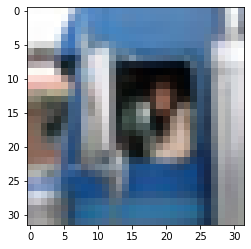

In [8]:
## take(n) : batch n개를 가져옵니다.
train_sample = train_dataset.take(1)

for sample in train_sample:
    print(sample['label'].shape)
    print(sample['image'].shape)
    print(sample['label'][0])
    plt.imshow(sample['image'][0])

## KID

* KID : Kernel Inception Distance
* MMD(Maximum Mean Discrepancy)를 feature space에서 진행하는 것을 의미
* 실제 이미지와 가짜 이미지, 가짜 이미지와 실제 이미지 세트간의 similarity를 보는 방법
* 실제 이미지 셋 p, 가짜 이미지셋 q라고 두고
* p에서 2장을 뽑고 두 이미지간의 차이를 구하는 것을 반복해서 이미지들간의 차이가 어떻게 되는지 기댓값을 구합니다.
* q에서도 똑같은 행동을 취합니다.
* 마지막으로 p에서 하나, q에서 하나를 뽑아서 평균적인 차이를 구합니다.

In [9]:
class KID(keras.metrics.Metric):
    def __init__(self, name, **kwargs):
        super().__init__(name=name, **kwargs)

        # KID 배치마다 계산되며 배치간의 값들로 평균을 냅니다.
        self.kid_tracker = keras.metrics.Mean(name="kid_tracker")

        # a pretrained InceptionV3 is used without its classification layer
        # transform the pixel values to the 0-255 range, then use the same
        # preprocessing as during pretraining
        self.encoder = keras.Sequential(
            [
                keras.Input(shape=(image_size, image_size, 3)),
                layers.Rescaling(255.0),
                layers.Resizing(height=kid_image_size, width=kid_image_size),
                layers.Lambda(keras.applications.inception_v3.preprocess_input),
                keras.applications.InceptionV3(
                    include_top=False,
                    input_shape=(kid_image_size, kid_image_size, 3),
                    weights="imagenet",
                ),
                layers.GlobalAveragePooling2D(),
            ],
            name="inception_encoder",
        )

    def polynomial_kernel(self, features_1, features_2):
        feature_dimensions = tf.cast(tf.shape(features_1)[1], dtype=tf.float32)
        return (features_1 @ tf.transpose(features_2) / feature_dimensions + 1.0) ** 3.0

    def update_state(self, real_images, generated_images, sample_weight=None):
        real_features = self.encoder(real_images, training=False)
        generated_features = self.encoder(generated_images, training=False)

        # compute polynomial kernels using the two sets of features
        kernel_real = self.polynomial_kernel(real_features, real_features)
        kernel_generated = self.polynomial_kernel(
            generated_features, generated_features
        )
        kernel_cross = self.polynomial_kernel(real_features, generated_features)

        # estimate the squared maximum mean discrepancy using the average kernel values
        batch_size = tf.shape(real_features)[0]
        batch_size_f = tf.cast(batch_size, dtype=tf.float32)
        mean_kernel_real = tf.reduce_sum(kernel_real * (1.0 - tf.eye(batch_size))) / (
            batch_size_f * (batch_size_f - 1.0)
        )
        mean_kernel_generated = tf.reduce_sum(
            kernel_generated * (1.0 - tf.eye(batch_size))
        ) / (batch_size_f * (batch_size_f - 1.0))
        mean_kernel_cross = tf.reduce_mean(kernel_cross)
        kid = mean_kernel_real + mean_kernel_generated - 2.0 * mean_kernel_cross

        # update the average KID estimate
        self.kid_tracker.update_state(kid)

    def result(self):
        return self.kid_tracker.result()

    def reset_state(self):
        self.kid_tracker.reset_state()


## 네트워크 구조

* U-Net 구조 : Input과 Output이 동일한 형태로
* Downsampling 한 뒤 Upsampling 하는 구조, layer들 간의 skip connectoins은 같은 resolutoin을 가진다.
* 네트워크는 noisy image와 noisy variances 2개의 값을 입력 받습니다.
* Noise variances는 노이즈 제거 과정이 다른 레벨의 노이즈에서 다른 명령(함수)가 필요하기 때문입니다.
* Noise variacnes는 sinusoidal embedding(positional embedding과 비슷한)을 통해 변환됩니다.
* 이 과정은 네트워크가 noise level에 매우 민감하게 만들어주며 이는 좋은 성능과 연결됩니다.
* Lambda layer를 통해 sinusoidal embedding을 구현하였습니다.

### Sinusoidal Embedding

In [10]:
def sinusoidal_embedding(x):
    embedding_min_frequency = 1.0
    frequencies = tf.exp(
        tf.linspace(
            tf.math.log(embedding_min_frequency),
            tf.math.log(embedding_max_frequency),
            embedding_dims // 2,
        )
    )
    angular_speeds = 2.0 * math.pi * frequencies
    embeddings = tf.concat(
        [tf.sin(angular_speeds * x), tf.cos(angular_speeds * x)], axis=3
    )
    return embeddings

### Residual Block

In [11]:
def ResidualBlock(width):
    def apply(x):
        input_width = x.shape[3]
        if input_width == width:
            residual = x
        else:
            residual = layers.Conv2D(width, kernel_size=1)(x)
        x = layers.BatchNormalization(center=False, scale=False)(x)
        x = layers.Conv2D(
            width, kernel_size=3, padding="same", activation=keras.activations.swish
        )(x)
        x = layers.Conv2D(width, kernel_size=3, padding="same")(x)
        x = layers.Add()([x, residual])
        return x

    return apply

### Up Down Block

In [12]:
def DownBlock(width, block_depth):
    def apply(x):
        x, skips = x
        for _ in range(block_depth):
            x = ResidualBlock(width)(x)
            skips.append(x)
        x = layers.AveragePooling2D(pool_size=2)(x)
        return x

    return apply


def UpBlock(width, block_depth):
    def apply(x):
        x, skips = x
        x = layers.UpSampling2D(size=2, interpolation="bilinear")(x)
        for _ in range(block_depth):
            x = layers.Concatenate()([x, skips.pop()])
            x = ResidualBlock(width)(x)
        return x

    return apply

## Get Network

### Before

In [13]:
# def get_network_before(image_size, widths, block_depth):
#     noisy_images = keras.Input(shape=(image_size, image_size, 3))
#     noise_variances = keras.Input(shape=(1, 1, 1))

#     e = layers.Lambda(sinusoidal_embedding)(noise_variances)
#     e = layers.UpSampling2D(size=image_size, interpolation="nearest")(e)

#     x = layers.Conv2D(widths[0], kernel_size=1)(noisy_images)
#     x = layers.Concatenate()([x, e])

#     skips = []
#     for width in widths[:-1]:
#         x = DownBlock(width, block_depth)([x, skips])

#     for _ in range(block_depth):
#         x = ResidualBlock(widths[-1])(x)

#     for width in reversed(widths[:-1]):
#         x = UpBlock(width, block_depth)([x, skips])

#     x = layers.Conv2D(3, kernel_size=1, kernel_initializer="zeros")(x)

#     return keras.Model([noisy_images, noise_variances], x, name="residual_unet")


### After

In [14]:
def get_network(image_size, widths, num_class, block_depth):
    noisy_images = keras.Input(shape=(image_size, image_size, 3))
    noise_variances = keras.Input(shape=(1, 1, 1))
    class_vector = keras.Input(shape = (num_class,))
    
    e = layers.Lambda(sinusoidal_embedding)(noise_variances)
#     print('e :', e)
    e = layers.UpSampling2D(size=image_size, interpolation="nearest")(e)
#     print('e :',e)
    
    i = layers.Dense(class_embedding_dims)(class_vector)
#     print('i :',i)
#     i = layers.Reshape((1,1,class_embedding_dims))(i)
    i = i[:,None,None,:]
#     print('i :',i)
    i = layers.UpSampling2D(size=image_size, interpolation="nearest")(i)
#     print('i :',i)
    
    x = layers.Conv2D(widths[0], kernel_size=1)(noisy_images)
    x = layers.Concatenate()([x, i, e])
#     print('x', x)

    # widths = [32, 64, 96, 128]
    skips = []
    for width in widths[:-1]:
        x = DownBlock(width, block_depth)([x, skips])

    for _ in range(block_depth):
        x = ResidualBlock(widths[-1])(x)

    for width in reversed(widths[:-1]):
        x = UpBlock(width, block_depth)([x, skips])

    x = layers.Conv2D(3, kernel_size=1, kernel_initializer="zeros")(x)
#     x = layers.Conv2D(1, kernel_size=1, kernel_initializer="zeros")(x)
    

    return keras.Model([noisy_images, noise_variances, class_vector], x, name="residual_unet")

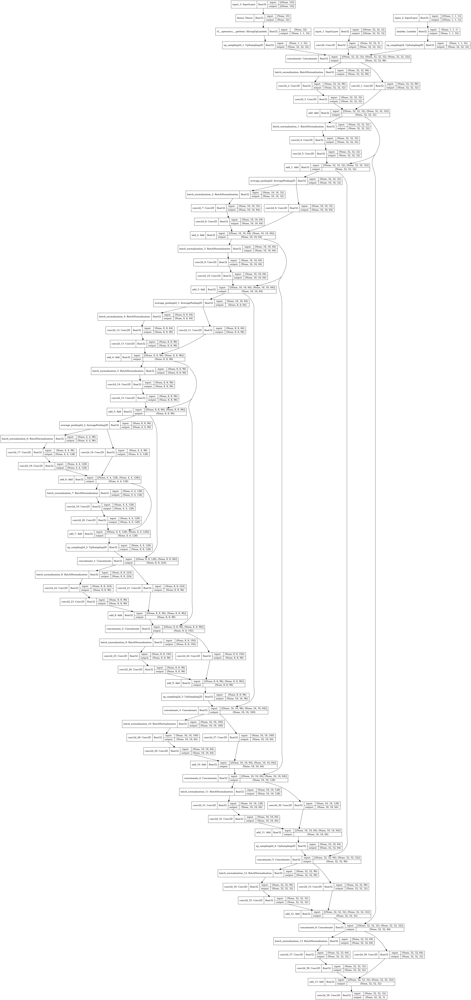

In [15]:
from tensorflow.keras.utils import plot_model

sample_network = get_network(image_size, widths, num_class, block_depth)

plot_model(sample_network, to_file = 'model.png', show_shapes = True, show_dtype = True, show_layer_names = True)


## Diffusion model

### Diffusion Schedule

* Diffusion process의 각 위치에서의 실제 diffusion time에 대응하는 noise level과 signal level를 말해주는 함수가 필요하다.
* 이것이 diffusion schedule 이다.
* Diffusion schedule은 2가지 값을 출력한다.
* noise_rate와 signal_rate(DDPM 논문에서 sqrt(1-alpha)와 sqrt(alpha)에 해당하는)
* 노이즈 이미지는 훈련 이미지에 정해진 비율에 따라 랜덤 노이즈를 부가하고 둘을 합치면서 생성한다.
* 랜덤 노이즈와 이미지가 모두 평균을 0으로 잡고 unit 분산을 가지기 때문에 노이즈 비율과 신호 비율은 노이즈 이미지에서 그들의 표준편차로 볼 수 있다.
* 그들 비율의 제곱은 결국 분산이 된다.
* 비율들은 제곱 합이 1이 되도록 설정되며, 이는 노이즈 이미지가 언제나 unit 분산을 가지는 것을 뜻합니다(변화되지않은 값들 처럼)
* 우린 cosine schedule의 simplifed, continuous 버전을 사용합니다.
* 이 스케쥴은 대칭적이며 Diffusion 시작과 끝을 향해선 느려지며, trigonometric properties of the unit circle을 통한 기하하적 해석을 가집니다.

### Training Process

* train 과정은 train_step과 denoise 이며
* 무작위 diffusion 시간을 균등하게 샘플하며
* 훈련 이미지와 무작위 가우시안 노이즈를 diffusion 시간에 따른 비율에 따라 섞습니다.
* 그리고 노이즈 이미지를 두 가지 요소로 나누기 위해 모델을 훈련합니다.
* 뉴런 네트워크는 변하지 않은 노이즈 요소를 예측하기 위해 학습되며 예측한 이미지 요소는 신호와 노이즈 비율에 따라 계산될 수 있습니다.
* 픽셀 단위의 MSE가 이론적으로 사용되나, 해당 dataset에서는 MAE가 더 좋게 나오니 이것을 사용하겠습니다.

### Sampling

* 샘플링에서는 (reverse diffusion()에서), 각 단계에서 노이즈 이미지의 이전 예측값을 우리의 네트워크를 사용해서 노이즈와 이미지로 나눕니다.
* 해당 단계에서의 신호와 노이즈 비율을 사용하여 다시 재결합합니다.
* Stochastic sampling 네트워크를 재훈련하지 않고도 사용할 수 있다(두 모델 다 같은 방식으로 훈련하기 때문)

In [16]:
class DiffusionModel(keras.Model):
    def __init__(self, image_size, widths, num_class, block_depth):
        super().__init__()

        self.normalizer = layers.Normalization()
        self.network = get_network(image_size, widths, num_class, block_depth)
        self.ema_network = keras.models.clone_model(self.network)

    def compile(self, **kwargs):
        super().compile(**kwargs)

        self.noise_loss_tracker = keras.metrics.Mean(name="n_loss")
        self.image_loss_tracker = keras.metrics.Mean(name="i_loss")
        self.kid = KID(name="kid")

    @property
    def metrics(self):
        return [self.noise_loss_tracker, self.image_loss_tracker, self.kid]

    def denormalize(self, images):
        # convert the pixel values back to 0-1 range
        images = self.normalizer.mean + images * self.normalizer.variance**0.5
        return tf.clip_by_value(images, 0.0, 1.0)

    def diffusion_schedule(self, diffusion_times):
        # diffusion times -> angles
        start_angle = tf.acos(max_signal_rate)
        end_angle = tf.acos(min_signal_rate)

        diffusion_angles = start_angle + diffusion_times * (end_angle - start_angle)

        # angles -> signal and noise rates
        signal_rates = tf.cos(diffusion_angles)
        noise_rates = tf.sin(diffusion_angles)
        # note that their squared sum is always: sin^2(x) + cos^2(x) = 1

        return noise_rates, signal_rates

    def denoise(self, noisy_images, noise_rates, signal_rates, class_vector, training):
        # print("denoise start")
        # the exponential moving average weights are used at evaluation
        if training:
            network = self.network
        else:
            network = self.ema_network

        # predict noise component and calculate the image component using it
        # pred_noises = network([noisy_images, noise_rates**2], training=training)
        pred_noises = network([noisy_images, noise_rates**2, class_vector], training=training)
        # print("denoise get noises")
    
        pred_images = (noisy_images - noise_rates * pred_noises) / signal_rates
        # print("denoise get images") 
        
        return pred_noises, pred_images

    def reverse_diffusion(self, initial_noise, diffusion_steps, class_vector):
        # reverse diffusion = sampling
        num_images = initial_noise.shape[0]
        step_size = 1.0 / diffusion_steps

        # important line:
        # at the first sampling step, the "noisy image" is pure noise
        # but its signal rate is assumed to be nonzero (min_signal_rate)
        next_noisy_images = initial_noise
        for step in range(diffusion_steps):
            noisy_images = next_noisy_images

            # separate the current noisy image to its components
            diffusion_times = tf.ones((num_images, 1, 1, 1)) - step * step_size
            noise_rates, signal_rates = self.diffusion_schedule(diffusion_times)
            pred_noises, pred_images = self.denoise(
                noisy_images, noise_rates, signal_rates, class_vector, training=False
            )
            # network used in eval mode

            # remix the predicted components using the next signal and noise rates
            next_diffusion_times = diffusion_times - step_size
            next_noise_rates, next_signal_rates = self.diffusion_schedule(
                next_diffusion_times
            )
            next_noisy_images = (
                next_signal_rates * pred_images + next_noise_rates * pred_noises
            )
            # this new noisy image will be used in the next step

        return pred_images

    def generate(self, num_images, diffusion_steps, class_vector):
        # noise -> images -> denormalized images
        initial_noise = tf.random.normal(shape=(num_images, image_size, image_size, 3))
        generated_images = self.reverse_diffusion(initial_noise, diffusion_steps, class_vector)
        generated_images = self.denormalize(generated_images)
        return generated_images

    # def train_step(self, images):
    def train_step(self, data):
        # normalize images to have standard deviation of 1, like the noises
        # print("train_step start")
        images = data['image']
        label = data['label']
        # print(label)
        images = self.normalizer(images, training=True)
        noises = tf.random.normal(shape=(batch_size, image_size, image_size, 3))

        # sample uniform random diffusion times
        diffusion_times = tf.random.uniform(
            shape=(batch_size, 1, 1, 1), minval=0.0, maxval=1.0
        )
        noise_rates, signal_rates = self.diffusion_schedule(diffusion_times)
        # mix the images with noises accordingly
        noisy_images = signal_rates * images + noise_rates * noises

        # print("train_step here 1")
        # print("noise_rates :", noise_rates)
        # print("signal_rates :", signal_rates)
        # print("noisy_images :", noisy_images)
        
        with tf.GradientTape() as tape:
            # train the network to separate noisy images to their components
            pred_noises, pred_images = self.denoise(
                noisy_images, noise_rates, signal_rates, label, training=True
            )
            # print('start get loss')
            noise_loss = self.loss(noises, pred_noises)  # used for training
            # print('get noise loss')
            image_loss = self.loss(images, pred_images)  # only used as metric
            # print('get image loss')
            
            
        # print("train_step here 2")
        gradients = tape.gradient(noise_loss, self.network.trainable_weights)
        self.optimizer.apply_gradients(zip(gradients, self.network.trainable_weights))

        self.noise_loss_tracker.update_state(noise_loss)
        self.image_loss_tracker.update_state(image_loss)

        # track the exponential moving averages of weights
        for weight, ema_weight in zip(self.network.weights, self.ema_network.weights):
            ema_weight.assign(ema * ema_weight + (1 - ema) * weight)
    
        # KID is not measured during the training phase for computational efficiency
        return {m.name: m.result() for m in self.metrics[:-1]}

    # def test_step(self, images):
    def test_step(self, data):
        images = data['image']
        label = data['label']
        # normalize images to have standard deviation of 1, like the noises
        images = self.normalizer(images, training=False)
        noises = tf.random.normal(shape=(batch_size, image_size, image_size, 3))

        # sample uniform random diffusion times
        diffusion_times = tf.random.uniform(
            shape=(batch_size, 1, 1, 1), minval=0.0, maxval=1.0
        )
        noise_rates, signal_rates = self.diffusion_schedule(diffusion_times)
        # mix the images with noises accordingly
        noisy_images = signal_rates * images + noise_rates * noises

        # use the network to separate noisy images to their components
        pred_noises, pred_images = self.denoise(
            noisy_images, noise_rates, signal_rates, label, training=False
        )

        noise_loss = self.loss(noises, pred_noises)
        image_loss = self.loss(images, pred_images)

        self.image_loss_tracker.update_state(image_loss)
        self.noise_loss_tracker.update_state(noise_loss)

        # measure KID between real and generated images
        # this is computationally demanding, kid_diffusion_steps has to be small
        images = self.denormalize(images)
        generated_images = self.generate(
            num_images=batch_size, diffusion_steps=kid_diffusion_steps, class_vector = label
        )
        self.kid.update_state(images, generated_images)

        return {m.name: m.result() for m in self.metrics}

    # plot random generated images for visual evaluation of generation quality
    def plot_images(self, epoch=None, logs=None, num_rows=2, num_cols=5):
    # def plot_images(self, epoch=None, logs=None, num_rows=1, num_cols=5):
        
        indices = [0,1,2,3,4,5,6,7,8,9]
        # indices = [0,1,2,3,4]
        sample_vector = tf.one_hot(indices, num_class)
        # sample_vector shape (10,10)
        generated_images = self.generate(
            num_images=num_rows * num_cols,
            diffusion_steps=plot_diffusion_steps,
            class_vector =  sample_vector 
        )
        # generated_images shape : (10,32,32,3)

        plt.figure(figsize=(num_cols * 2.0, num_rows * 2.0))
        for row in range(num_rows):
            for col in range(num_cols):
                index = row * num_cols + col
                plt.subplot(num_rows, num_cols, index + 1)
                plt.imshow(generated_images[index])
                plt.axis("off")
        plt.tight_layout()
        plt.show()
        plt.close()
        
    def plot_one_images(self, input_class = 0, epoch=None, logs=None):
        
        index = [input_class]
        sample_vector = tf.one_hot(index, num_class)
        # sample_vector shape : (1,10)
            
        generated_images = self.generate(
            num_images=1,
            diffusion_steps = one_plot_diffusion_steps,
            class_vector =  sample_vector 
        )
        # generated_images shape : (1,32,32,3)
        
        plt.figure(figsize=(6,6))
        plt.imshow(generated_images[0])
        plt.axis("off")
        plt.tight_layout()
        plt.show()
        plt.close()
    

## 학습

In [17]:
!pip install tensorflow_addons

In [18]:
import tensorflow_addons as tfa

# create and compile the model
model = DiffusionModel(image_size, widths, num_class, block_depth)
# below tensorflow 2.9:
# pip install tensorflow_addons
# import tensorflow_addons as tfa
# optimizer=tfa.optimizers.AdamW
model.compile(
    optimizer=tfa.optimizers.AdamW(
#     optimizer=keras.optimizers.experimental.AdamW(
        learning_rate=learning_rate, weight_decay=weight_decay
    ),
    loss=keras.losses.MeanSquaredError(),
)
# pixelwise mean absolute error is used as loss

87924736/87910968 [==============================] - 1s 0us/step


In [19]:
# save the best model based on the validation KID metric
checkpoint_path = "checkpoint/diffusion_model"

checkpoint_callback = tf.keras.callbacks.ModelCheckpoint(
    filepath=checkpoint_path,
    save_weights_only=True,
    monitor="val_kid",
    mode="min",
    save_best_only=True,
)

In [20]:
# calculate mean and variance of training dataset for normalization
# 이미지와 label로 데이터셋의 형태가 변하였기 때문에 image만 가져와서 adapt 시켜줍니다.
train_image = train_dataset.map(lambda x : x['image'])
model.normalizer.adapt(train_image)

Epoch 1/500
703/703 [==============================] - 96s 75ms/step - n_loss: 0.0974 - i_loss: 1.3231 - val_n_loss: 0.9486 - val_i_loss: 31.6930 - val_kid: 0.8860


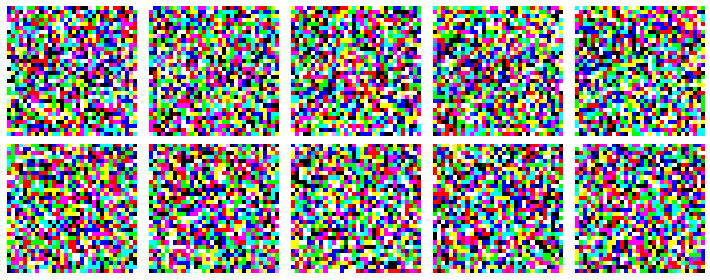

Epoch 2/500
703/703 [==============================] - 46s 66ms/step - n_loss: 0.0640 - i_loss: 0.2952 - val_n_loss: 0.6480 - val_i_loss: 23.1515 - val_kid: 0.8409


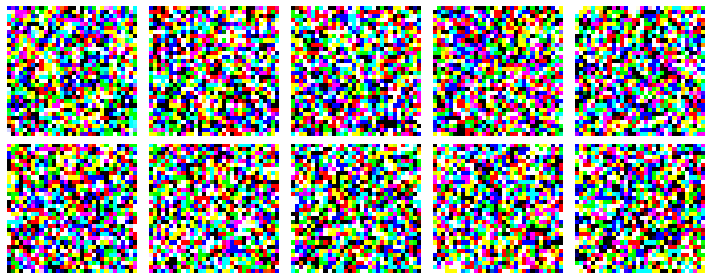

Epoch 3/500
703/703 [==============================] - 48s 68ms/step - n_loss: 0.0612 - i_loss: 0.2703 - val_n_loss: 0.3291 - val_i_loss: 9.7134 - val_kid: 0.8446


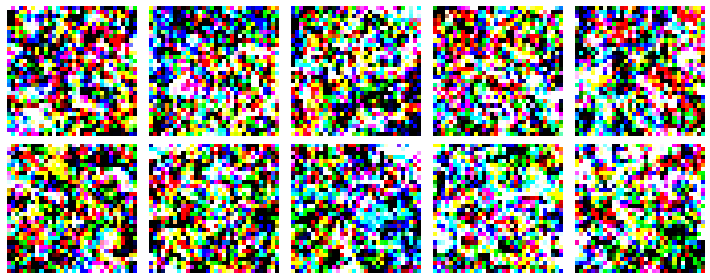

Epoch 4/500
703/703 [==============================] - 47s 68ms/step - n_loss: 0.0598 - i_loss: 0.2590 - val_n_loss: 0.1575 - val_i_loss: 3.5151 - val_kid: 0.9131


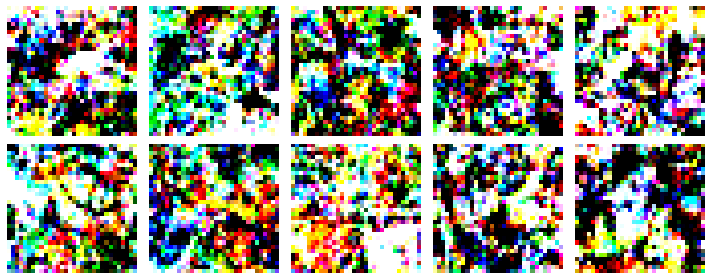

Epoch 5/500
703/703 [==============================] - 47s 68ms/step - n_loss: 0.0592 - i_loss: 0.2398 - val_n_loss: 0.0899 - val_i_loss: 1.2017 - val_kid: 0.7613


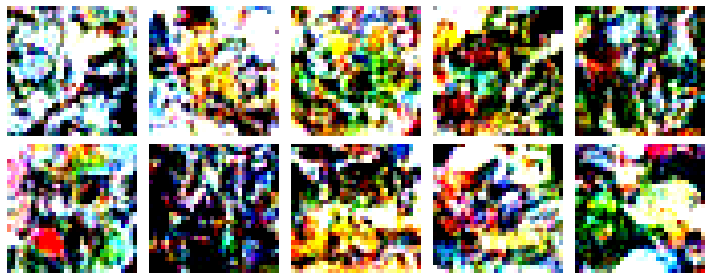

Epoch 6/500
703/703 [==============================] - 48s 68ms/step - n_loss: 0.0581 - i_loss: 0.2375 - val_n_loss: 0.0667 - val_i_loss: 0.4573 - val_kid: 0.5308


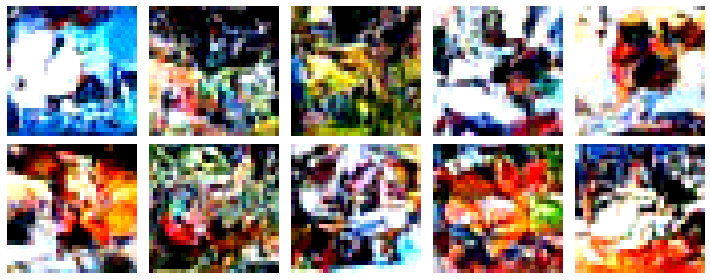

Epoch 7/500
703/703 [==============================] - 47s 68ms/step - n_loss: 0.0584 - i_loss: 0.2362 - val_n_loss: 0.0589 - val_i_loss: 0.2796 - val_kid: 0.3863


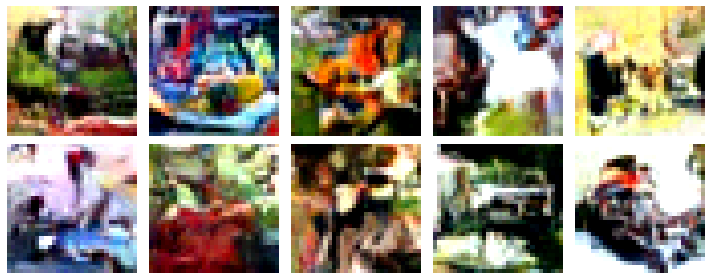

Epoch 8/500
703/703 [==============================] - 48s 68ms/step - n_loss: 0.0579 - i_loss: 0.2283 - val_n_loss: 0.0557 - val_i_loss: 0.1995 - val_kid: 0.2480


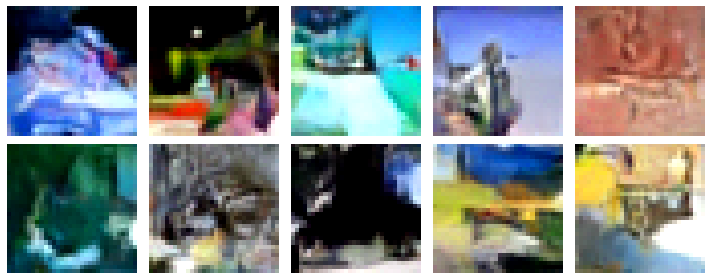

Epoch 9/500
703/703 [==============================] - 48s 68ms/step - n_loss: 0.0574 - i_loss: 0.2261 - val_n_loss: 0.0557 - val_i_loss: 0.1818 - val_kid: 0.1741


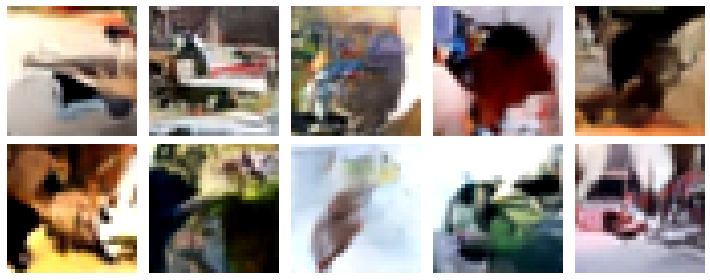

Epoch 10/500
703/703 [==============================] - 48s 68ms/step - n_loss: 0.0573 - i_loss: 0.2203 - val_n_loss: 0.0552 - val_i_loss: 0.1724 - val_kid: 0.1518


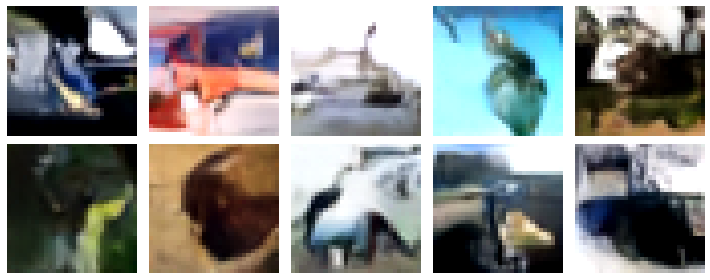

Epoch 11/500
703/703 [==============================] - 48s 68ms/step - n_loss: 0.0569 - i_loss: 0.2233 - val_n_loss: 0.0539 - val_i_loss: 0.1722 - val_kid: 0.1418


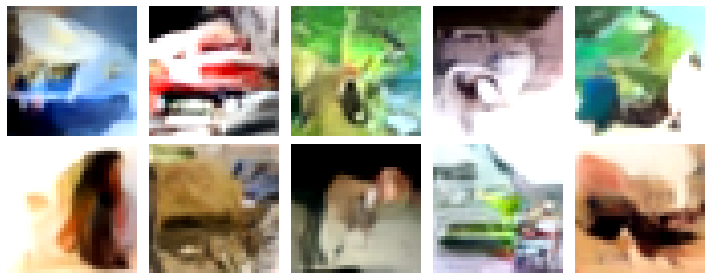

Epoch 12/500
703/703 [==============================] - 48s 68ms/step - n_loss: 0.0569 - i_loss: 0.2188 - val_n_loss: 0.0539 - val_i_loss: 0.1658 - val_kid: 0.1318


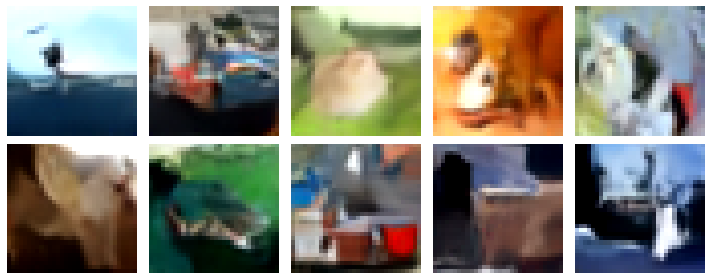

Epoch 13/500
703/703 [==============================] - 48s 68ms/step - n_loss: 0.0567 - i_loss: 0.2195 - val_n_loss: 0.0538 - val_i_loss: 0.1656 - val_kid: 0.1388


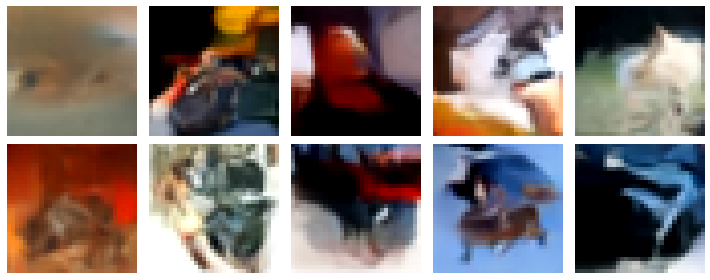

Epoch 14/500
703/703 [==============================] - 48s 68ms/step - n_loss: 0.0561 - i_loss: 0.2192 - val_n_loss: 0.0530 - val_i_loss: 0.1623 - val_kid: 0.1425


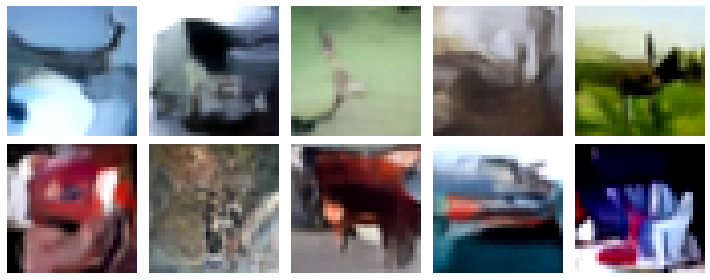

Epoch 15/500
703/703 [==============================] - 47s 68ms/step - n_loss: 0.0564 - i_loss: 0.2144 - val_n_loss: 0.0551 - val_i_loss: 0.1626 - val_kid: 0.1367


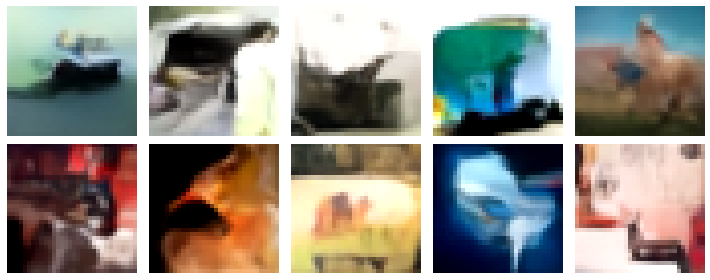

Epoch 16/500
703/703 [==============================] - 48s 68ms/step - n_loss: 0.0560 - i_loss: 0.2125 - val_n_loss: 0.0538 - val_i_loss: 0.1605 - val_kid: 0.1403


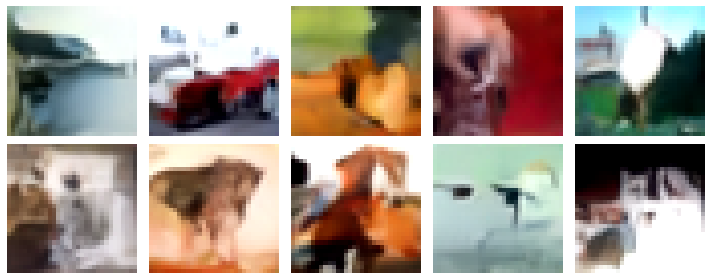

Epoch 17/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0559 - i_loss: 0.2133 - val_n_loss: 0.0534 - val_i_loss: 0.1615 - val_kid: 0.1345


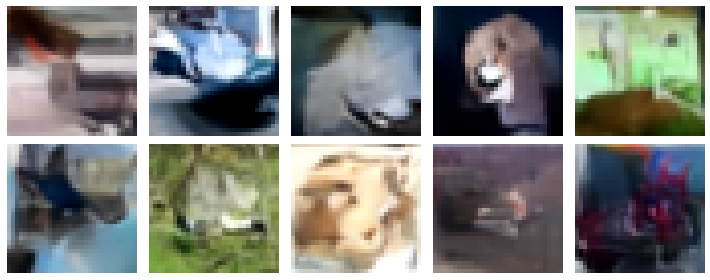

Epoch 18/500
703/703 [==============================] - 47s 68ms/step - n_loss: 0.0564 - i_loss: 0.2111 - val_n_loss: 0.0533 - val_i_loss: 0.1657 - val_kid: 0.1326


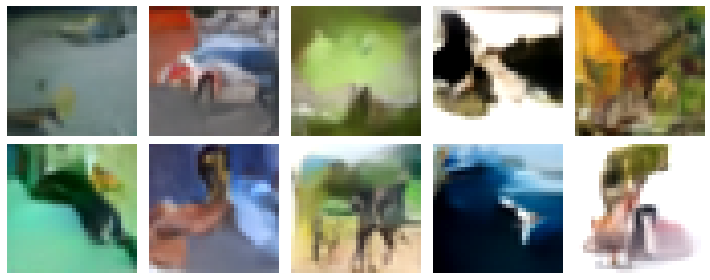

Epoch 19/500
703/703 [==============================] - 48s 68ms/step - n_loss: 0.0557 - i_loss: 0.2078 - val_n_loss: 0.0535 - val_i_loss: 0.1594 - val_kid: 0.1374


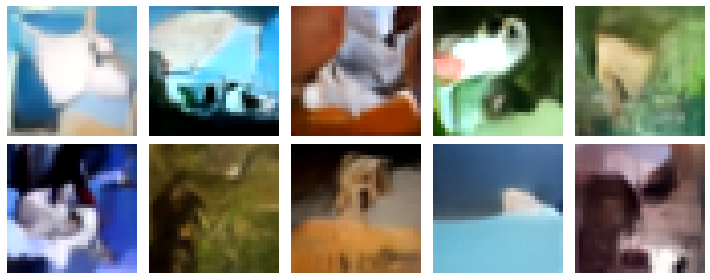

Epoch 20/500
703/703 [==============================] - 48s 68ms/step - n_loss: 0.0556 - i_loss: 0.2140 - val_n_loss: 0.0528 - val_i_loss: 0.1636 - val_kid: 0.1342


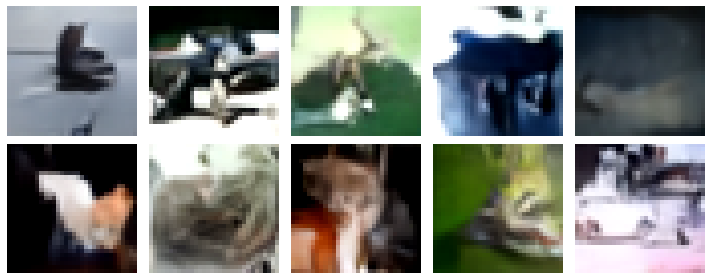

Epoch 21/500
703/703 [==============================] - 48s 68ms/step - n_loss: 0.0557 - i_loss: 0.2110 - val_n_loss: 0.0531 - val_i_loss: 0.1611 - val_kid: 0.1398


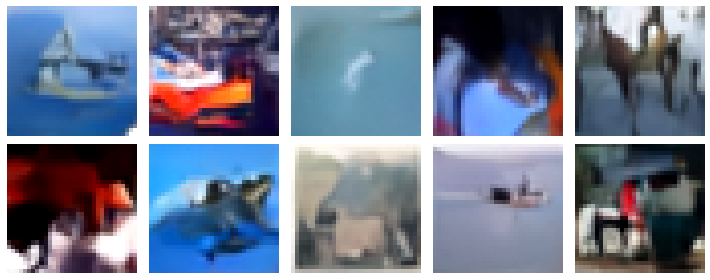

Epoch 22/500
703/703 [==============================] - 48s 68ms/step - n_loss: 0.0554 - i_loss: 0.2062 - val_n_loss: 0.0534 - val_i_loss: 0.1582 - val_kid: 0.1309


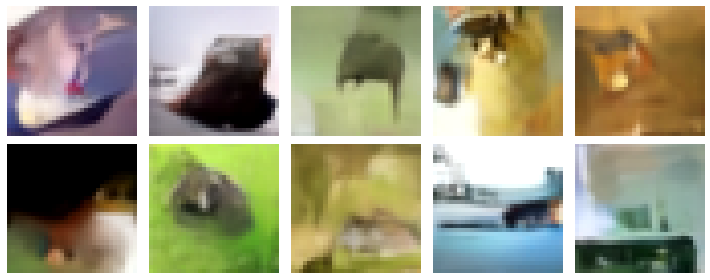

Epoch 23/500
703/703 [==============================] - 48s 68ms/step - n_loss: 0.0555 - i_loss: 0.2123 - val_n_loss: 0.0530 - val_i_loss: 0.1628 - val_kid: 0.1378


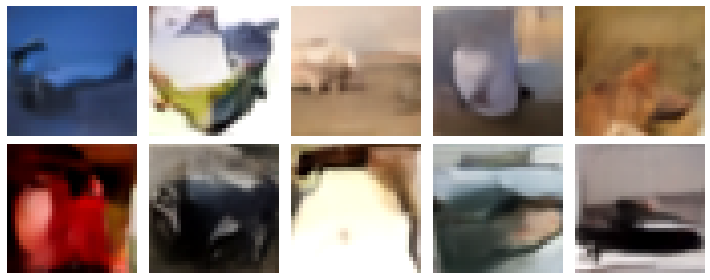

Epoch 24/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0556 - i_loss: 0.2119 - val_n_loss: 0.0529 - val_i_loss: 0.1619 - val_kid: 0.1311


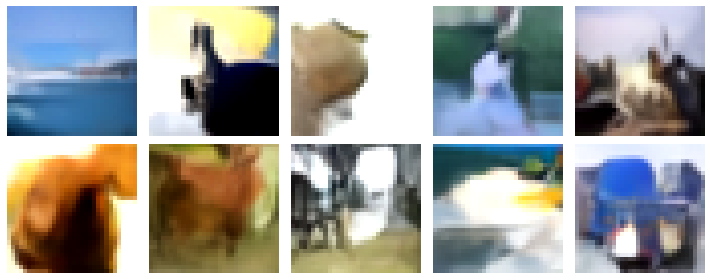

Epoch 25/500
703/703 [==============================] - 47s 68ms/step - n_loss: 0.0557 - i_loss: 0.2080 - val_n_loss: 0.0537 - val_i_loss: 0.1603 - val_kid: 0.1375


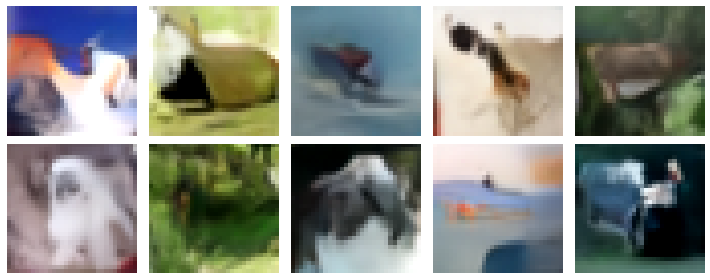

Epoch 26/500
703/703 [==============================] - 47s 68ms/step - n_loss: 0.0551 - i_loss: 0.2078 - val_n_loss: 0.0523 - val_i_loss: 0.1630 - val_kid: 0.1334


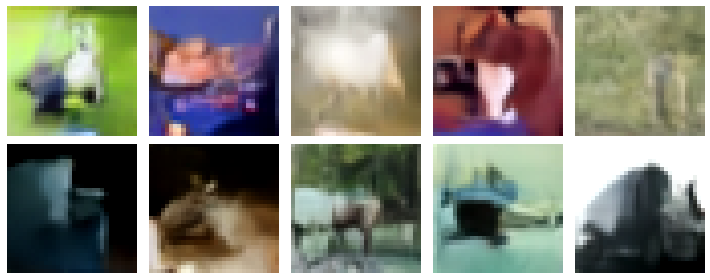

Epoch 27/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0554 - i_loss: 0.2076 - val_n_loss: 0.0532 - val_i_loss: 0.1596 - val_kid: 0.1378


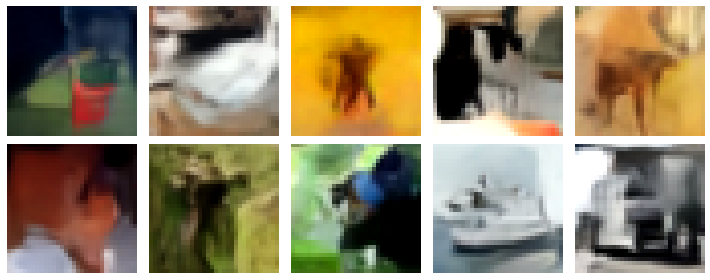

Epoch 28/500
703/703 [==============================] - 47s 68ms/step - n_loss: 0.0555 - i_loss: 0.2054 - val_n_loss: 0.0535 - val_i_loss: 0.1535 - val_kid: 0.1335


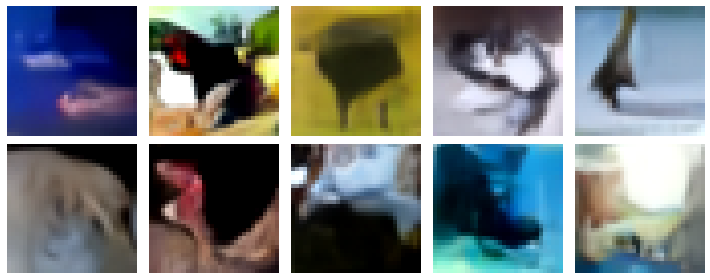

Epoch 29/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0552 - i_loss: 0.2079 - val_n_loss: 0.0523 - val_i_loss: 0.1548 - val_kid: 0.1329


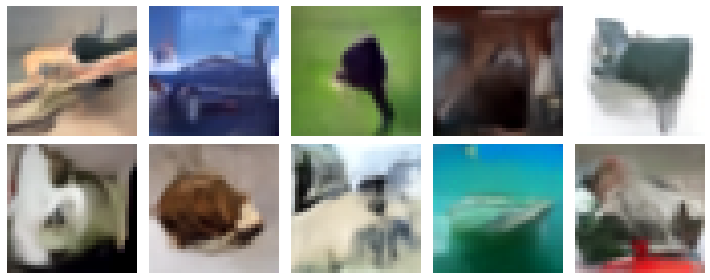

Epoch 30/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0555 - i_loss: 0.2070 - val_n_loss: 0.0523 - val_i_loss: 0.1547 - val_kid: 0.1356


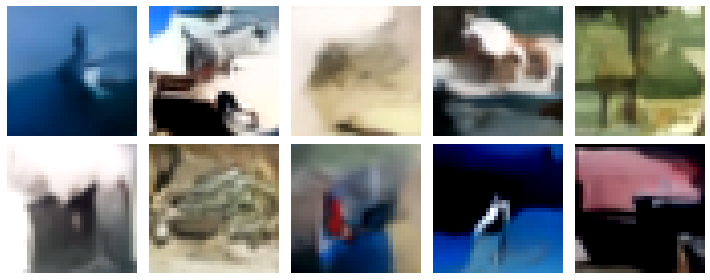

Epoch 31/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0549 - i_loss: 0.2049 - val_n_loss: 0.0527 - val_i_loss: 0.1575 - val_kid: 0.1223


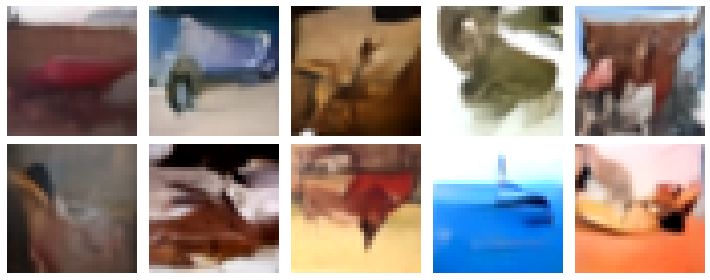

Epoch 32/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0550 - i_loss: 0.2062 - val_n_loss: 0.0534 - val_i_loss: 0.1575 - val_kid: 0.1306


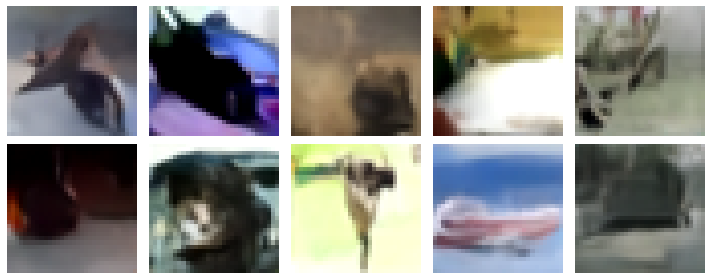

Epoch 33/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0551 - i_loss: 0.2069 - val_n_loss: 0.0529 - val_i_loss: 0.1548 - val_kid: 0.1433


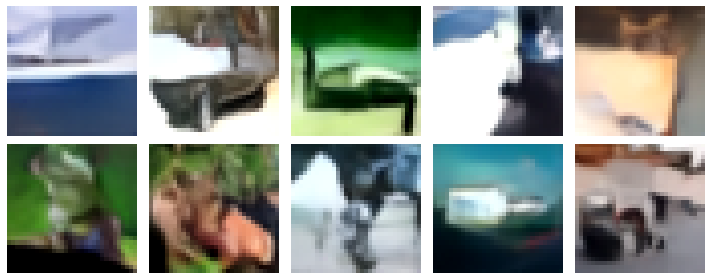

Epoch 34/500
703/703 [==============================] - 47s 68ms/step - n_loss: 0.0550 - i_loss: 0.2073 - val_n_loss: 0.0520 - val_i_loss: 0.1620 - val_kid: 0.1369


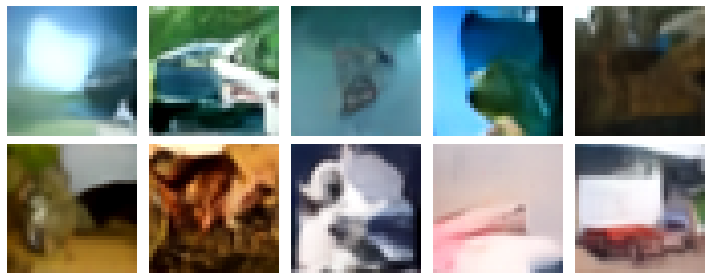

Epoch 35/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0553 - i_loss: 0.2078 - val_n_loss: 0.0536 - val_i_loss: 0.1543 - val_kid: 0.1257


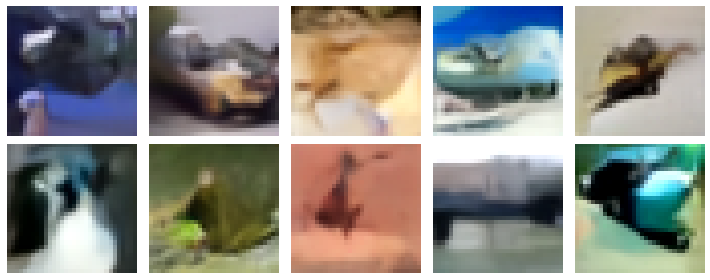

Epoch 36/500
703/703 [==============================] - 48s 68ms/step - n_loss: 0.0552 - i_loss: 0.2060 - val_n_loss: 0.0526 - val_i_loss: 0.1577 - val_kid: 0.1310


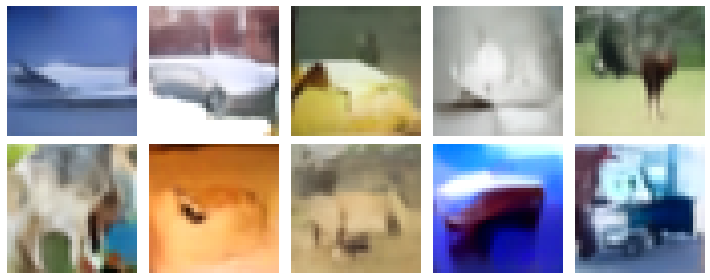

Epoch 37/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0552 - i_loss: 0.2049 - val_n_loss: 0.0521 - val_i_loss: 0.1611 - val_kid: 0.1299


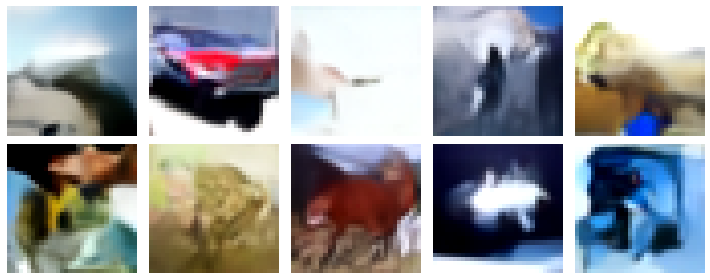

Epoch 38/500
703/703 [==============================] - 47s 68ms/step - n_loss: 0.0547 - i_loss: 0.2082 - val_n_loss: 0.0532 - val_i_loss: 0.1569 - val_kid: 0.1362


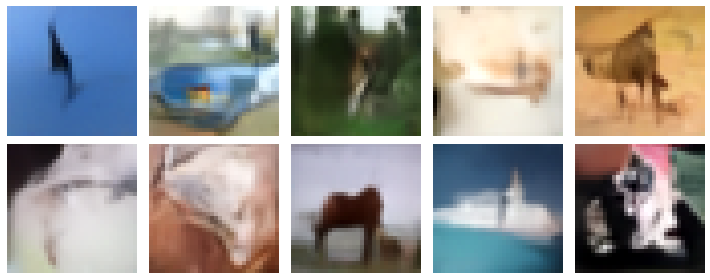

Epoch 39/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0551 - i_loss: 0.2055 - val_n_loss: 0.0514 - val_i_loss: 0.1626 - val_kid: 0.1256


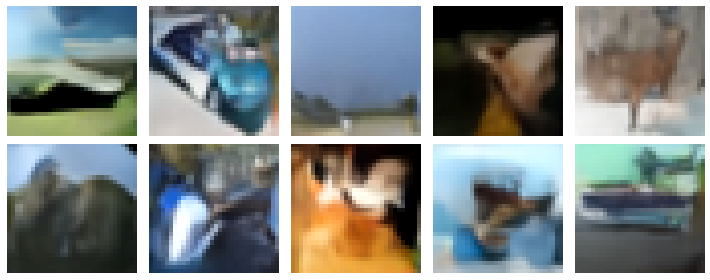

Epoch 40/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0549 - i_loss: 0.2028 - val_n_loss: 0.0533 - val_i_loss: 0.1531 - val_kid: 0.1440


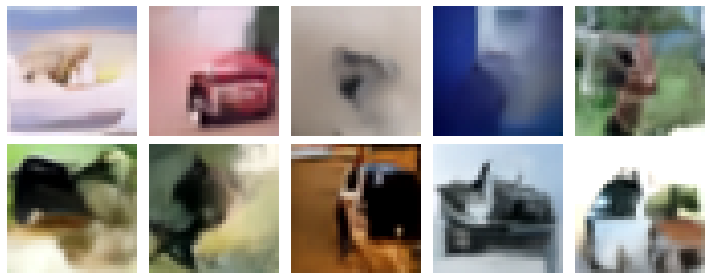

Epoch 41/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0553 - i_loss: 0.2044 - val_n_loss: 0.0531 - val_i_loss: 0.1504 - val_kid: 0.1480


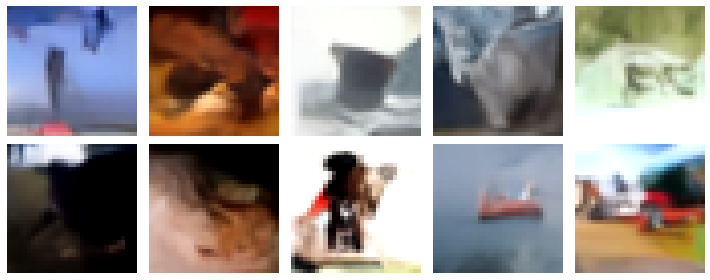

Epoch 42/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0549 - i_loss: 0.2052 - val_n_loss: 0.0535 - val_i_loss: 0.1579 - val_kid: 0.1344


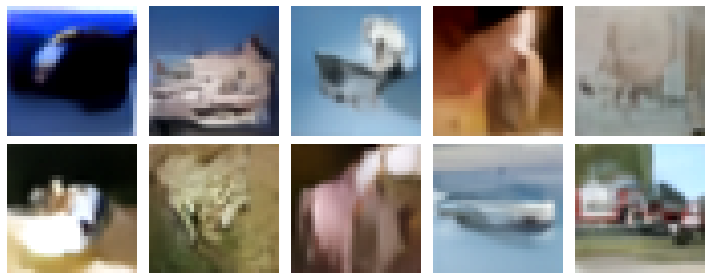

Epoch 43/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0548 - i_loss: 0.2049 - val_n_loss: 0.0518 - val_i_loss: 0.1578 - val_kid: 0.1371


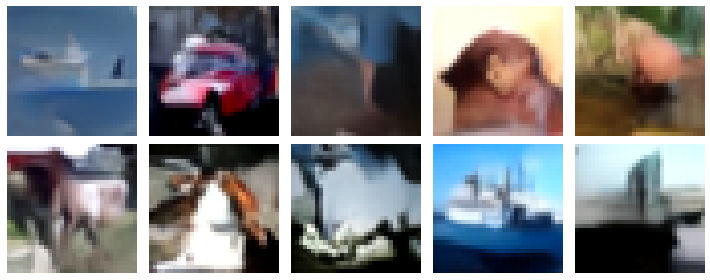

Epoch 44/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0547 - i_loss: 0.2033 - val_n_loss: 0.0532 - val_i_loss: 0.1559 - val_kid: 0.1437


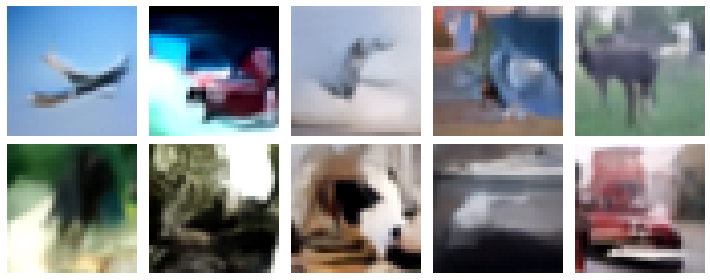

Epoch 45/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0548 - i_loss: 0.2029 - val_n_loss: 0.0532 - val_i_loss: 0.1549 - val_kid: 0.1460


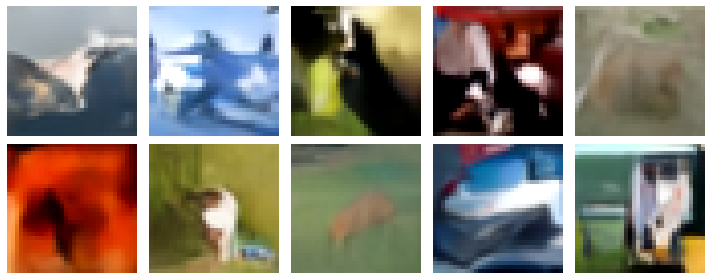

Epoch 46/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0549 - i_loss: 0.2060 - val_n_loss: 0.0516 - val_i_loss: 0.1605 - val_kid: 0.1428


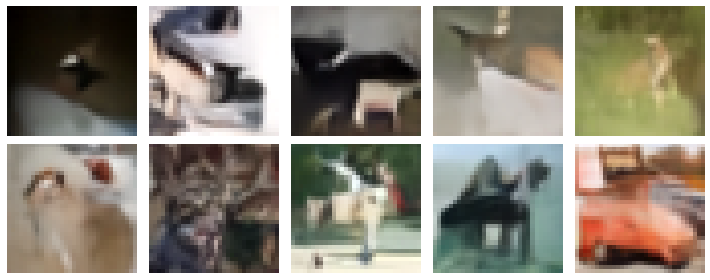

Epoch 47/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0548 - i_loss: 0.2032 - val_n_loss: 0.0523 - val_i_loss: 0.1554 - val_kid: 0.1431


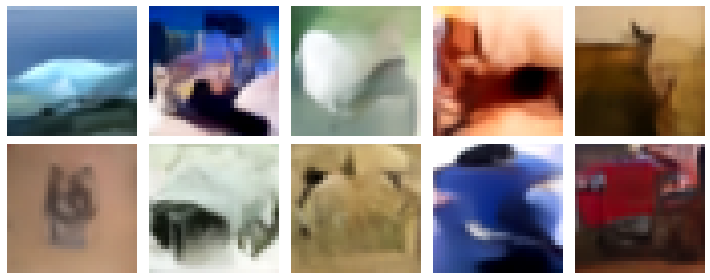

Epoch 48/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0545 - i_loss: 0.2066 - val_n_loss: 0.0521 - val_i_loss: 0.1567 - val_kid: 0.1488


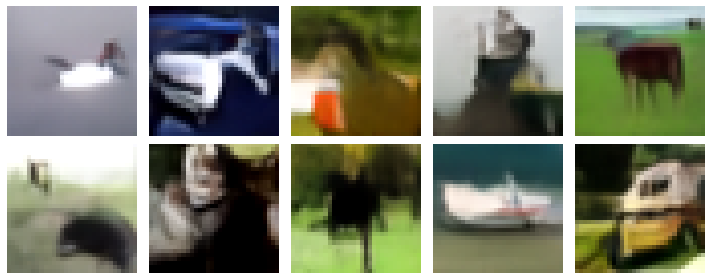

Epoch 49/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0551 - i_loss: 0.2047 - val_n_loss: 0.0518 - val_i_loss: 0.1570 - val_kid: 0.1424


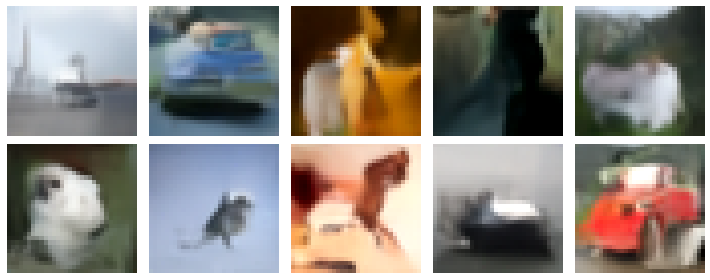

Epoch 50/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0543 - i_loss: 0.2051 - val_n_loss: 0.0529 - val_i_loss: 0.1573 - val_kid: 0.1429


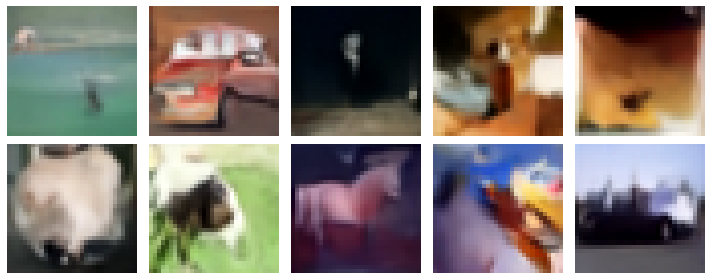

Epoch 51/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0547 - i_loss: 0.2050 - val_n_loss: 0.0533 - val_i_loss: 0.1517 - val_kid: 0.1479


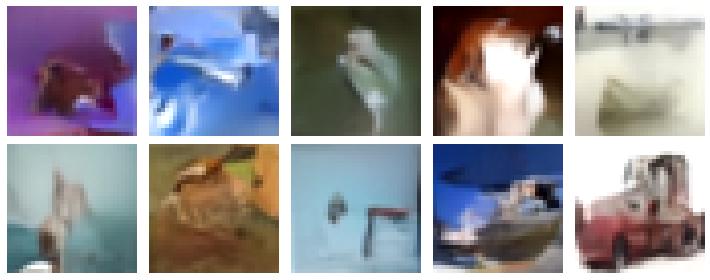

Epoch 52/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0546 - i_loss: 0.2034 - val_n_loss: 0.0526 - val_i_loss: 0.1572 - val_kid: 0.1535


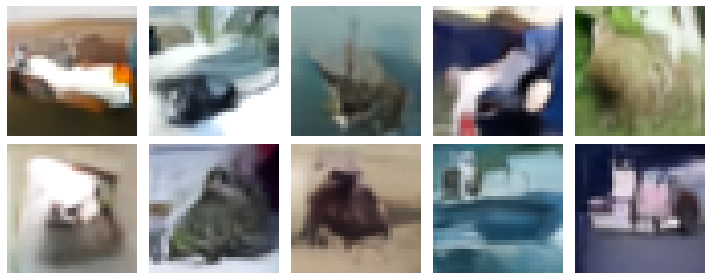

Epoch 53/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0548 - i_loss: 0.2045 - val_n_loss: 0.0518 - val_i_loss: 0.1603 - val_kid: 0.1331


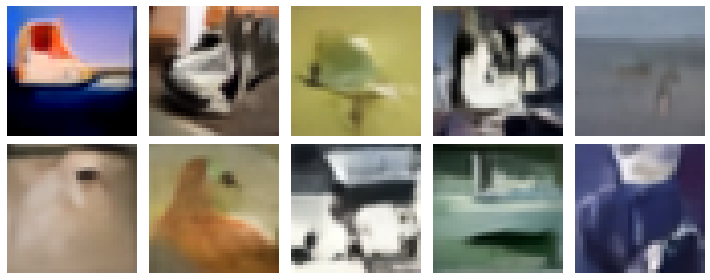

Epoch 54/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0546 - i_loss: 0.2059 - val_n_loss: 0.0524 - val_i_loss: 0.1553 - val_kid: 0.1407


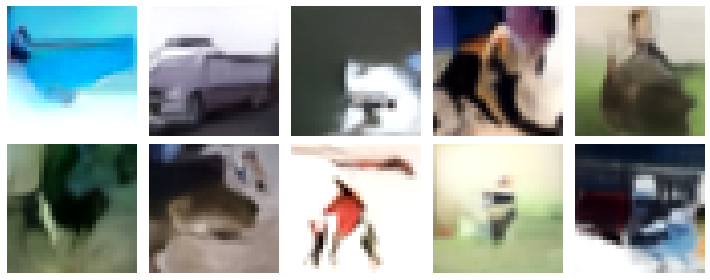

Epoch 55/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0547 - i_loss: 0.2032 - val_n_loss: 0.0524 - val_i_loss: 0.1563 - val_kid: 0.1499


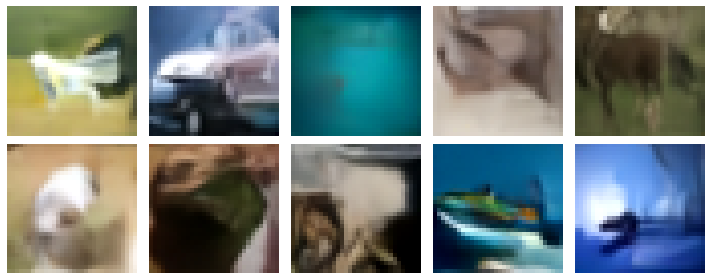

Epoch 56/500
703/703 [==============================] - 48s 68ms/step - n_loss: 0.0547 - i_loss: 0.2092 - val_n_loss: 0.0526 - val_i_loss: 0.1545 - val_kid: 0.1355


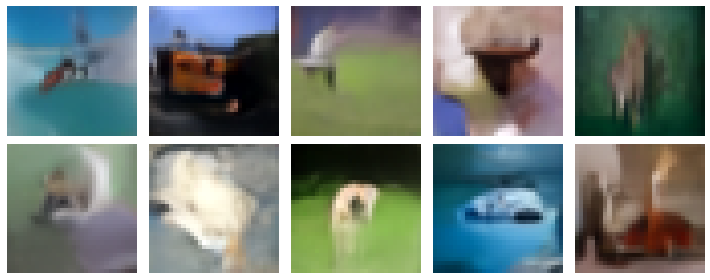

Epoch 57/500
703/703 [==============================] - 48s 68ms/step - n_loss: 0.0547 - i_loss: 0.2008 - val_n_loss: 0.0525 - val_i_loss: 0.1562 - val_kid: 0.1336


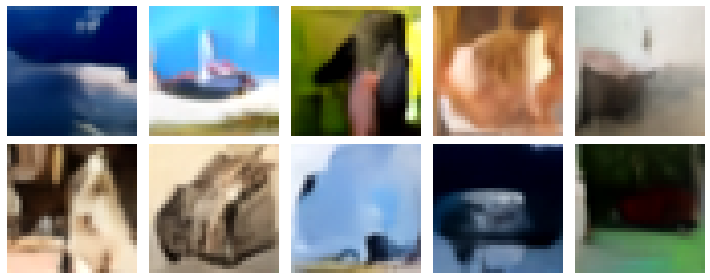

Epoch 58/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0544 - i_loss: 0.2042 - val_n_loss: 0.0529 - val_i_loss: 0.1553 - val_kid: 0.1461


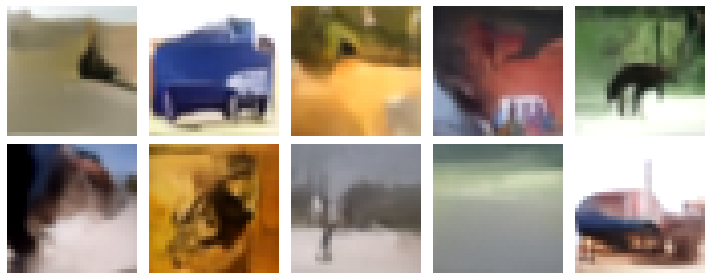

Epoch 59/500
703/703 [==============================] - 48s 68ms/step - n_loss: 0.0546 - i_loss: 0.2013 - val_n_loss: 0.0530 - val_i_loss: 0.1529 - val_kid: 0.1536


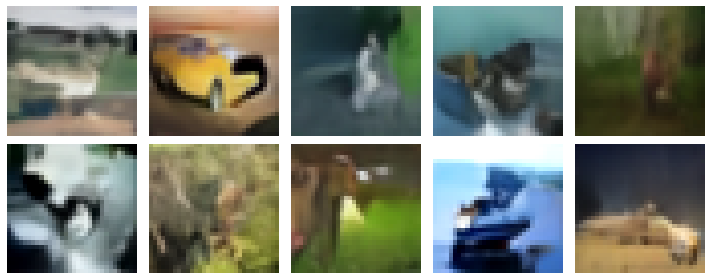

Epoch 60/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0543 - i_loss: 0.2041 - val_n_loss: 0.0533 - val_i_loss: 0.1575 - val_kid: 0.1477


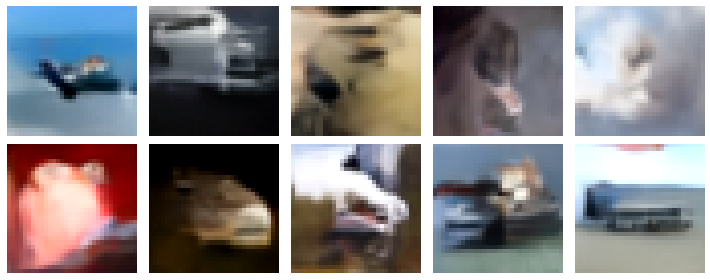

Epoch 61/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0544 - i_loss: 0.2029 - val_n_loss: 0.0527 - val_i_loss: 0.1533 - val_kid: 0.1520


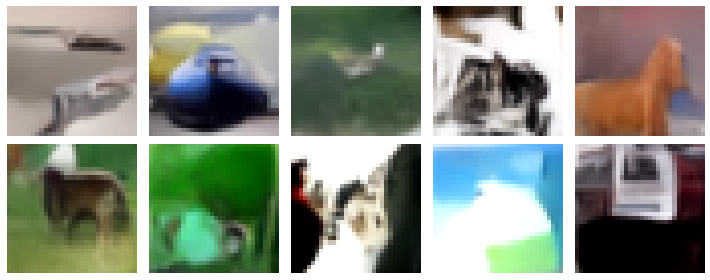

Epoch 62/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0549 - i_loss: 0.2012 - val_n_loss: 0.0524 - val_i_loss: 0.1611 - val_kid: 0.1370


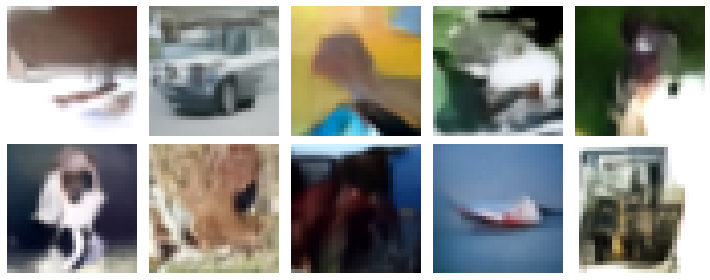

Epoch 63/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0546 - i_loss: 0.2018 - val_n_loss: 0.0531 - val_i_loss: 0.1576 - val_kid: 0.1435


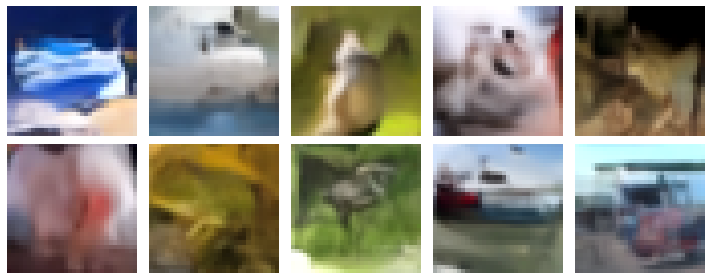

Epoch 64/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0550 - i_loss: 0.2043 - val_n_loss: 0.0518 - val_i_loss: 0.1610 - val_kid: 0.1410


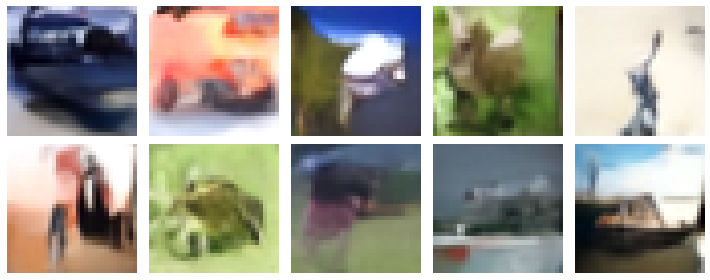

Epoch 65/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0543 - i_loss: 0.2039 - val_n_loss: 0.0518 - val_i_loss: 0.1587 - val_kid: 0.1480


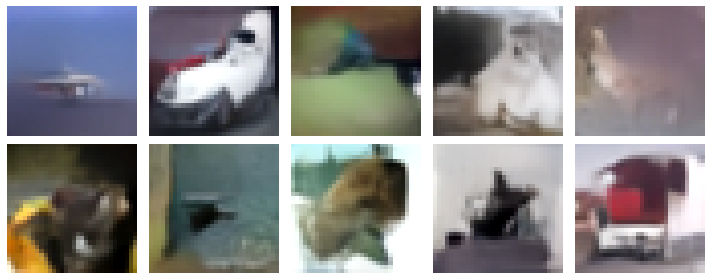

Epoch 66/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0546 - i_loss: 0.2041 - val_n_loss: 0.0533 - val_i_loss: 0.1556 - val_kid: 0.1613


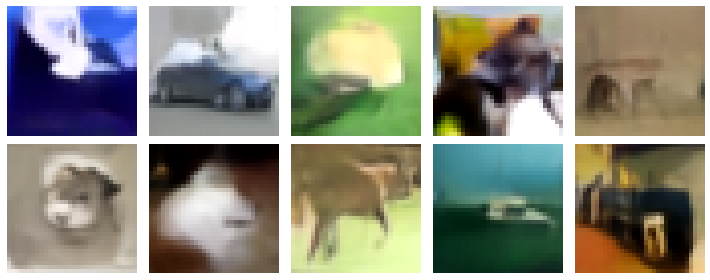

Epoch 67/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0542 - i_loss: 0.2007 - val_n_loss: 0.0521 - val_i_loss: 0.1544 - val_kid: 0.1461


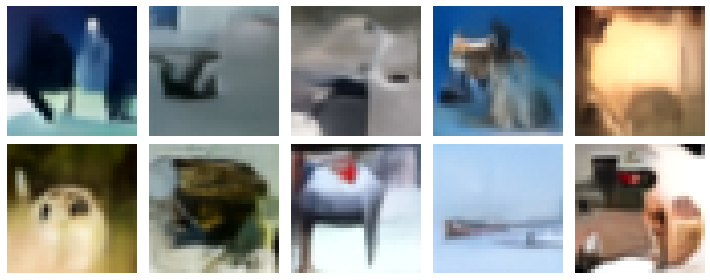

Epoch 68/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0542 - i_loss: 0.2057 - val_n_loss: 0.0521 - val_i_loss: 0.1567 - val_kid: 0.1474


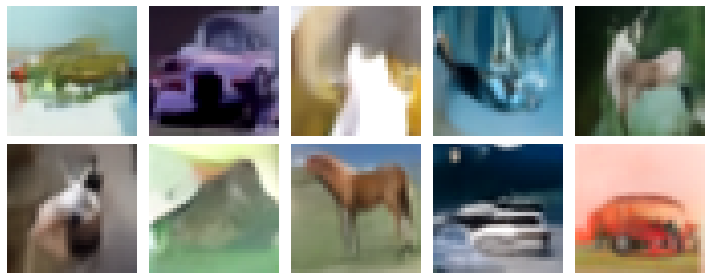

Epoch 69/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0542 - i_loss: 0.2069 - val_n_loss: 0.0517 - val_i_loss: 0.1646 - val_kid: 0.1438


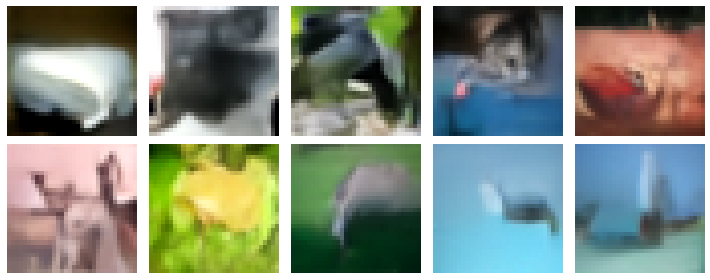

Epoch 70/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0544 - i_loss: 0.2037 - val_n_loss: 0.0533 - val_i_loss: 0.1463 - val_kid: 0.1444


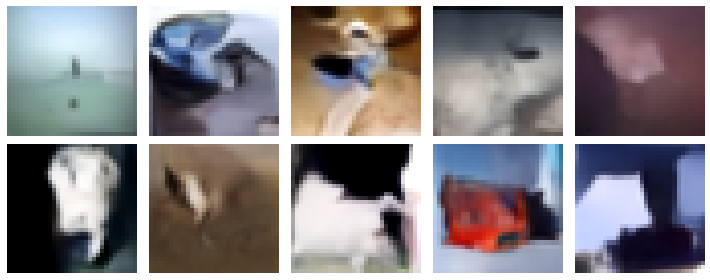

Epoch 71/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0542 - i_loss: 0.2070 - val_n_loss: 0.0526 - val_i_loss: 0.1561 - val_kid: 0.1569


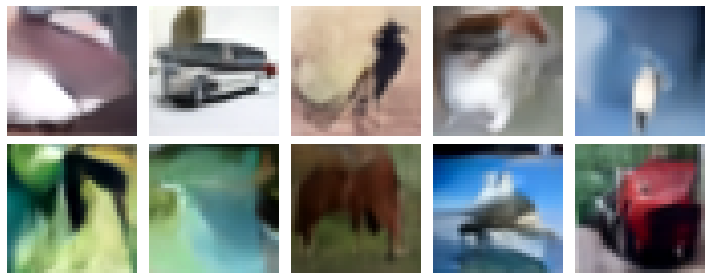

Epoch 72/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0543 - i_loss: 0.2119 - val_n_loss: 0.0524 - val_i_loss: 0.1603 - val_kid: 0.1687


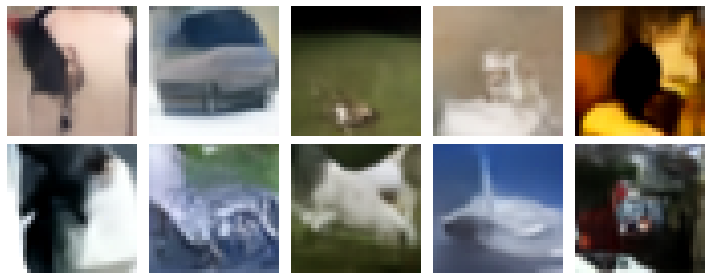

Epoch 73/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0543 - i_loss: 0.2032 - val_n_loss: 0.0532 - val_i_loss: 0.1544 - val_kid: 0.1772


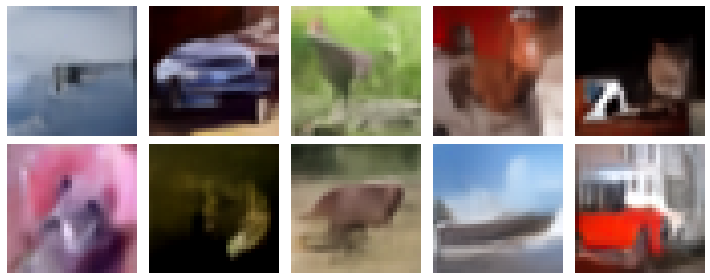

Epoch 74/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0547 - i_loss: 0.2019 - val_n_loss: 0.0528 - val_i_loss: 0.1548 - val_kid: 0.1659


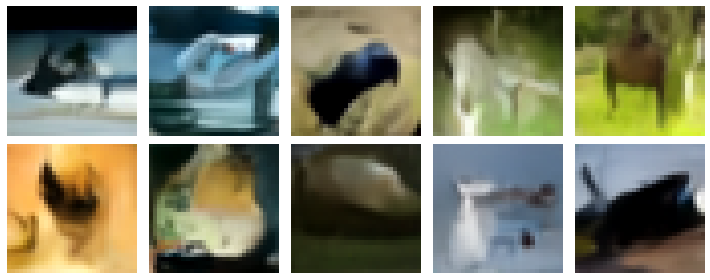

Epoch 75/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0546 - i_loss: 0.2047 - val_n_loss: 0.0523 - val_i_loss: 0.1515 - val_kid: 0.1515


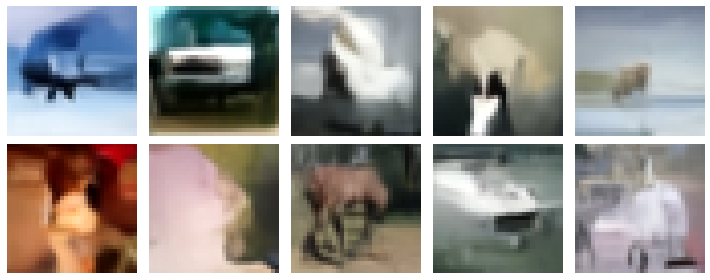

Epoch 76/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0546 - i_loss: 0.2062 - val_n_loss: 0.0527 - val_i_loss: 0.1515 - val_kid: 0.1509


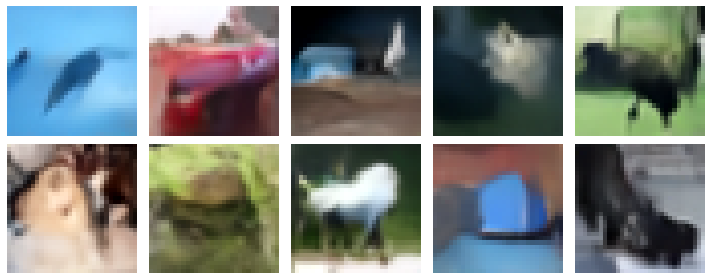

Epoch 77/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0544 - i_loss: 0.2080 - val_n_loss: 0.0528 - val_i_loss: 0.1545 - val_kid: 0.1567


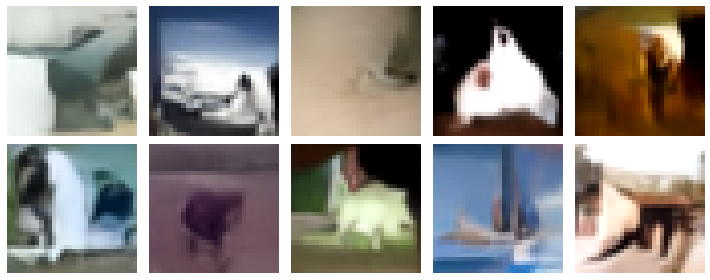

Epoch 78/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0545 - i_loss: 0.2011 - val_n_loss: 0.0532 - val_i_loss: 0.1534 - val_kid: 0.1469


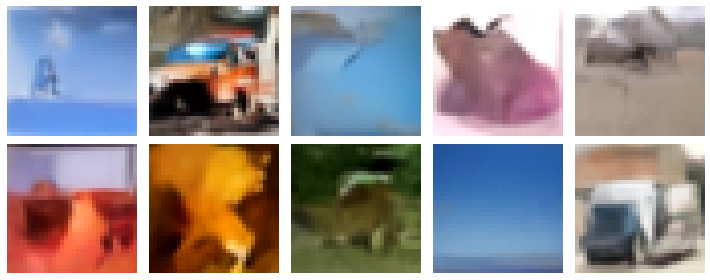

Epoch 79/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0547 - i_loss: 0.2026 - val_n_loss: 0.0525 - val_i_loss: 0.1562 - val_kid: 0.1535


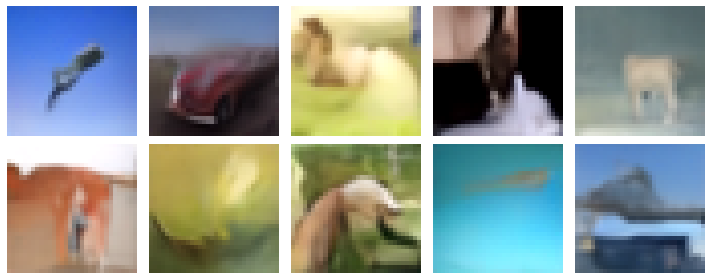

Epoch 80/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0546 - i_loss: 0.2042 - val_n_loss: 0.0529 - val_i_loss: 0.1544 - val_kid: 0.1550


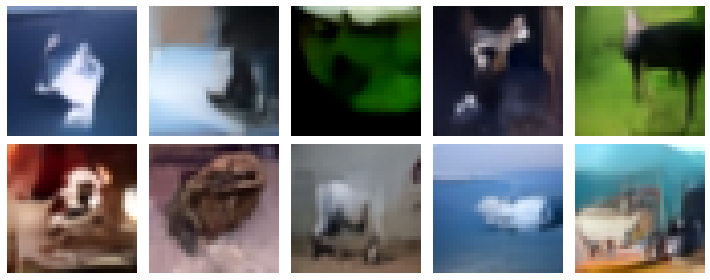

Epoch 81/500
703/703 [==============================] - 48s 69ms/step - n_loss: 0.0543 - i_loss: 0.2042 - val_n_loss: 0.0527 - val_i_loss: 0.1525 - val_kid: 0.1514


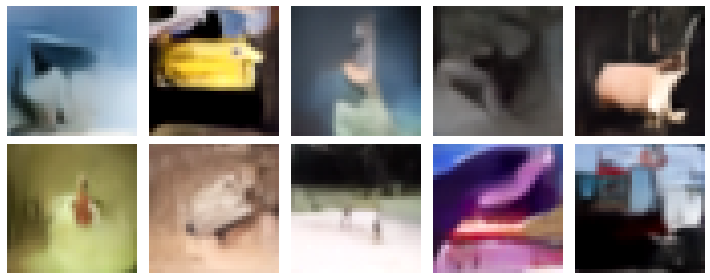

Epoch 82/500
703/703 [==============================] - 48s 68ms/step - n_loss: 0.0545 - i_loss: 0.2018 - val_n_loss: 0.0517 - val_i_loss: 0.1562 - val_kid: 0.1551


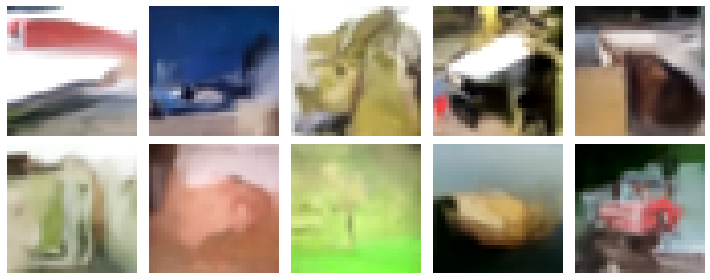

Epoch 83/500
703/703 [==============================] - 48s 68ms/step - n_loss: 0.0543 - i_loss: 0.2065 - val_n_loss: 0.0523 - val_i_loss: 0.1561 - val_kid: 0.1510


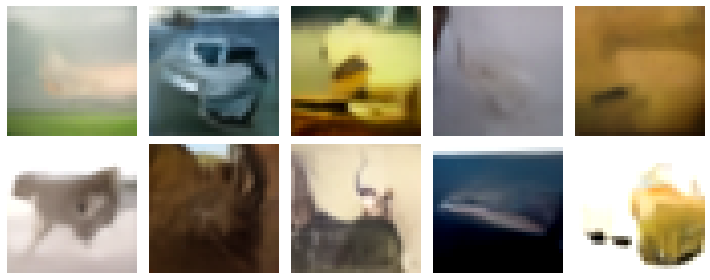

Epoch 84/500
703/703 [==============================] - 48s 68ms/step - n_loss: 0.0544 - i_loss: 0.2072 - val_n_loss: 0.0522 - val_i_loss: 0.1506 - val_kid: 0.1483


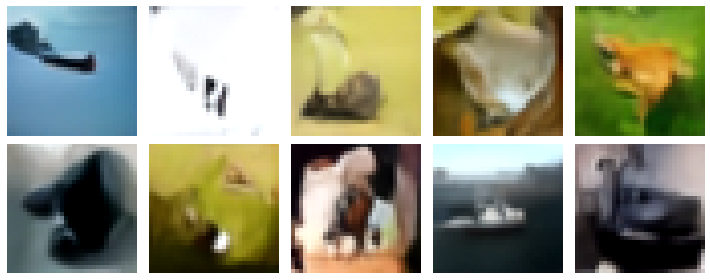

Epoch 85/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0547 - i_loss: 0.2031 - val_n_loss: 0.0523 - val_i_loss: 0.1506 - val_kid: 0.1529


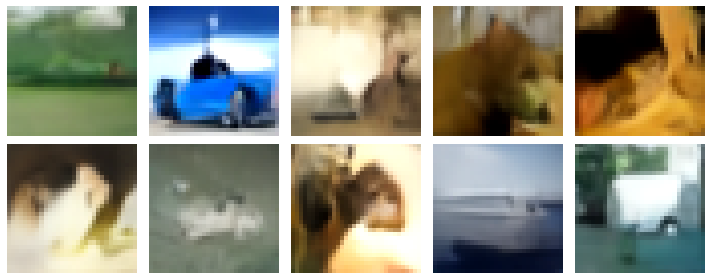

Epoch 86/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0545 - i_loss: 0.2040 - val_n_loss: 0.0521 - val_i_loss: 0.1555 - val_kid: 0.1572


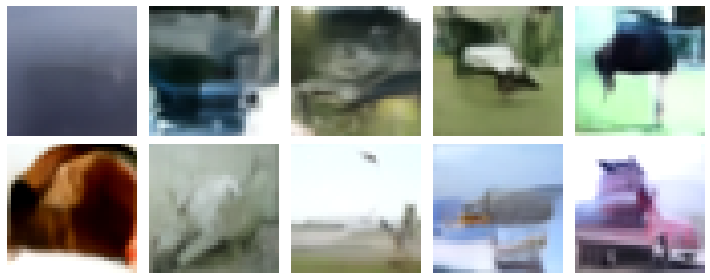

Epoch 87/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0543 - i_loss: 0.2044 - val_n_loss: 0.0540 - val_i_loss: 0.1541 - val_kid: 0.1486


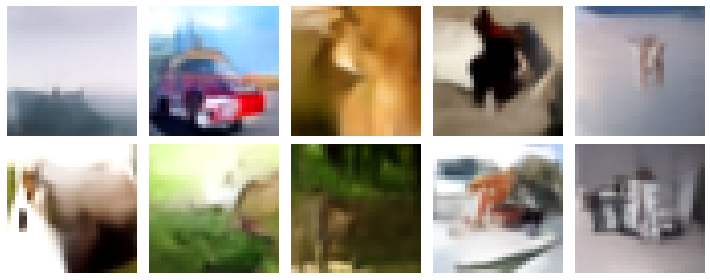

Epoch 88/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0547 - i_loss: 0.2024 - val_n_loss: 0.0523 - val_i_loss: 0.1550 - val_kid: 0.1615


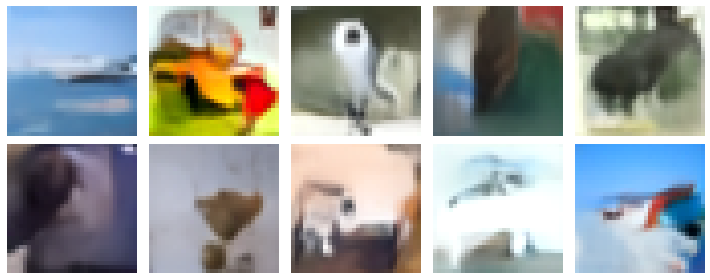

Epoch 89/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0545 - i_loss: 0.2016 - val_n_loss: 0.0526 - val_i_loss: 0.1532 - val_kid: 0.1681


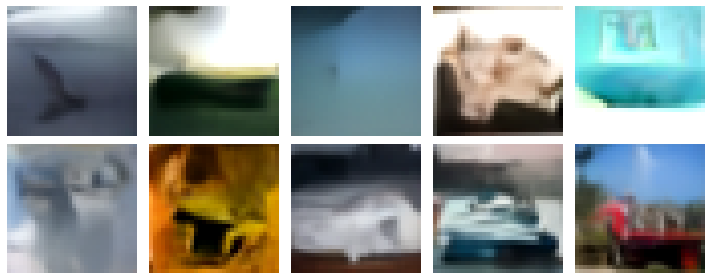

Epoch 90/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0543 - i_loss: 0.2045 - val_n_loss: 0.0519 - val_i_loss: 0.1613 - val_kid: 0.1584


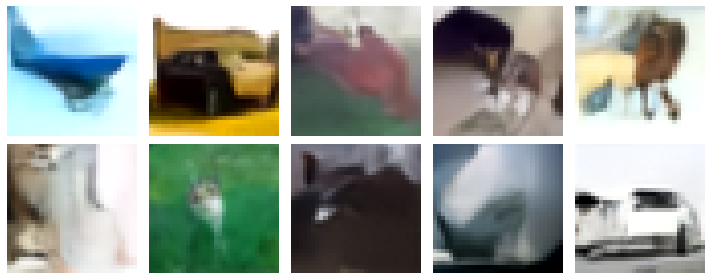

Epoch 91/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0541 - i_loss: 0.2056 - val_n_loss: 0.0528 - val_i_loss: 0.1518 - val_kid: 0.1561


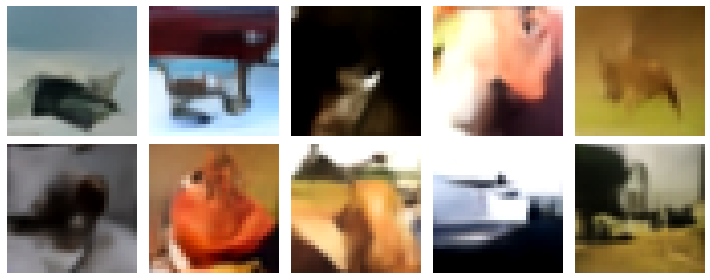

Epoch 92/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0546 - i_loss: 0.2004 - val_n_loss: 0.0522 - val_i_loss: 0.1519 - val_kid: 0.1564


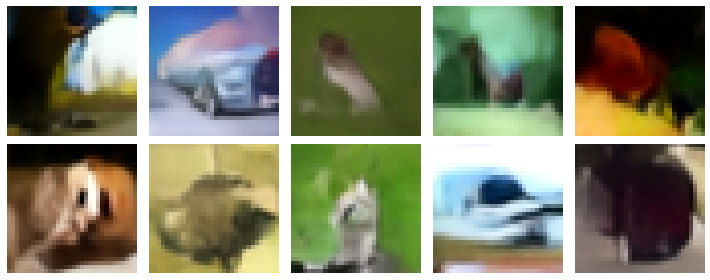

Epoch 93/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0544 - i_loss: 0.2054 - val_n_loss: 0.0522 - val_i_loss: 0.1533 - val_kid: 0.1615


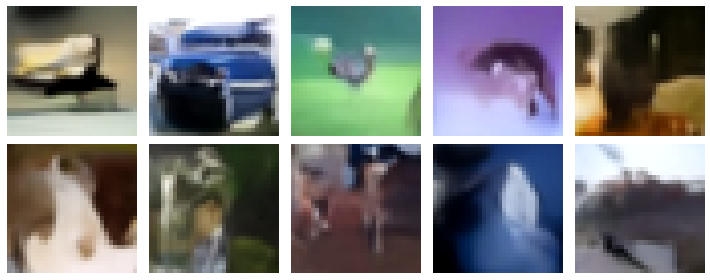

Epoch 94/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0546 - i_loss: 0.2034 - val_n_loss: 0.0519 - val_i_loss: 0.1545 - val_kid: 0.1549


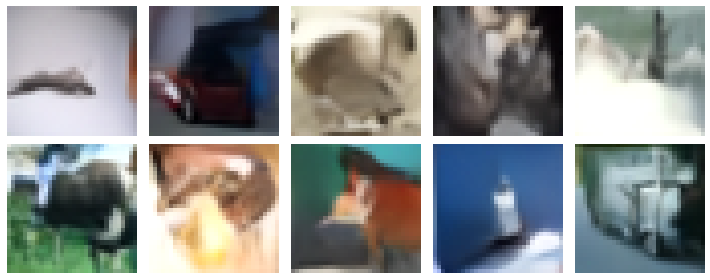

Epoch 95/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0545 - i_loss: 0.2057 - val_n_loss: 0.0520 - val_i_loss: 0.1584 - val_kid: 0.1649


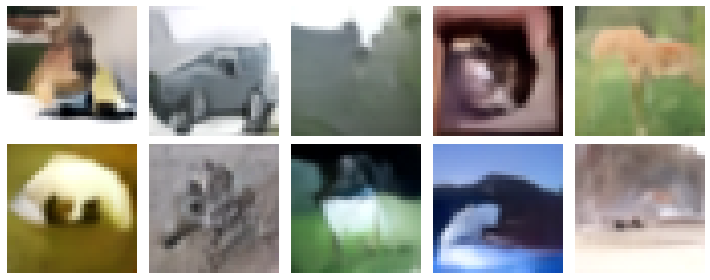

Epoch 96/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0545 - i_loss: 0.2008 - val_n_loss: 0.0513 - val_i_loss: 0.1626 - val_kid: 0.1453


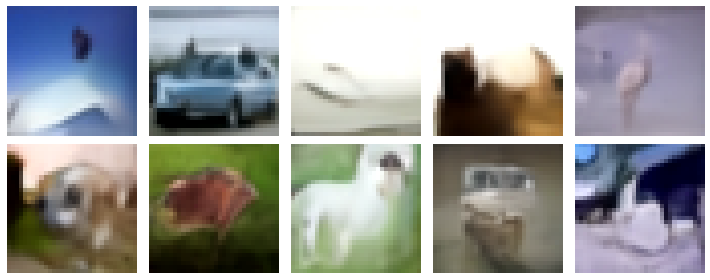

Epoch 97/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0544 - i_loss: 0.2023 - val_n_loss: 0.0513 - val_i_loss: 0.1573 - val_kid: 0.1584


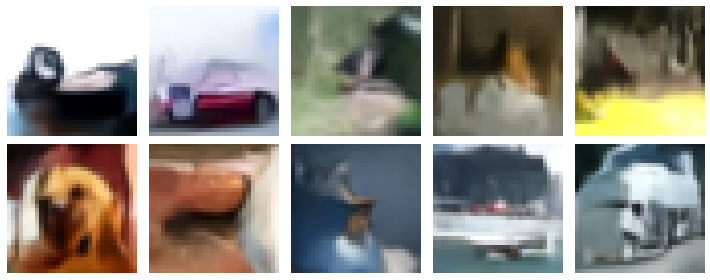

Epoch 98/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0547 - i_loss: 0.2048 - val_n_loss: 0.0524 - val_i_loss: 0.1605 - val_kid: 0.1655


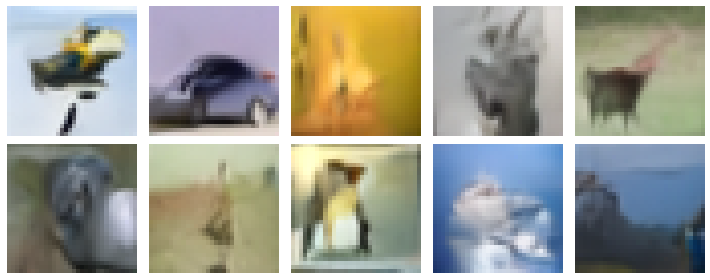

Epoch 99/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0543 - i_loss: 0.2065 - val_n_loss: 0.0529 - val_i_loss: 0.1560 - val_kid: 0.1623


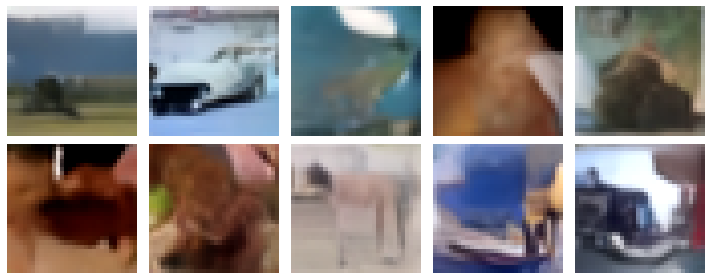

Epoch 100/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0545 - i_loss: 0.2043 - val_n_loss: 0.0522 - val_i_loss: 0.1532 - val_kid: 0.1572


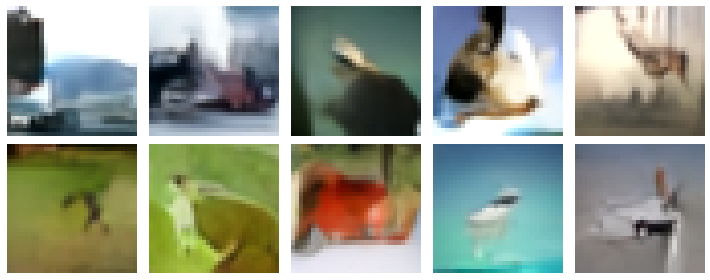

Epoch 101/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0544 - i_loss: 0.2038 - val_n_loss: 0.0529 - val_i_loss: 0.1555 - val_kid: 0.1665


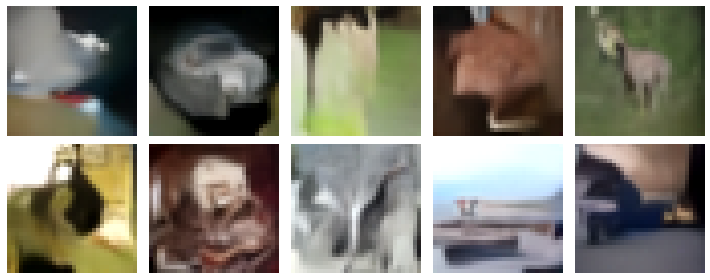

Epoch 102/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0545 - i_loss: 0.2049 - val_n_loss: 0.0520 - val_i_loss: 0.1542 - val_kid: 0.1631


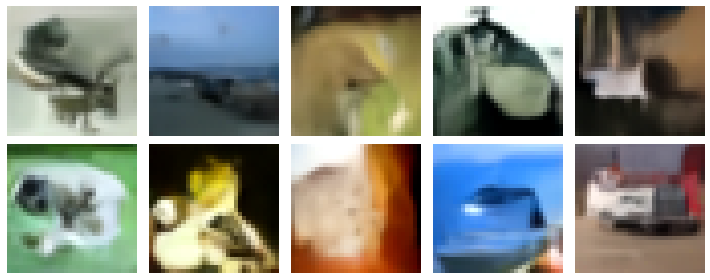

Epoch 103/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0543 - i_loss: 0.2071 - val_n_loss: 0.0524 - val_i_loss: 0.1528 - val_kid: 0.1638


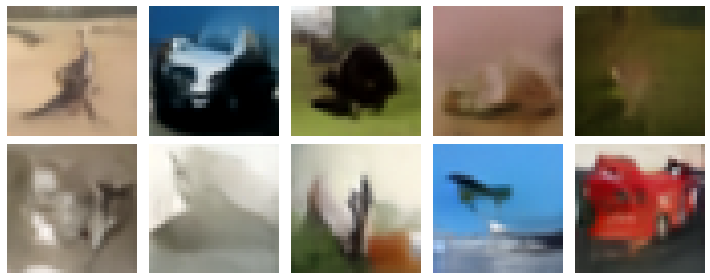

Epoch 104/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0540 - i_loss: 0.2068 - val_n_loss: 0.0525 - val_i_loss: 0.1532 - val_kid: 0.1607


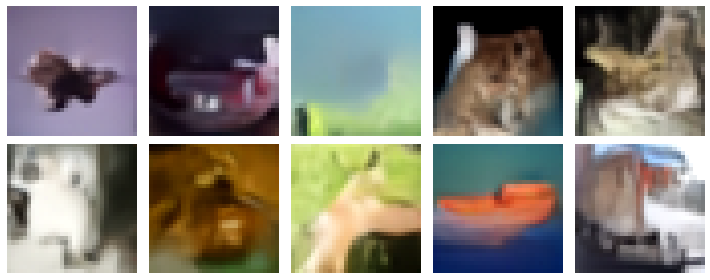

Epoch 105/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0548 - i_loss: 0.2046 - val_n_loss: 0.0525 - val_i_loss: 0.1547 - val_kid: 0.1629


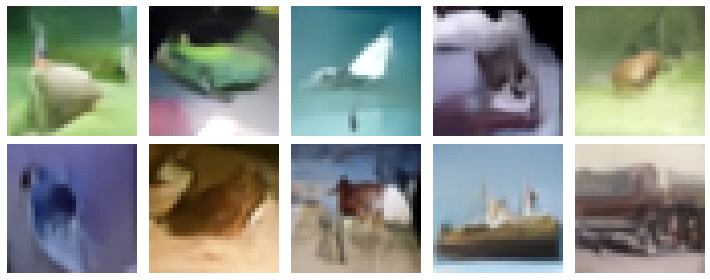

Epoch 106/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0540 - i_loss: 0.2052 - val_n_loss: 0.0514 - val_i_loss: 0.1544 - val_kid: 0.1657


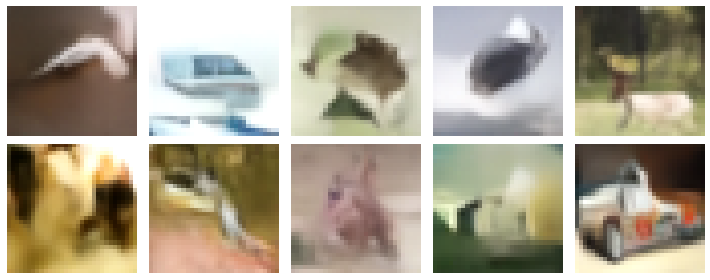

Epoch 107/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0541 - i_loss: 0.2044 - val_n_loss: 0.0523 - val_i_loss: 0.1562 - val_kid: 0.1561


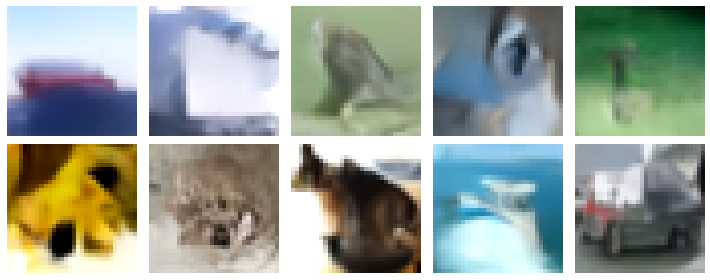

Epoch 108/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0545 - i_loss: 0.2031 - val_n_loss: 0.0521 - val_i_loss: 0.1564 - val_kid: 0.1527


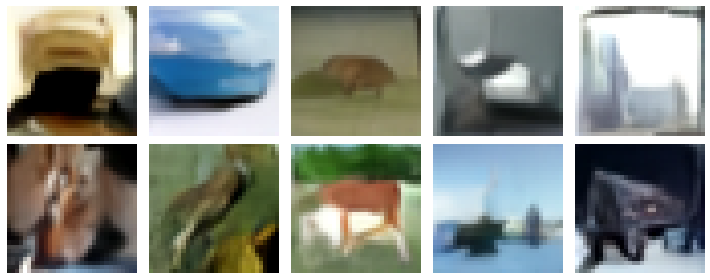

Epoch 109/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0542 - i_loss: 0.2024 - val_n_loss: 0.0518 - val_i_loss: 0.1566 - val_kid: 0.1568


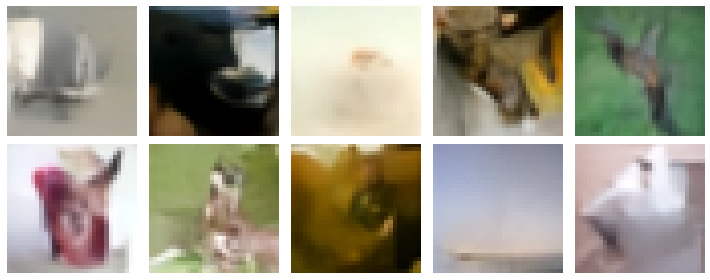

Epoch 110/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0540 - i_loss: 0.2079 - val_n_loss: 0.0532 - val_i_loss: 0.1519 - val_kid: 0.1593


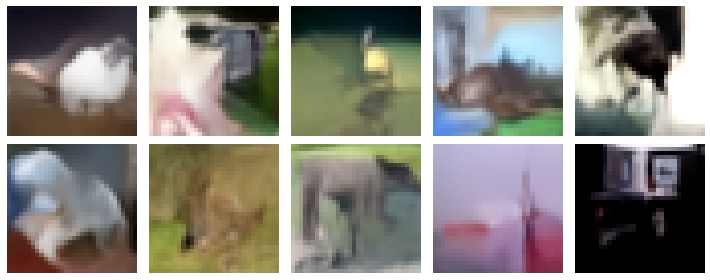

Epoch 111/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0546 - i_loss: 0.2041 - val_n_loss: 0.0516 - val_i_loss: 0.1627 - val_kid: 0.1508


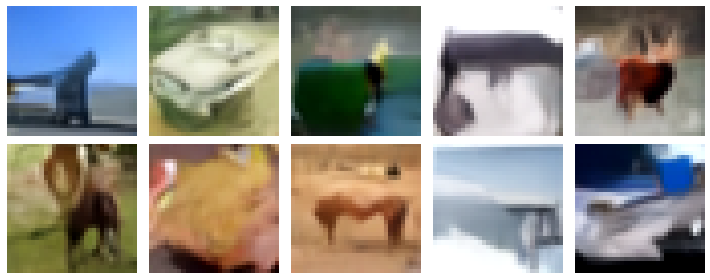

Epoch 112/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0541 - i_loss: 0.2053 - val_n_loss: 0.0525 - val_i_loss: 0.1523 - val_kid: 0.1461


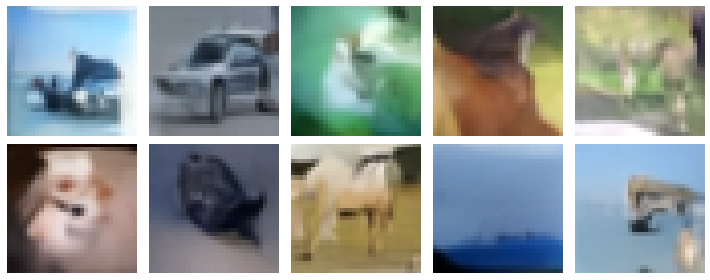

Epoch 113/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0545 - i_loss: 0.1994 - val_n_loss: 0.0511 - val_i_loss: 0.1587 - val_kid: 0.1522


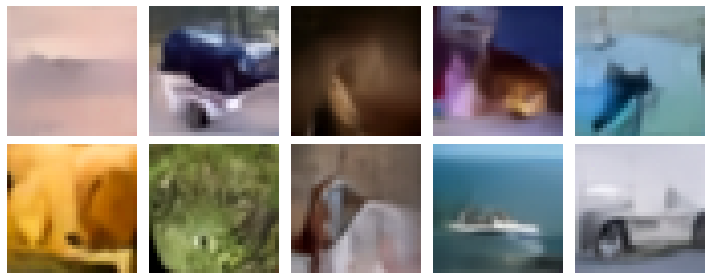

Epoch 114/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0543 - i_loss: 0.2032 - val_n_loss: 0.0520 - val_i_loss: 0.1528 - val_kid: 0.1525


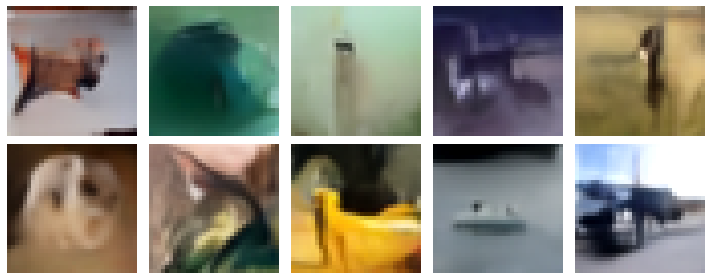

Epoch 115/500
703/703 [==============================] - 48s 68ms/step - n_loss: 0.0544 - i_loss: 0.2066 - val_n_loss: 0.0517 - val_i_loss: 0.1563 - val_kid: 0.1564


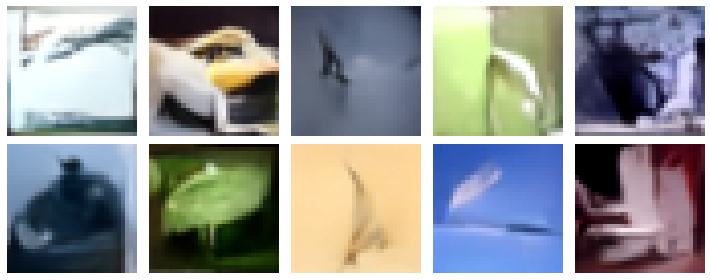

Epoch 116/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0543 - i_loss: 0.2050 - val_n_loss: 0.0515 - val_i_loss: 0.1588 - val_kid: 0.1665


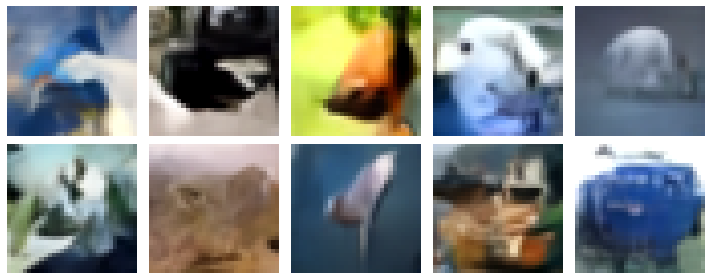

Epoch 117/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0542 - i_loss: 0.2048 - val_n_loss: 0.0528 - val_i_loss: 0.1520 - val_kid: 0.1600


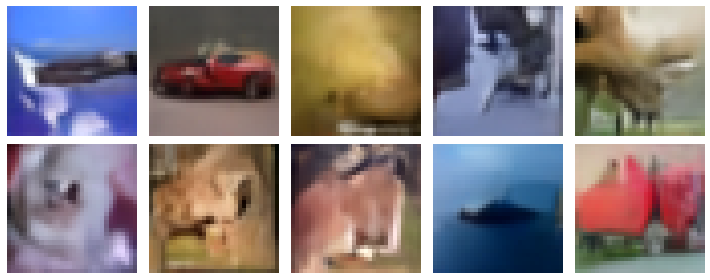

Epoch 118/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0543 - i_loss: 0.2069 - val_n_loss: 0.0525 - val_i_loss: 0.1547 - val_kid: 0.1742


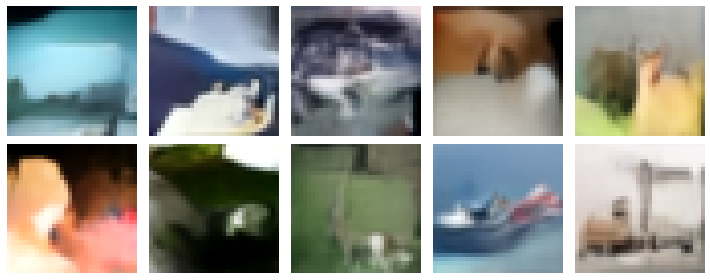

Epoch 119/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0542 - i_loss: 0.1998 - val_n_loss: 0.0512 - val_i_loss: 0.1592 - val_kid: 0.1737


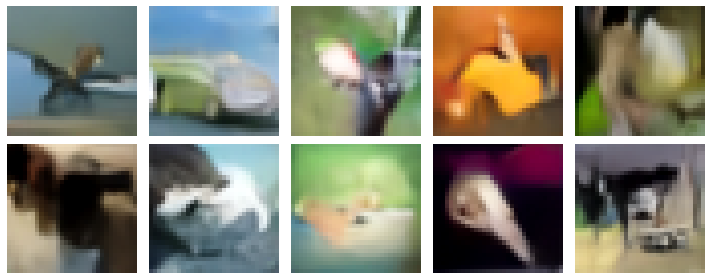

Epoch 120/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0543 - i_loss: 0.2050 - val_n_loss: 0.0519 - val_i_loss: 0.1601 - val_kid: 0.1697


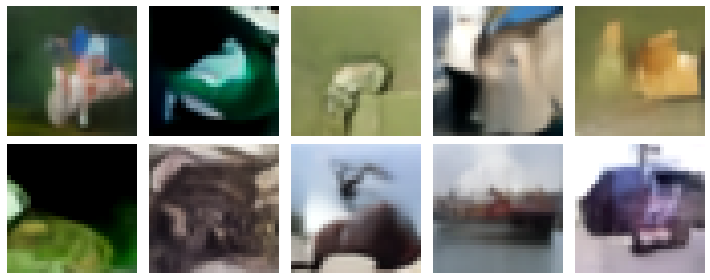

Epoch 121/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0538 - i_loss: 0.2050 - val_n_loss: 0.0516 - val_i_loss: 0.1552 - val_kid: 0.1694


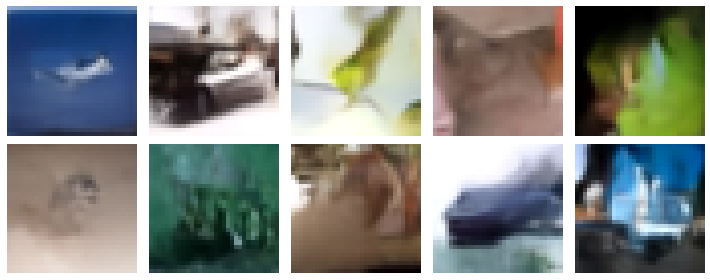

Epoch 122/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0541 - i_loss: 0.2075 - val_n_loss: 0.0532 - val_i_loss: 0.1536 - val_kid: 0.1666


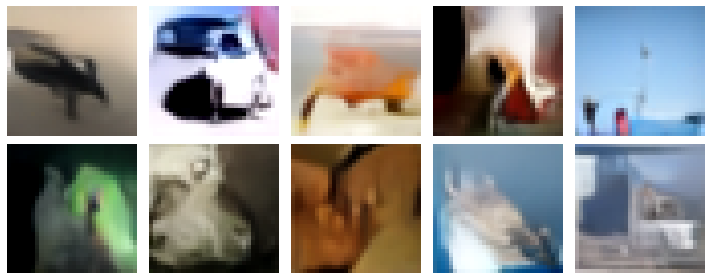

Epoch 123/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0541 - i_loss: 0.2072 - val_n_loss: 0.0523 - val_i_loss: 0.1594 - val_kid: 0.1566


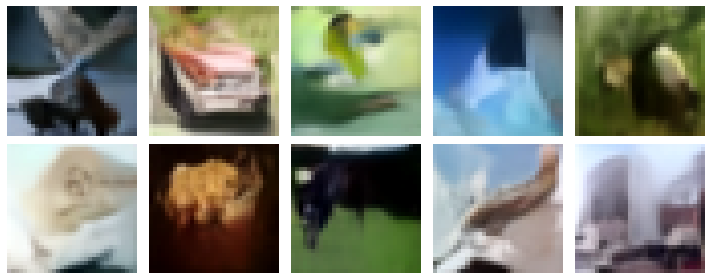

Epoch 124/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0544 - i_loss: 0.2046 - val_n_loss: 0.0528 - val_i_loss: 0.1552 - val_kid: 0.1582


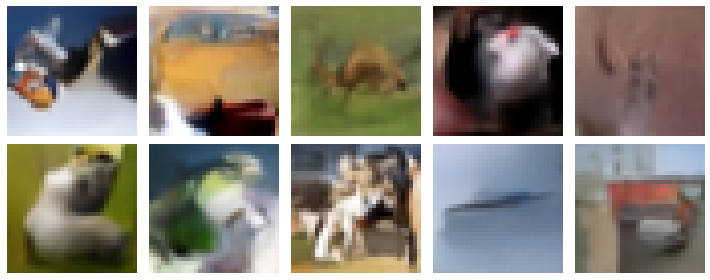

Epoch 125/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0540 - i_loss: 0.2060 - val_n_loss: 0.0532 - val_i_loss: 0.1485 - val_kid: 0.1558


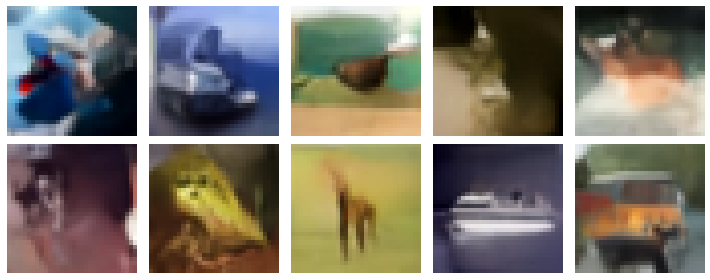

Epoch 126/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0541 - i_loss: 0.2021 - val_n_loss: 0.0524 - val_i_loss: 0.1544 - val_kid: 0.1566


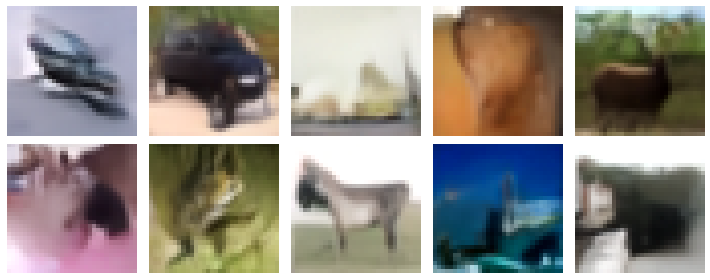

Epoch 127/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0540 - i_loss: 0.2078 - val_n_loss: 0.0526 - val_i_loss: 0.1590 - val_kid: 0.1585


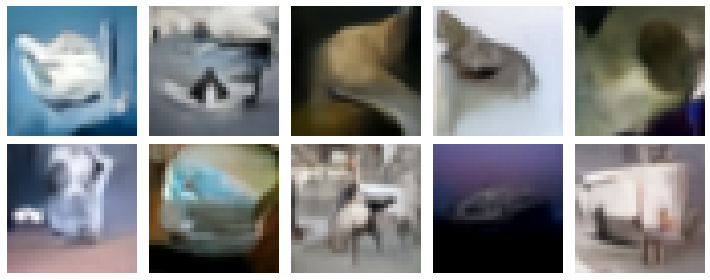

Epoch 128/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0542 - i_loss: 0.2060 - val_n_loss: 0.0519 - val_i_loss: 0.1593 - val_kid: 0.1606


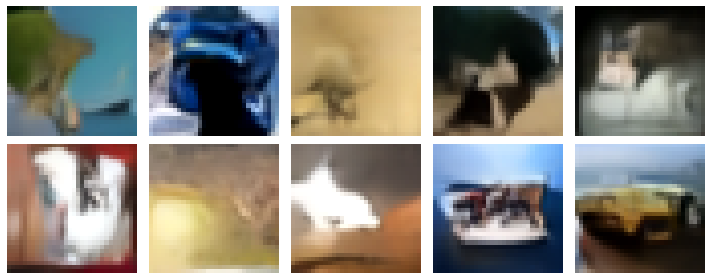

Epoch 129/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0541 - i_loss: 0.2048 - val_n_loss: 0.0526 - val_i_loss: 0.1513 - val_kid: 0.1715


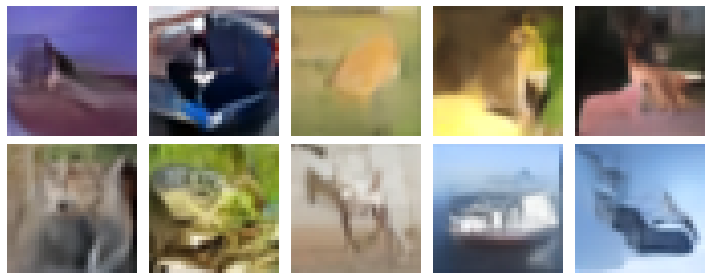

Epoch 130/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0542 - i_loss: 0.2020 - val_n_loss: 0.0523 - val_i_loss: 0.1578 - val_kid: 0.1661


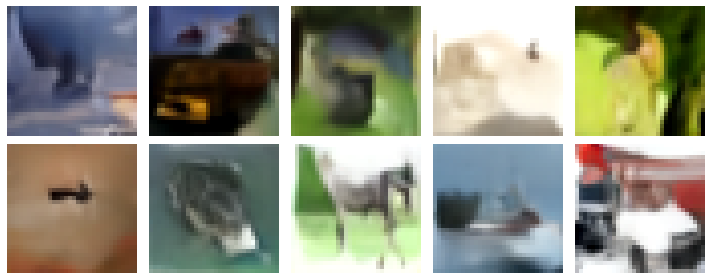

Epoch 131/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0542 - i_loss: 0.2091 - val_n_loss: 0.0526 - val_i_loss: 0.1545 - val_kid: 0.1710


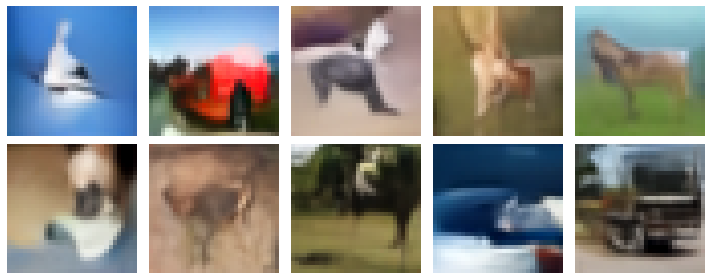

Epoch 132/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0542 - i_loss: 0.2068 - val_n_loss: 0.0515 - val_i_loss: 0.1558 - val_kid: 0.1573


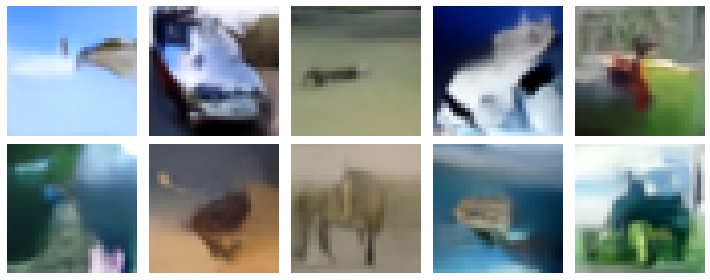

Epoch 133/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0539 - i_loss: 0.2051 - val_n_loss: 0.0524 - val_i_loss: 0.1556 - val_kid: 0.1722


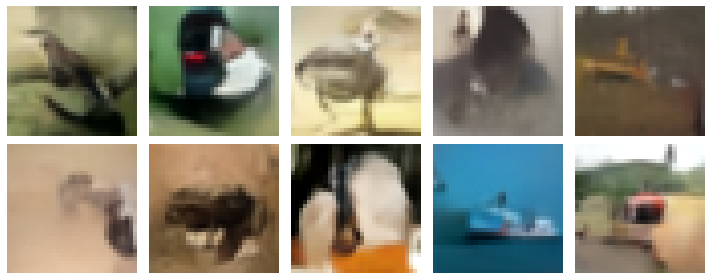

Epoch 134/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0542 - i_loss: 0.2056 - val_n_loss: 0.0518 - val_i_loss: 0.1588 - val_kid: 0.1681


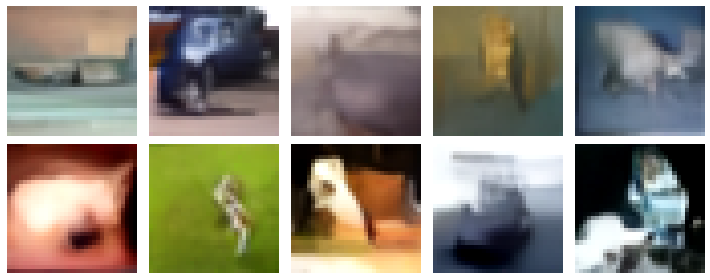

Epoch 135/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0546 - i_loss: 0.2027 - val_n_loss: 0.0519 - val_i_loss: 0.1540 - val_kid: 0.1658


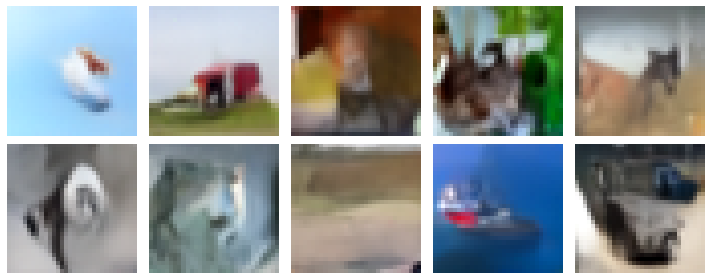

Epoch 136/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0539 - i_loss: 0.2056 - val_n_loss: 0.0523 - val_i_loss: 0.1535 - val_kid: 0.1688


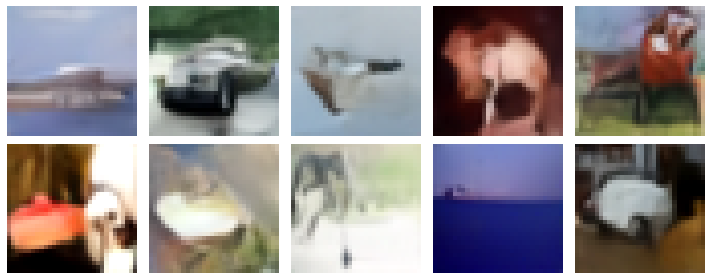

Epoch 137/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0543 - i_loss: 0.2037 - val_n_loss: 0.0521 - val_i_loss: 0.1570 - val_kid: 0.1604


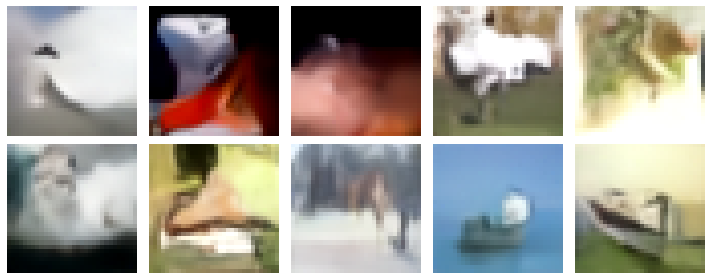

Epoch 138/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0543 - i_loss: 0.2024 - val_n_loss: 0.0532 - val_i_loss: 0.1501 - val_kid: 0.1604


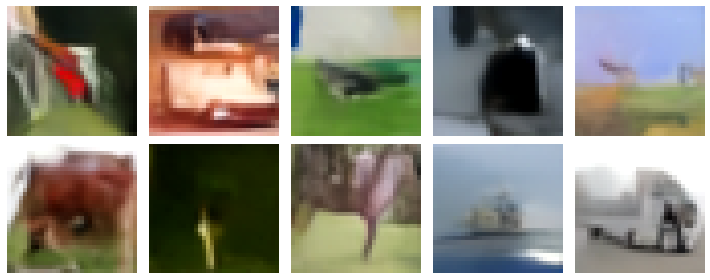

Epoch 139/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0544 - i_loss: 0.2055 - val_n_loss: 0.0522 - val_i_loss: 0.1568 - val_kid: 0.1697


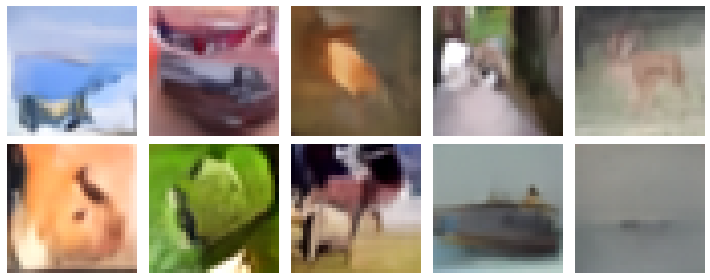

Epoch 140/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0541 - i_loss: 0.2083 - val_n_loss: 0.0528 - val_i_loss: 0.1522 - val_kid: 0.1721


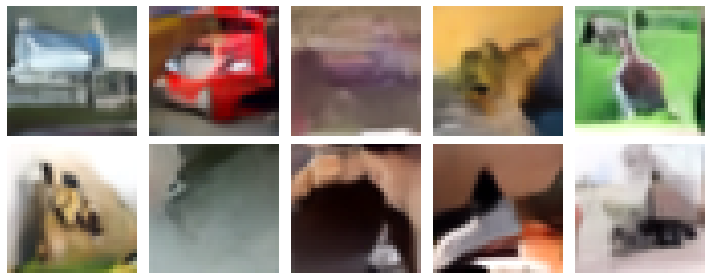

Epoch 141/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0539 - i_loss: 0.2060 - val_n_loss: 0.0524 - val_i_loss: 0.1543 - val_kid: 0.1714


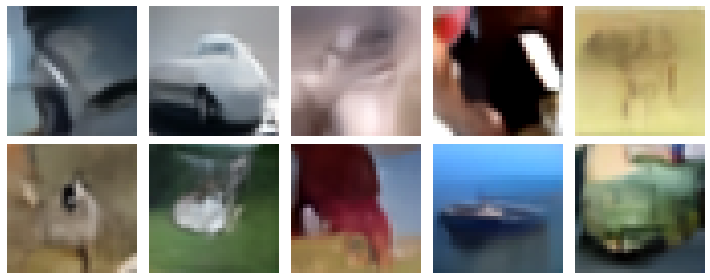

Epoch 142/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0540 - i_loss: 0.2061 - val_n_loss: 0.0518 - val_i_loss: 0.1564 - val_kid: 0.1791


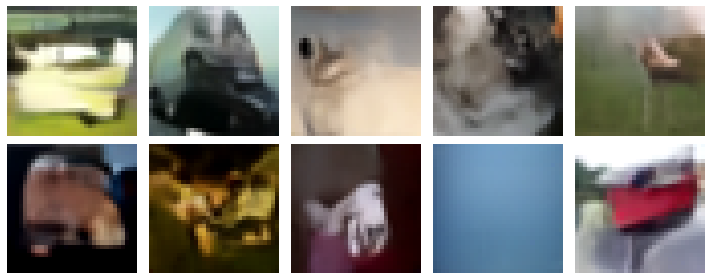

Epoch 143/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0543 - i_loss: 0.2056 - val_n_loss: 0.0519 - val_i_loss: 0.1608 - val_kid: 0.1701


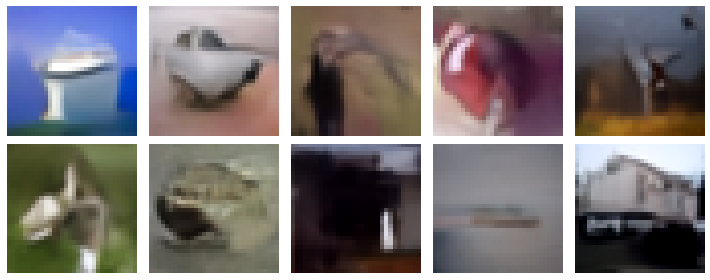

Epoch 144/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0545 - i_loss: 0.2047 - val_n_loss: 0.0522 - val_i_loss: 0.1491 - val_kid: 0.1769


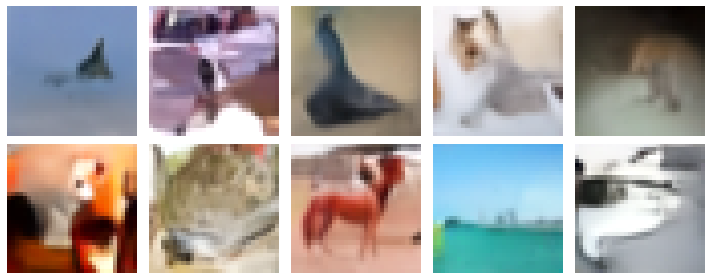

Epoch 145/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0542 - i_loss: 0.2049 - val_n_loss: 0.0506 - val_i_loss: 0.1632 - val_kid: 0.1695


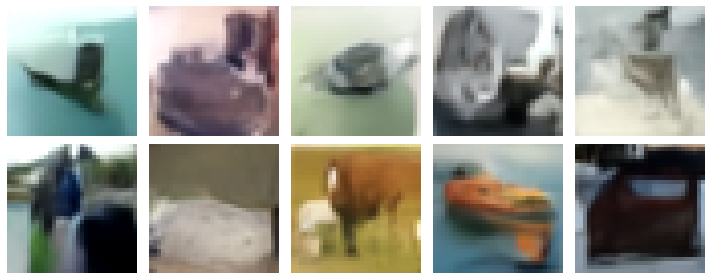

Epoch 146/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0544 - i_loss: 0.2065 - val_n_loss: 0.0522 - val_i_loss: 0.1565 - val_kid: 0.1717


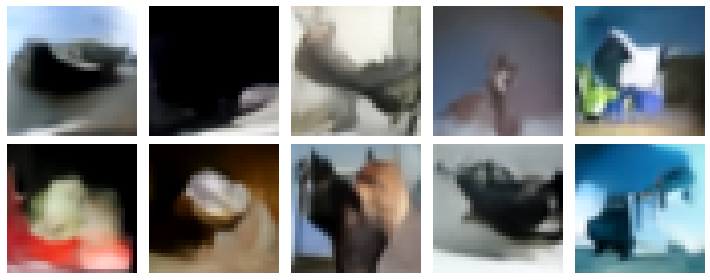

Epoch 147/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0542 - i_loss: 0.2072 - val_n_loss: 0.0520 - val_i_loss: 0.1514 - val_kid: 0.1685


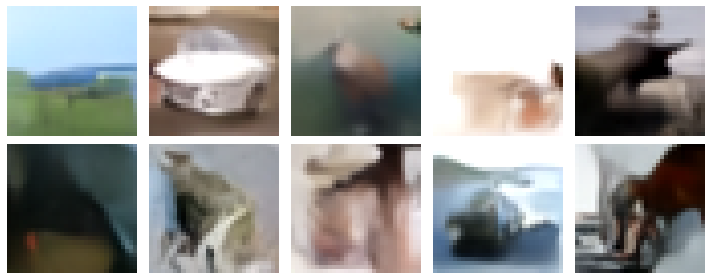

Epoch 148/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0542 - i_loss: 0.2034 - val_n_loss: 0.0519 - val_i_loss: 0.1577 - val_kid: 0.1690


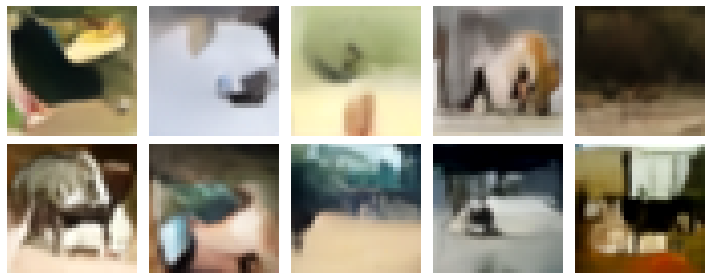

Epoch 149/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0541 - i_loss: 0.2059 - val_n_loss: 0.0516 - val_i_loss: 0.1554 - val_kid: 0.1685


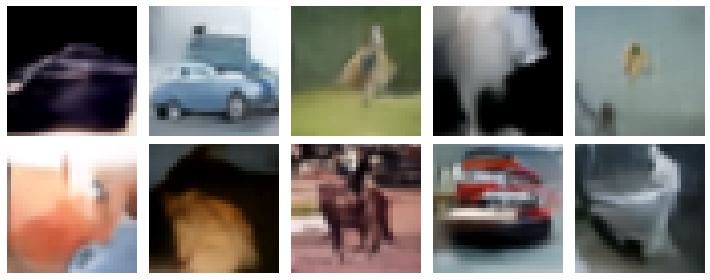

Epoch 150/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0543 - i_loss: 0.2048 - val_n_loss: 0.0520 - val_i_loss: 0.1613 - val_kid: 0.1699


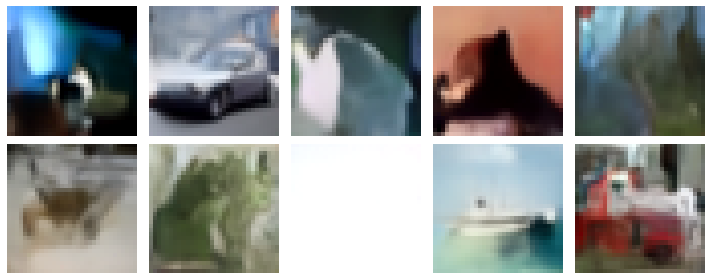

Epoch 151/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0541 - i_loss: 0.2048 - val_n_loss: 0.0530 - val_i_loss: 0.1540 - val_kid: 0.1785


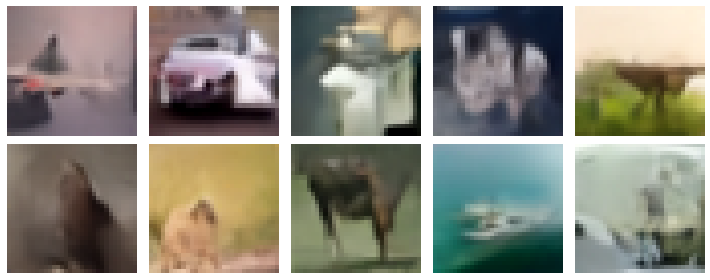

Epoch 152/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0541 - i_loss: 0.2073 - val_n_loss: 0.0516 - val_i_loss: 0.1569 - val_kid: 0.1732


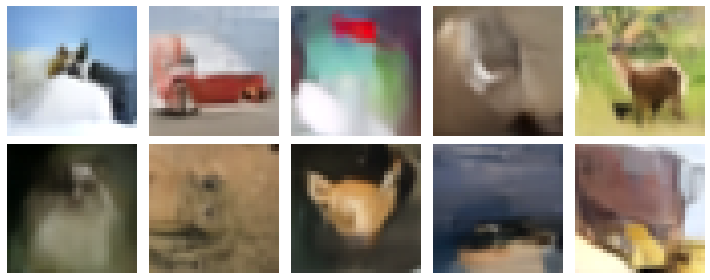

Epoch 153/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0542 - i_loss: 0.2026 - val_n_loss: 0.0531 - val_i_loss: 0.1533 - val_kid: 0.1631


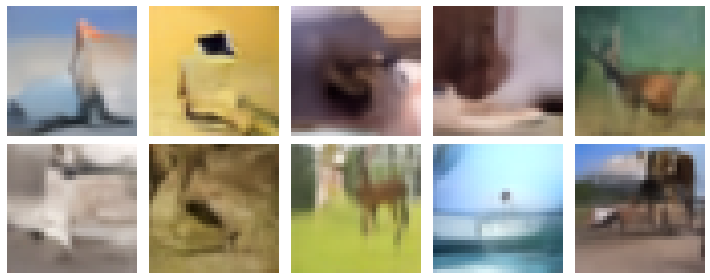

Epoch 154/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0542 - i_loss: 0.2096 - val_n_loss: 0.0528 - val_i_loss: 0.1546 - val_kid: 0.1694


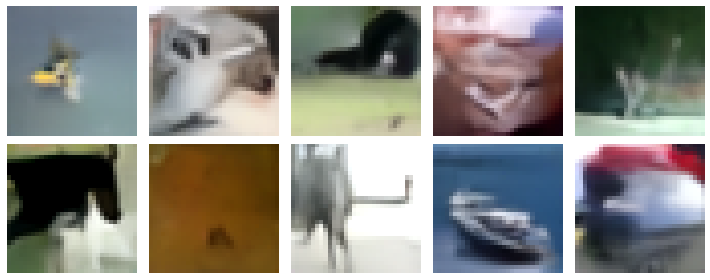

Epoch 155/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0543 - i_loss: 0.2066 - val_n_loss: 0.0522 - val_i_loss: 0.1579 - val_kid: 0.1750


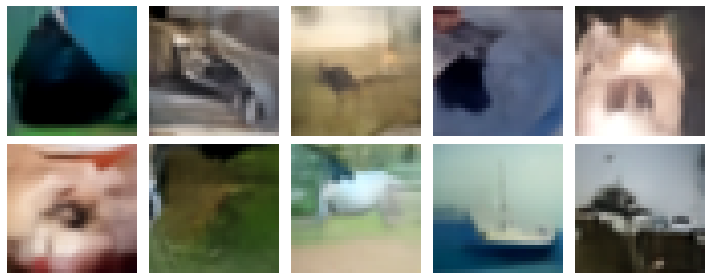

Epoch 156/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0539 - i_loss: 0.2070 - val_n_loss: 0.0529 - val_i_loss: 0.1468 - val_kid: 0.1697


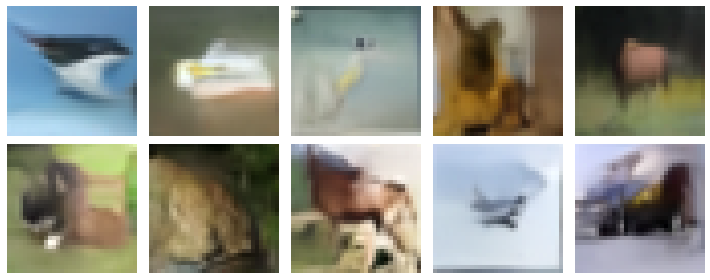

Epoch 157/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0542 - i_loss: 0.2032 - val_n_loss: 0.0518 - val_i_loss: 0.1607 - val_kid: 0.1736


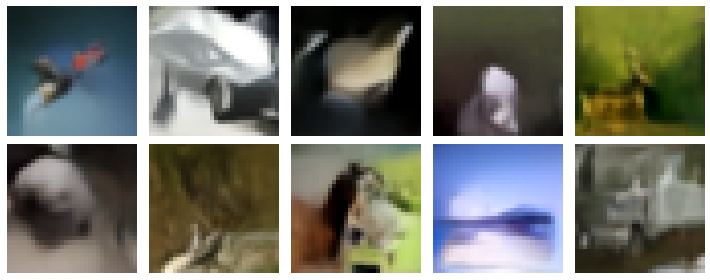

Epoch 158/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0542 - i_loss: 0.2044 - val_n_loss: 0.0524 - val_i_loss: 0.1569 - val_kid: 0.1678


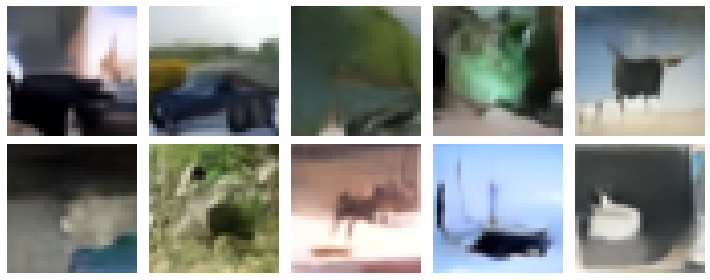

Epoch 159/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0541 - i_loss: 0.2045 - val_n_loss: 0.0511 - val_i_loss: 0.1566 - val_kid: 0.1806


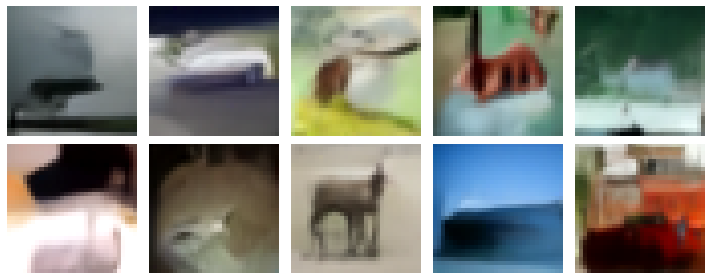

Epoch 160/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0539 - i_loss: 0.2024 - val_n_loss: 0.0521 - val_i_loss: 0.1571 - val_kid: 0.1785


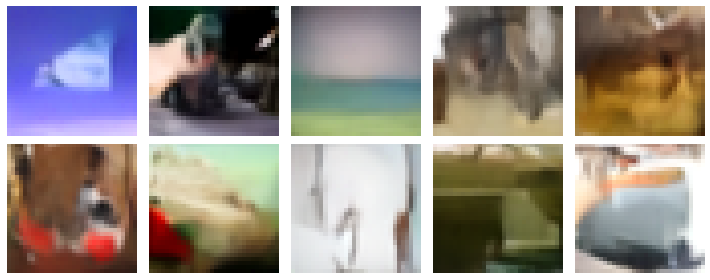

Epoch 161/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0544 - i_loss: 0.2047 - val_n_loss: 0.0517 - val_i_loss: 0.1532 - val_kid: 0.1694


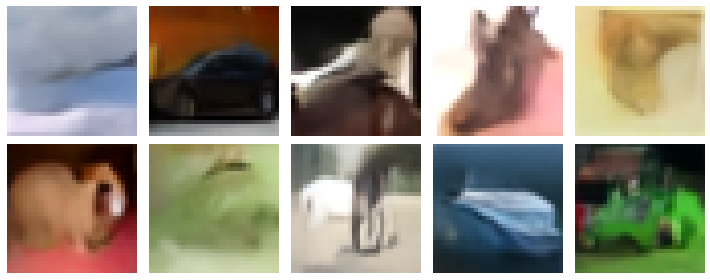

Epoch 162/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0540 - i_loss: 0.2071 - val_n_loss: 0.0530 - val_i_loss: 0.1567 - val_kid: 0.1770


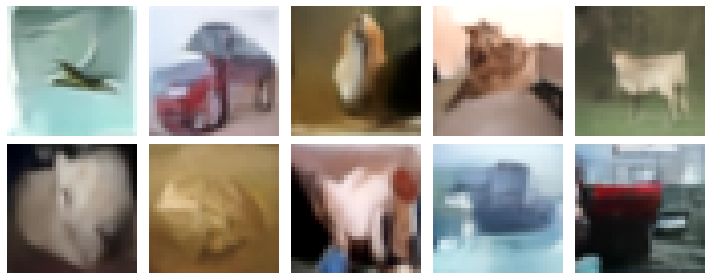

Epoch 163/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0544 - i_loss: 0.2039 - val_n_loss: 0.0539 - val_i_loss: 0.1506 - val_kid: 0.1723


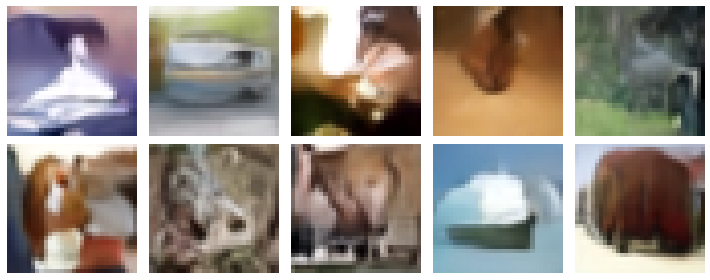

Epoch 164/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0540 - i_loss: 0.2054 - val_n_loss: 0.0513 - val_i_loss: 0.1584 - val_kid: 0.1778


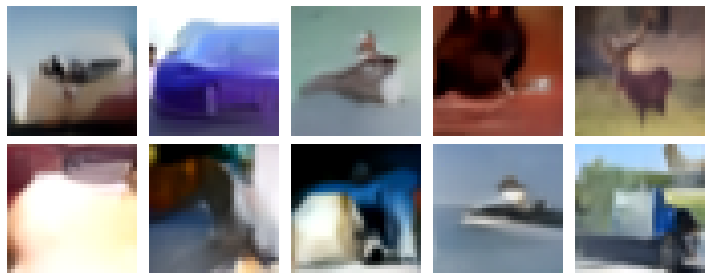

Epoch 165/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0540 - i_loss: 0.2071 - val_n_loss: 0.0521 - val_i_loss: 0.1564 - val_kid: 0.1664


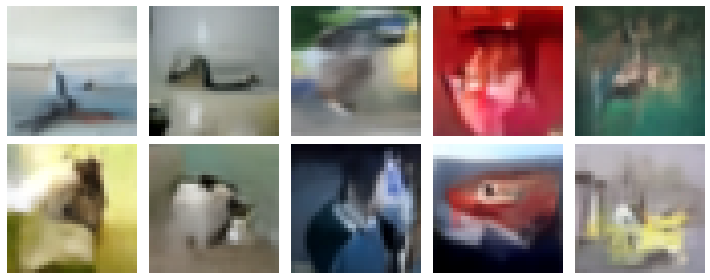

Epoch 166/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0544 - i_loss: 0.2099 - val_n_loss: 0.0539 - val_i_loss: 0.1493 - val_kid: 0.1668


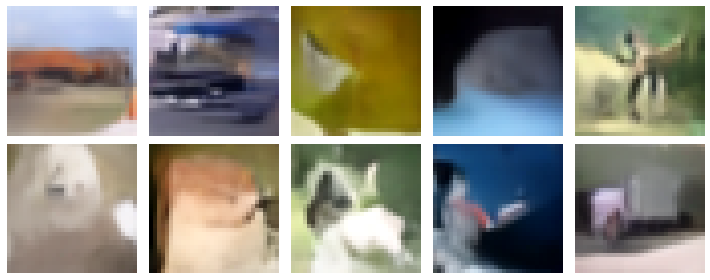

Epoch 167/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0539 - i_loss: 0.2045 - val_n_loss: 0.0516 - val_i_loss: 0.1563 - val_kid: 0.1715


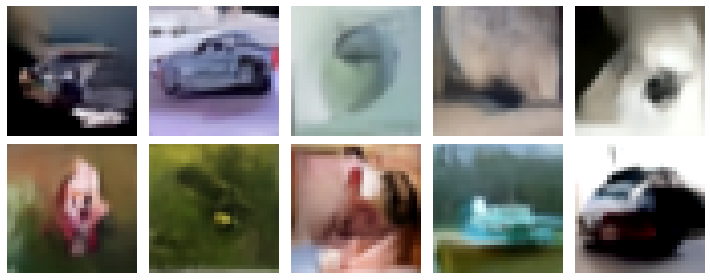

Epoch 168/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0549 - i_loss: 0.2058 - val_n_loss: 0.0521 - val_i_loss: 0.1573 - val_kid: 0.1780


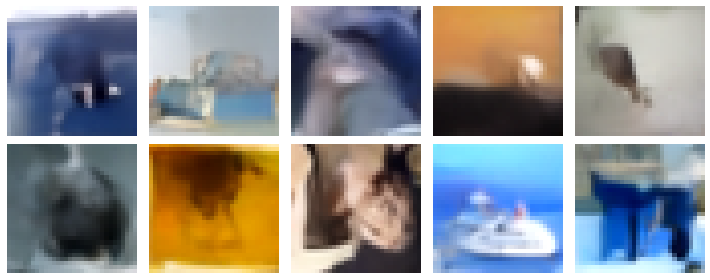

Epoch 169/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0546 - i_loss: 0.2039 - val_n_loss: 0.0524 - val_i_loss: 0.1522 - val_kid: 0.1776


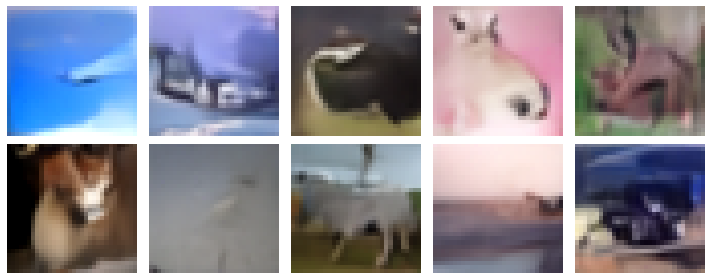

Epoch 170/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0538 - i_loss: 0.2042 - val_n_loss: 0.0531 - val_i_loss: 0.1545 - val_kid: 0.1781


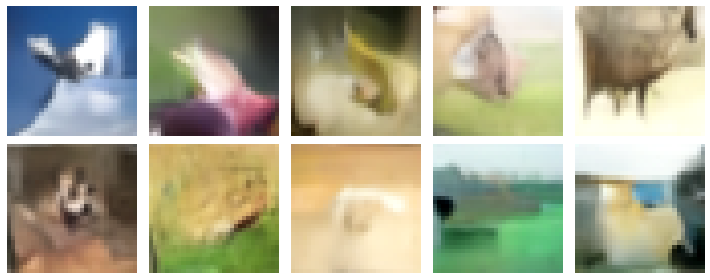

Epoch 171/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0540 - i_loss: 0.2053 - val_n_loss: 0.0522 - val_i_loss: 0.1545 - val_kid: 0.1825


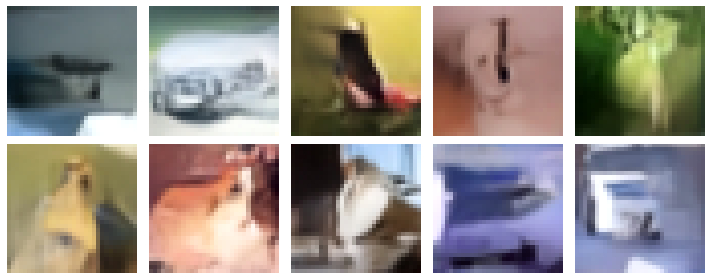

Epoch 172/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0541 - i_loss: 0.2030 - val_n_loss: 0.0520 - val_i_loss: 0.1579 - val_kid: 0.1821


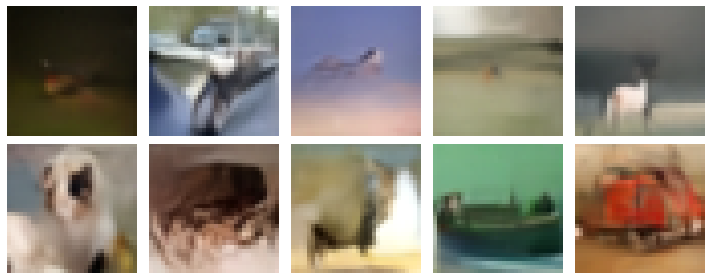

Epoch 173/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0541 - i_loss: 0.2033 - val_n_loss: 0.0515 - val_i_loss: 0.1597 - val_kid: 0.1797


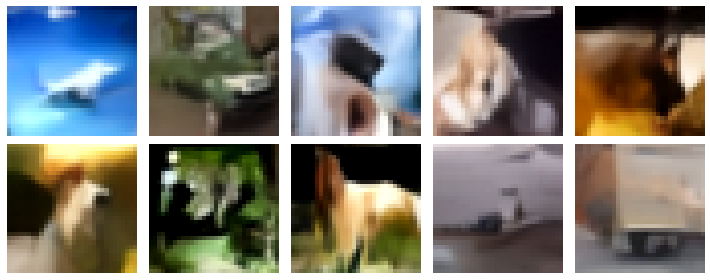

Epoch 174/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0540 - i_loss: 0.2085 - val_n_loss: 0.0524 - val_i_loss: 0.1569 - val_kid: 0.1742


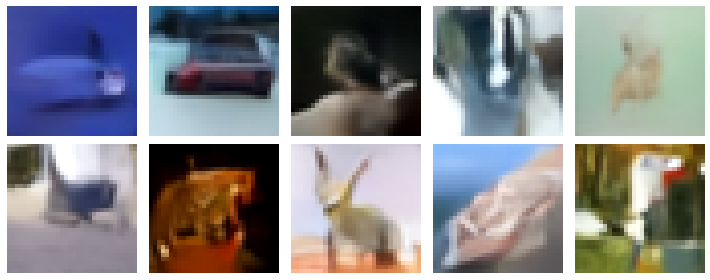

Epoch 175/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0541 - i_loss: 0.2052 - val_n_loss: 0.0518 - val_i_loss: 0.1550 - val_kid: 0.1826


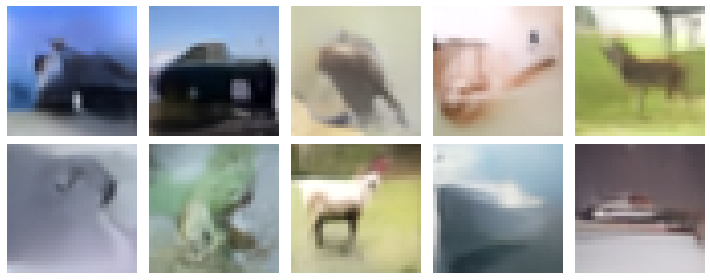

Epoch 176/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0542 - i_loss: 0.2076 - val_n_loss: 0.0528 - val_i_loss: 0.1526 - val_kid: 0.1815


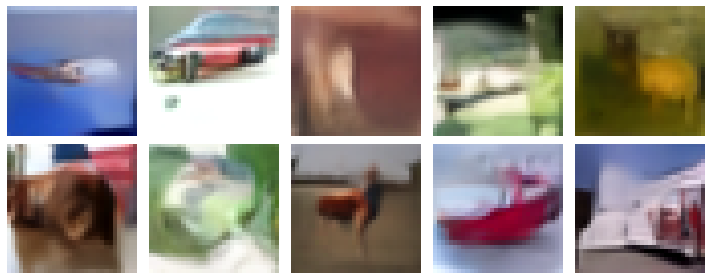

Epoch 177/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0540 - i_loss: 0.2059 - val_n_loss: 0.0518 - val_i_loss: 0.1545 - val_kid: 0.1825


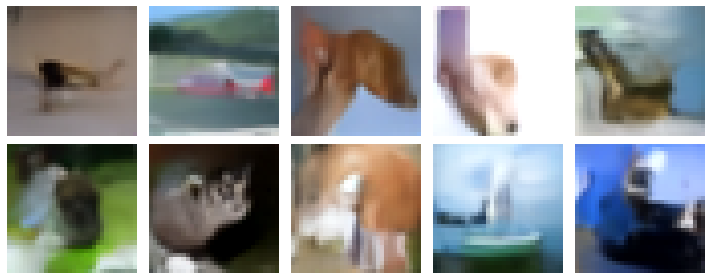

Epoch 178/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0540 - i_loss: 0.2084 - val_n_loss: 0.0522 - val_i_loss: 0.1567 - val_kid: 0.1893


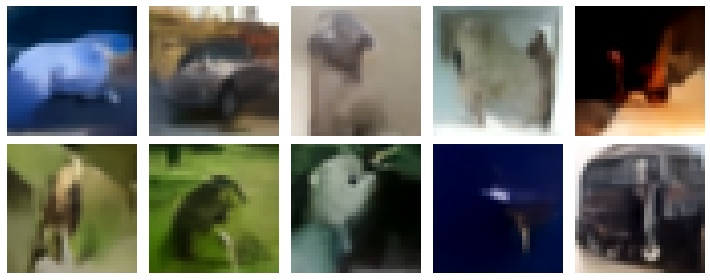

Epoch 179/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0541 - i_loss: 0.2041 - val_n_loss: 0.0523 - val_i_loss: 0.1564 - val_kid: 0.1741


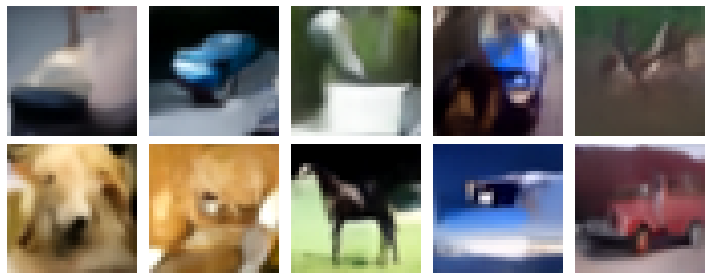

Epoch 180/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0540 - i_loss: 0.2076 - val_n_loss: 0.0518 - val_i_loss: 0.1560 - val_kid: 0.1816


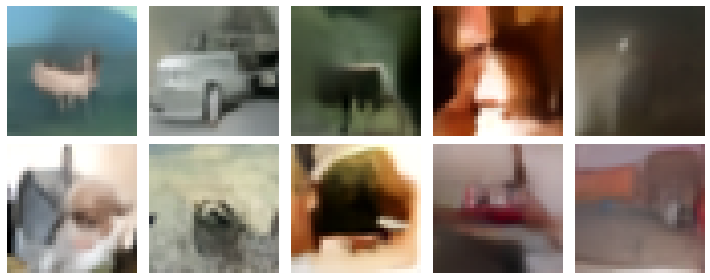

Epoch 181/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0541 - i_loss: 0.2050 - val_n_loss: 0.0530 - val_i_loss: 0.1554 - val_kid: 0.1807


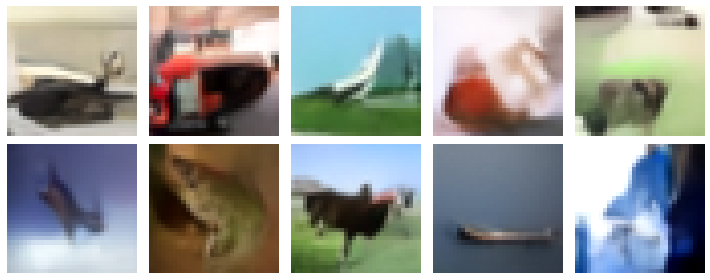

Epoch 182/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0537 - i_loss: 0.2096 - val_n_loss: 0.0519 - val_i_loss: 0.1560 - val_kid: 0.1800


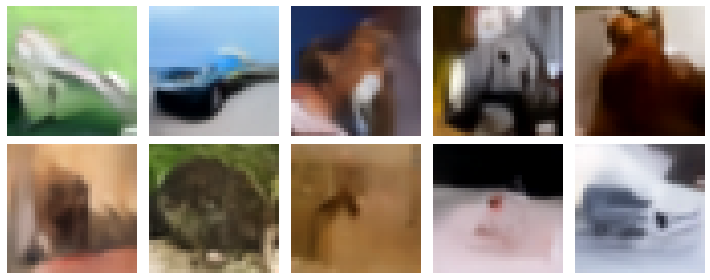

Epoch 183/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0539 - i_loss: 0.2051 - val_n_loss: 0.0525 - val_i_loss: 0.1535 - val_kid: 0.1885


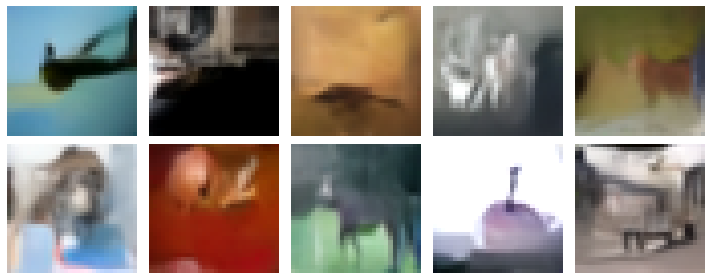

Epoch 184/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0541 - i_loss: 0.2085 - val_n_loss: 0.0520 - val_i_loss: 0.1517 - val_kid: 0.1811


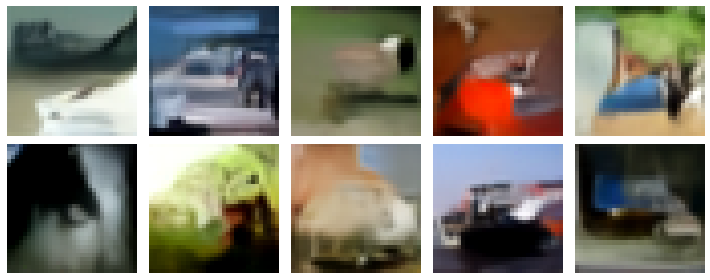

Epoch 185/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0540 - i_loss: 0.2056 - val_n_loss: 0.0522 - val_i_loss: 0.1568 - val_kid: 0.1813


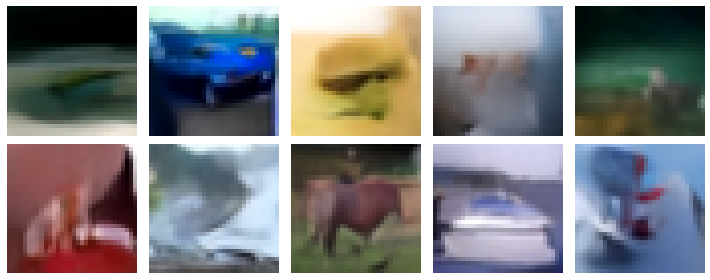

Epoch 186/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0542 - i_loss: 0.2049 - val_n_loss: 0.0526 - val_i_loss: 0.1534 - val_kid: 0.1936


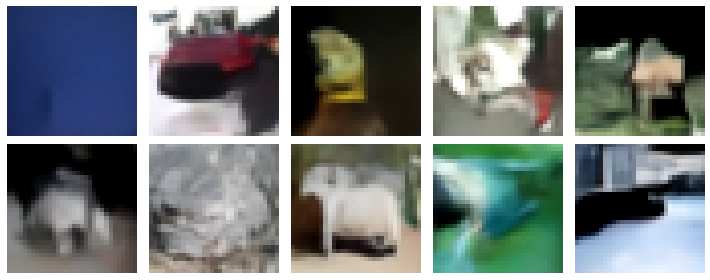

Epoch 187/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0539 - i_loss: 0.2066 - val_n_loss: 0.0514 - val_i_loss: 0.1600 - val_kid: 0.1836


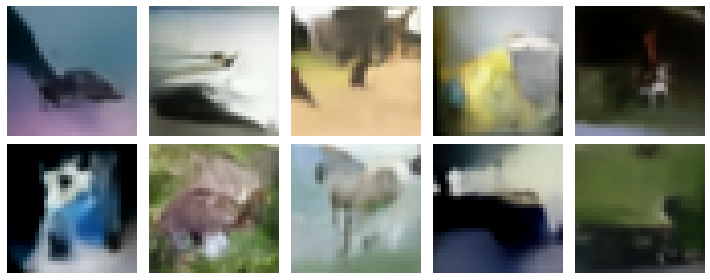

Epoch 188/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0539 - i_loss: 0.2065 - val_n_loss: 0.0526 - val_i_loss: 0.1537 - val_kid: 0.1814


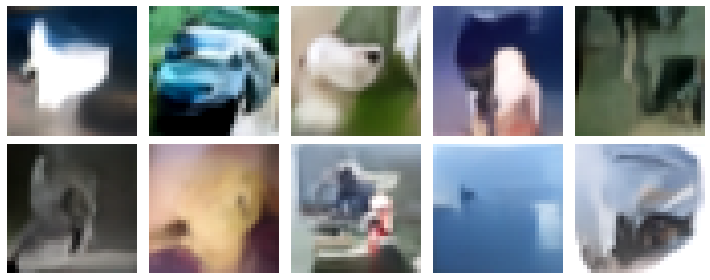

Epoch 189/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0542 - i_loss: 0.2081 - val_n_loss: 0.0524 - val_i_loss: 0.1567 - val_kid: 0.1791


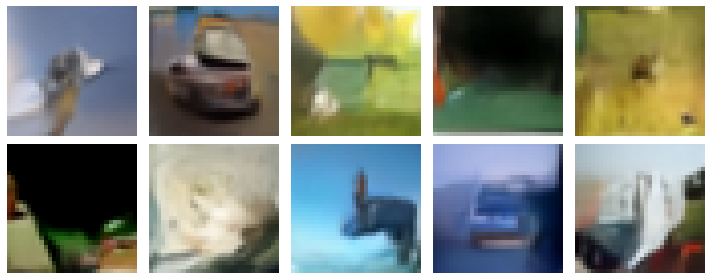

Epoch 190/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0540 - i_loss: 0.2067 - val_n_loss: 0.0526 - val_i_loss: 0.1530 - val_kid: 0.1844


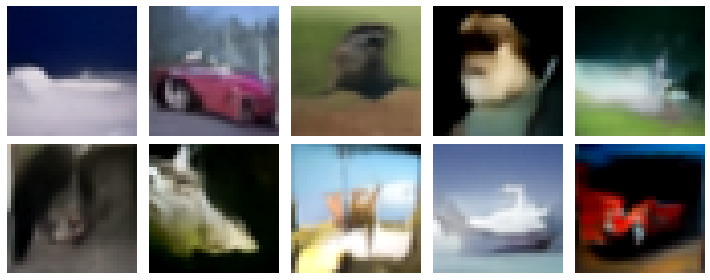

Epoch 191/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0546 - i_loss: 0.2062 - val_n_loss: 0.0523 - val_i_loss: 0.1559 - val_kid: 0.1698


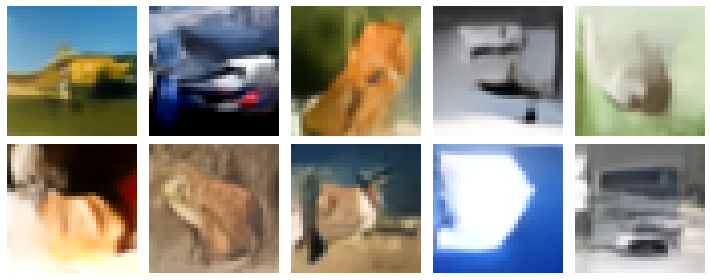

Epoch 192/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0535 - i_loss: 0.2102 - val_n_loss: 0.0528 - val_i_loss: 0.1527 - val_kid: 0.1741


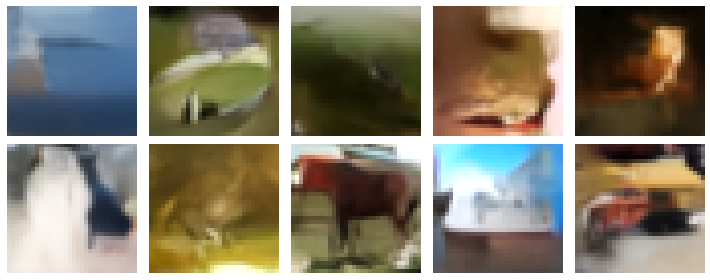

Epoch 193/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0539 - i_loss: 0.2099 - val_n_loss: 0.0521 - val_i_loss: 0.1617 - val_kid: 0.1842


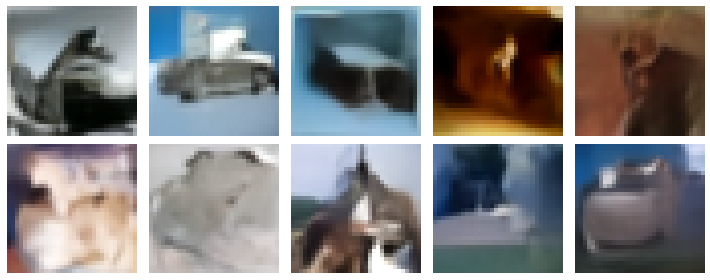

Epoch 194/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0544 - i_loss: 0.2073 - val_n_loss: 0.0520 - val_i_loss: 0.1583 - val_kid: 0.1844


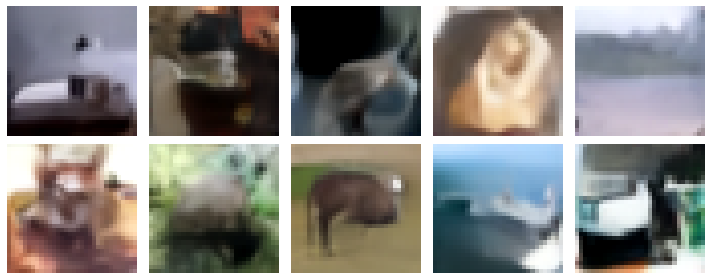

Epoch 195/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0541 - i_loss: 0.2078 - val_n_loss: 0.0521 - val_i_loss: 0.1575 - val_kid: 0.1782


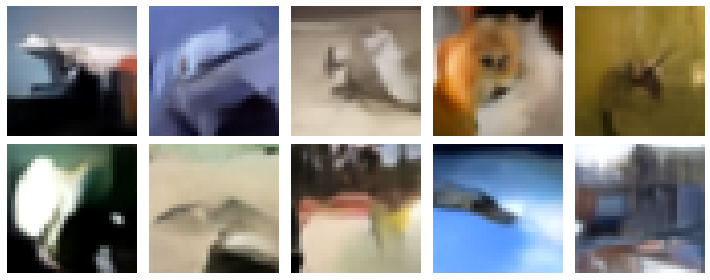

Epoch 196/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0542 - i_loss: 0.2041 - val_n_loss: 0.0530 - val_i_loss: 0.1542 - val_kid: 0.1952


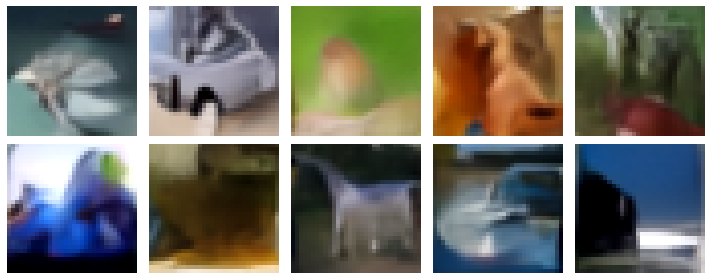

Epoch 197/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0542 - i_loss: 0.2070 - val_n_loss: 0.0518 - val_i_loss: 0.1554 - val_kid: 0.1835


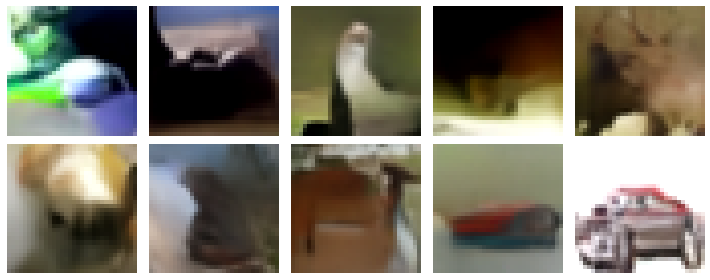

Epoch 198/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0543 - i_loss: 0.2038 - val_n_loss: 0.0518 - val_i_loss: 0.1566 - val_kid: 0.1779


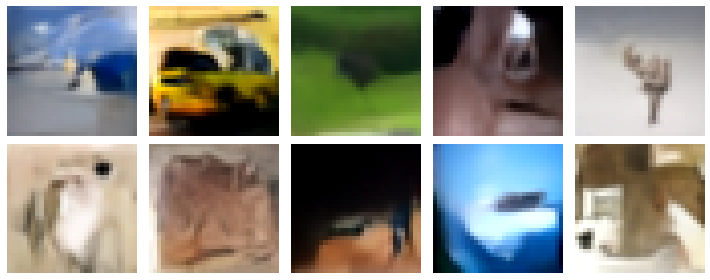

Epoch 199/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0539 - i_loss: 0.2036 - val_n_loss: 0.0512 - val_i_loss: 0.1645 - val_kid: 0.1679


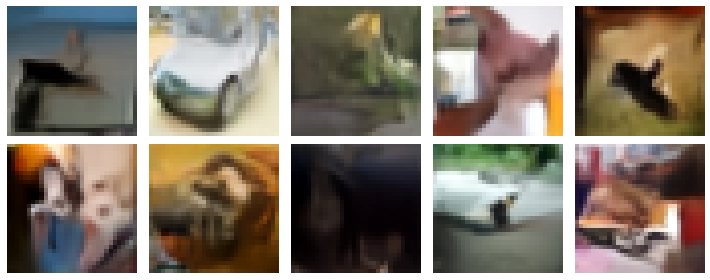

Epoch 200/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0539 - i_loss: 0.2056 - val_n_loss: 0.0526 - val_i_loss: 0.1538 - val_kid: 0.1807


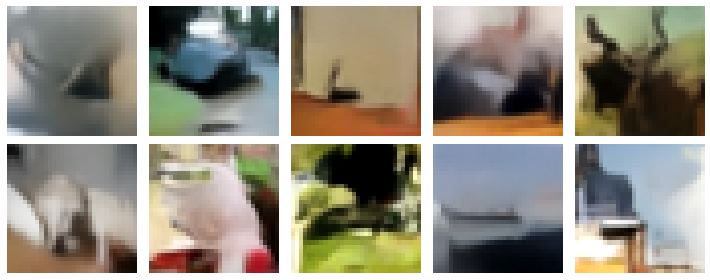

Epoch 201/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0538 - i_loss: 0.2094 - val_n_loss: 0.0523 - val_i_loss: 0.1574 - val_kid: 0.1886


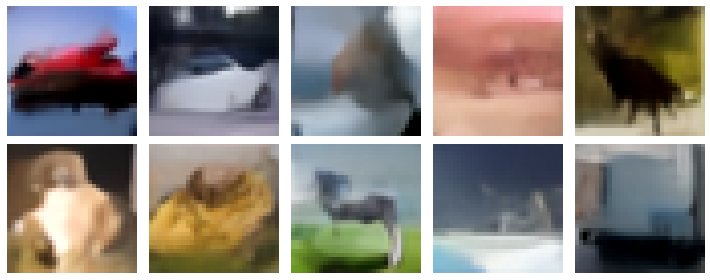

Epoch 202/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0539 - i_loss: 0.2072 - val_n_loss: 0.0525 - val_i_loss: 0.1532 - val_kid: 0.1810


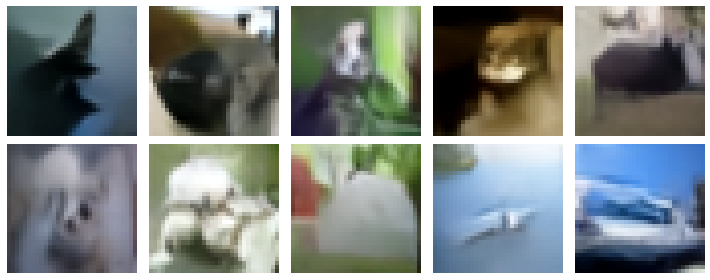

Epoch 203/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0536 - i_loss: 0.2063 - val_n_loss: 0.0515 - val_i_loss: 0.1599 - val_kid: 0.1769


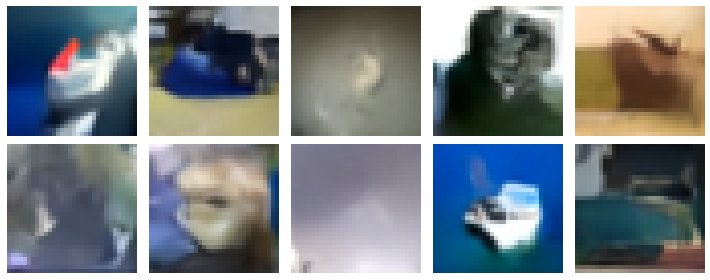

Epoch 204/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0538 - i_loss: 0.2073 - val_n_loss: 0.0522 - val_i_loss: 0.1565 - val_kid: 0.1734


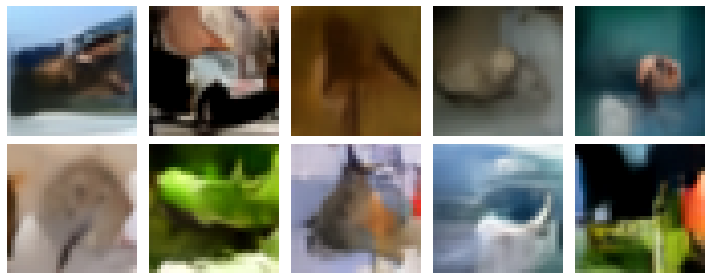

Epoch 205/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0542 - i_loss: 0.2041 - val_n_loss: 0.0518 - val_i_loss: 0.1548 - val_kid: 0.1793


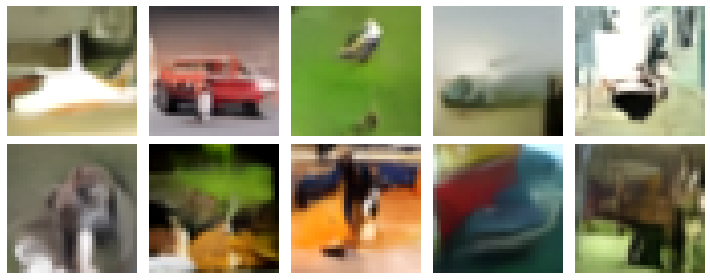

Epoch 206/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0542 - i_loss: 0.2075 - val_n_loss: 0.0520 - val_i_loss: 0.1567 - val_kid: 0.1876


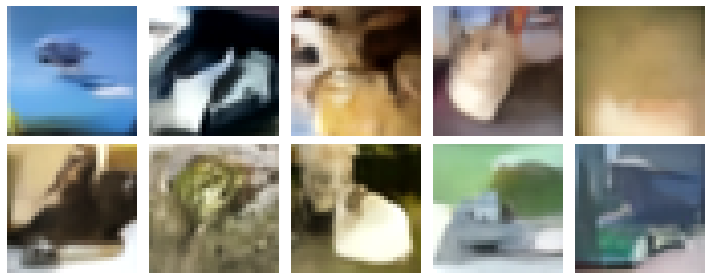

Epoch 207/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0541 - i_loss: 0.2067 - val_n_loss: 0.0531 - val_i_loss: 0.1540 - val_kid: 0.1725


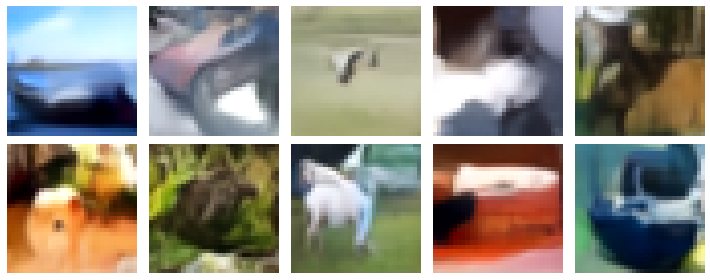

Epoch 208/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0545 - i_loss: 0.2064 - val_n_loss: 0.0528 - val_i_loss: 0.1513 - val_kid: 0.1870


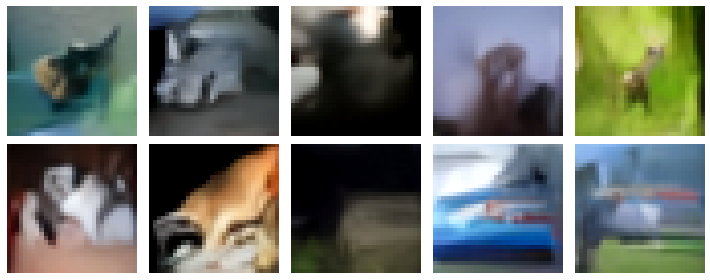

Epoch 209/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0539 - i_loss: 0.2049 - val_n_loss: 0.0521 - val_i_loss: 0.1527 - val_kid: 0.1736


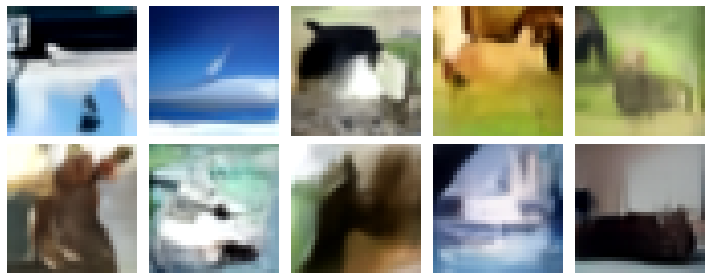

Epoch 210/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0543 - i_loss: 0.2085 - val_n_loss: 0.0522 - val_i_loss: 0.1561 - val_kid: 0.1783


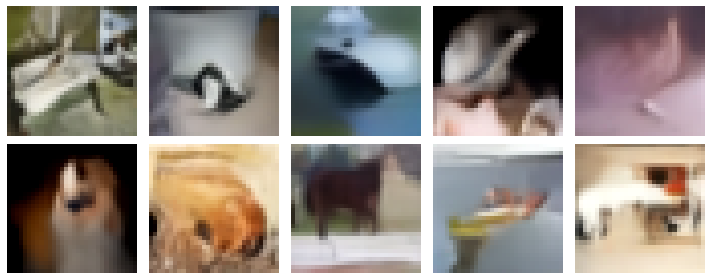

Epoch 211/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0537 - i_loss: 0.2063 - val_n_loss: 0.0521 - val_i_loss: 0.1554 - val_kid: 0.1814


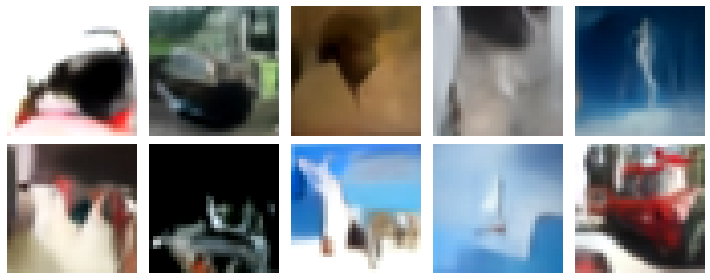

Epoch 212/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0538 - i_loss: 0.2057 - val_n_loss: 0.0520 - val_i_loss: 0.1545 - val_kid: 0.1723


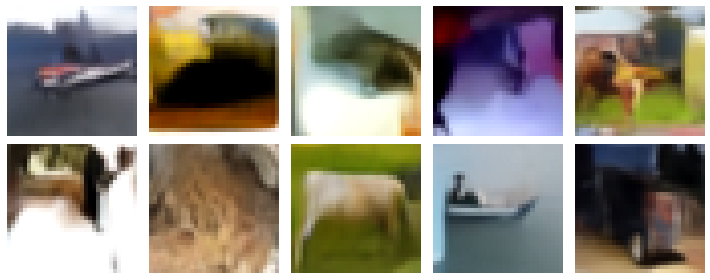

Epoch 213/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0541 - i_loss: 0.2044 - val_n_loss: 0.0520 - val_i_loss: 0.1575 - val_kid: 0.1701


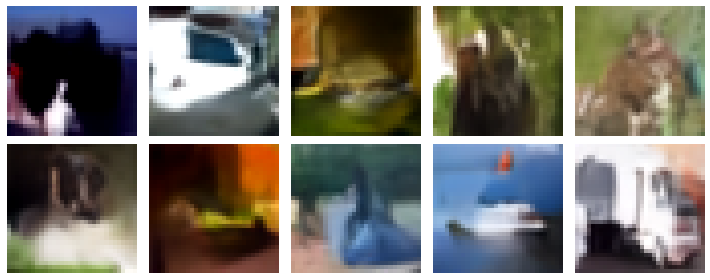

Epoch 214/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0539 - i_loss: 0.2113 - val_n_loss: 0.0521 - val_i_loss: 0.1598 - val_kid: 0.1784


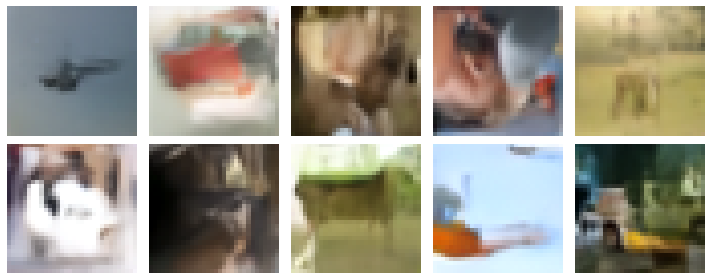

Epoch 215/500
703/703 [==============================] - 48s 68ms/step - n_loss: 0.0542 - i_loss: 0.2084 - val_n_loss: 0.0522 - val_i_loss: 0.1543 - val_kid: 0.1652


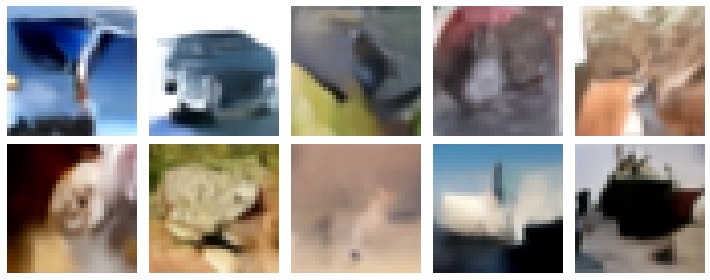

Epoch 216/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0542 - i_loss: 0.2040 - val_n_loss: 0.0517 - val_i_loss: 0.1583 - val_kid: 0.1766


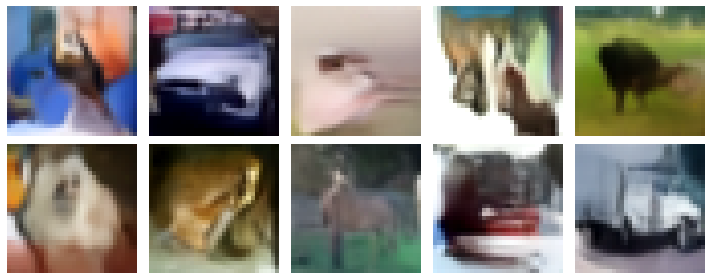

Epoch 217/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0540 - i_loss: 0.2071 - val_n_loss: 0.0525 - val_i_loss: 0.1588 - val_kid: 0.1651


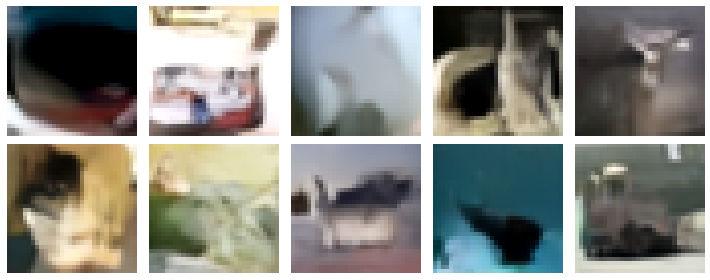

Epoch 218/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0543 - i_loss: 0.2041 - val_n_loss: 0.0528 - val_i_loss: 0.1555 - val_kid: 0.1707


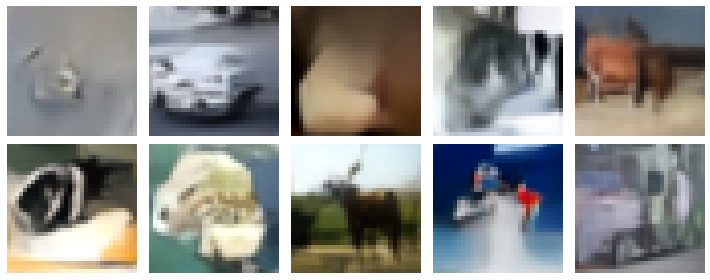

Epoch 219/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0542 - i_loss: 0.2089 - val_n_loss: 0.0514 - val_i_loss: 0.1545 - val_kid: 0.1685


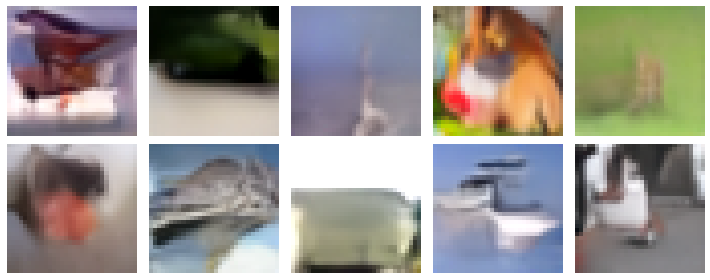

Epoch 220/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0542 - i_loss: 0.2071 - val_n_loss: 0.0524 - val_i_loss: 0.1527 - val_kid: 0.1628


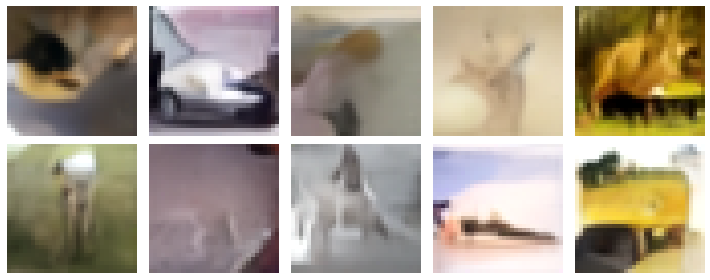

Epoch 221/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0538 - i_loss: 0.2065 - val_n_loss: 0.0524 - val_i_loss: 0.1514 - val_kid: 0.1724


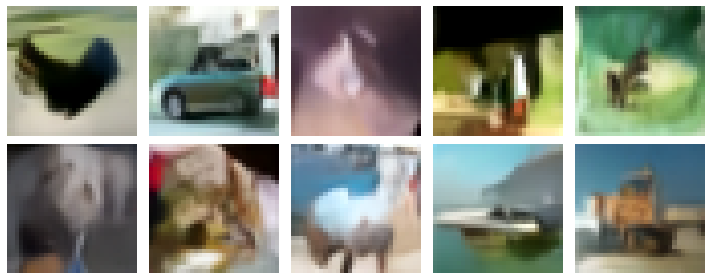

Epoch 222/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0540 - i_loss: 0.2084 - val_n_loss: 0.0522 - val_i_loss: 0.1517 - val_kid: 0.1647


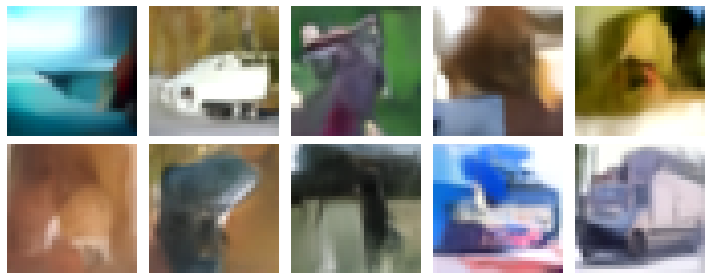

Epoch 223/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0541 - i_loss: 0.2070 - val_n_loss: 0.0515 - val_i_loss: 0.1643 - val_kid: 0.1634


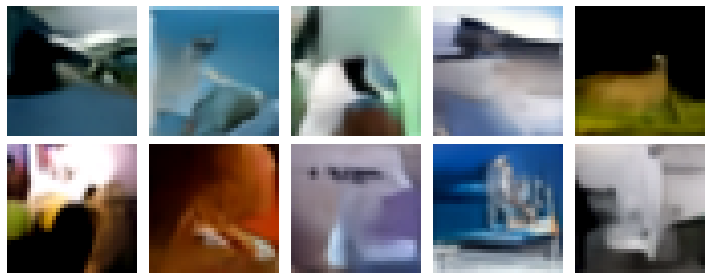

Epoch 224/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0542 - i_loss: 0.2054 - val_n_loss: 0.0516 - val_i_loss: 0.1547 - val_kid: 0.1745


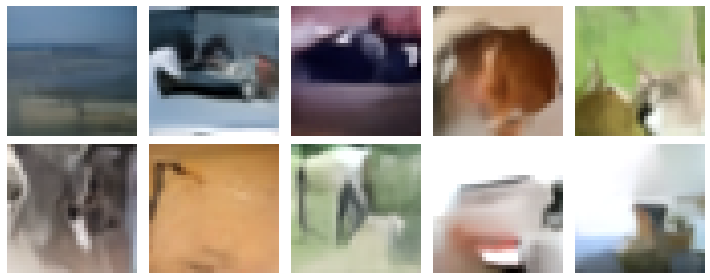

Epoch 225/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0538 - i_loss: 0.2097 - val_n_loss: 0.0523 - val_i_loss: 0.1562 - val_kid: 0.1710


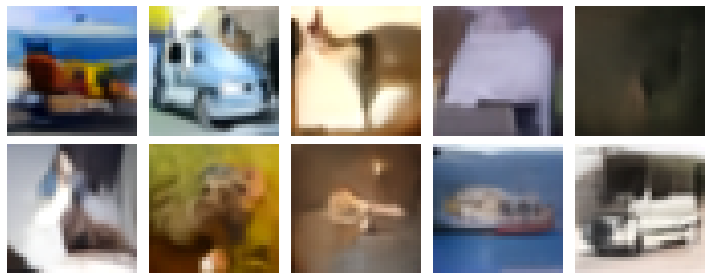

Epoch 226/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0538 - i_loss: 0.2090 - val_n_loss: 0.0524 - val_i_loss: 0.1542 - val_kid: 0.1736


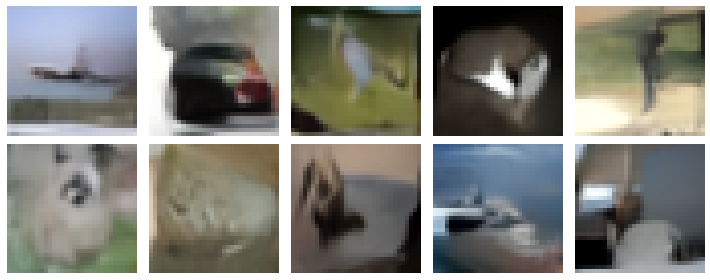

Epoch 227/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0541 - i_loss: 0.2055 - val_n_loss: 0.0520 - val_i_loss: 0.1592 - val_kid: 0.1769


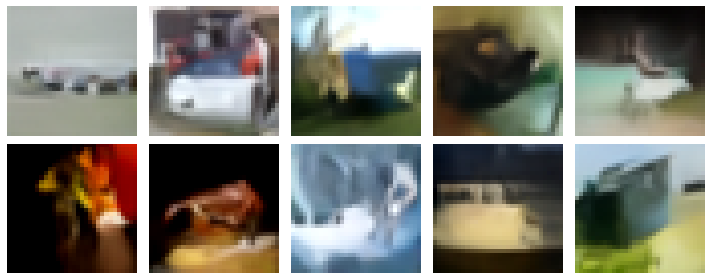

Epoch 228/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0541 - i_loss: 0.2026 - val_n_loss: 0.0514 - val_i_loss: 0.1635 - val_kid: 0.1738


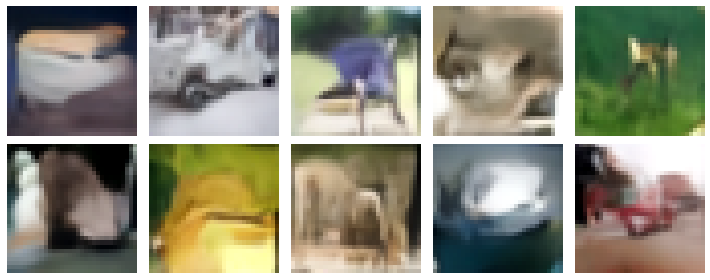

Epoch 229/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0543 - i_loss: 0.2096 - val_n_loss: 0.0511 - val_i_loss: 0.1579 - val_kid: 0.1814


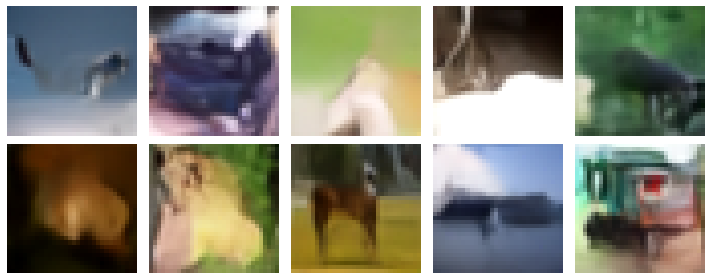

Epoch 230/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0540 - i_loss: 0.2070 - val_n_loss: 0.0515 - val_i_loss: 0.1576 - val_kid: 0.1777


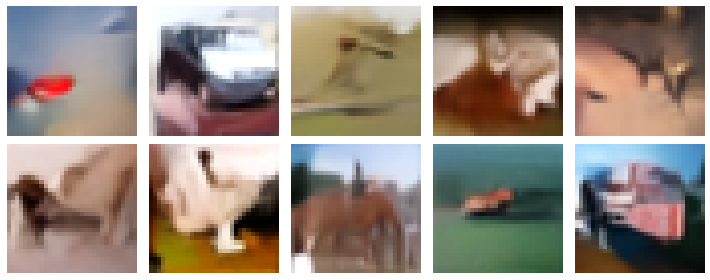

Epoch 231/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0543 - i_loss: 0.2066 - val_n_loss: 0.0514 - val_i_loss: 0.1547 - val_kid: 0.1743


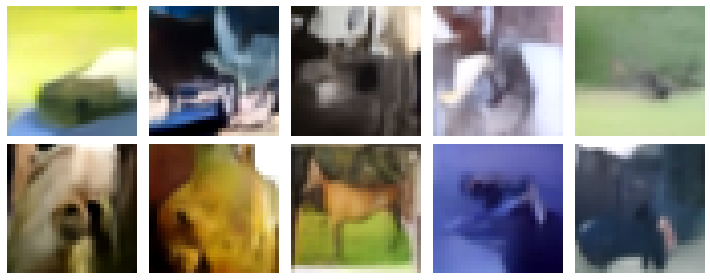

Epoch 232/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0537 - i_loss: 0.2081 - val_n_loss: 0.0516 - val_i_loss: 0.1609 - val_kid: 0.1592


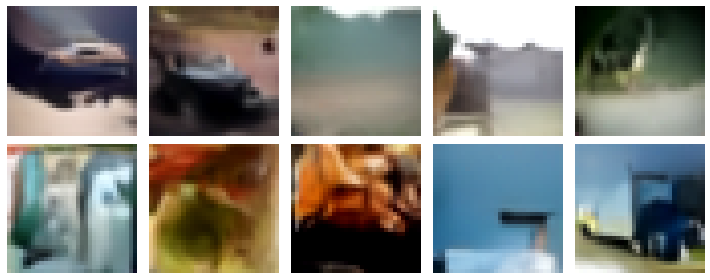

Epoch 233/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0538 - i_loss: 0.2078 - val_n_loss: 0.0519 - val_i_loss: 0.1580 - val_kid: 0.1658


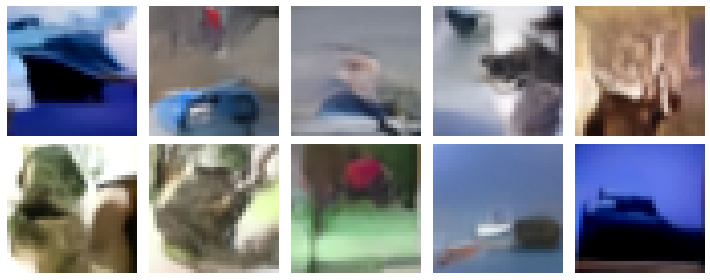

Epoch 234/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0538 - i_loss: 0.2071 - val_n_loss: 0.0525 - val_i_loss: 0.1553 - val_kid: 0.1676


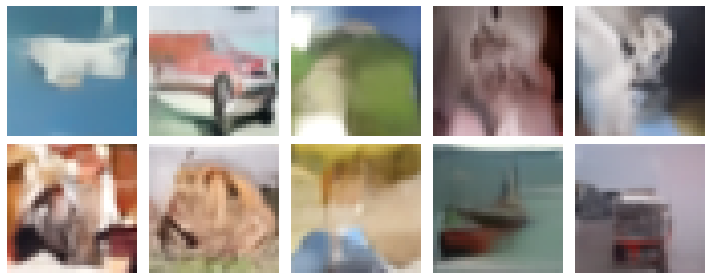

Epoch 235/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0542 - i_loss: 0.2062 - val_n_loss: 0.0524 - val_i_loss: 0.1556 - val_kid: 0.1729


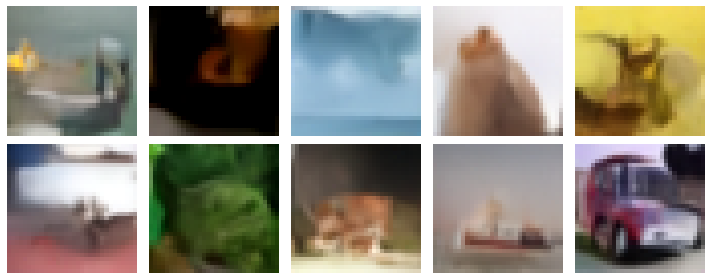

Epoch 236/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0542 - i_loss: 0.2100 - val_n_loss: 0.0523 - val_i_loss: 0.1541 - val_kid: 0.1735


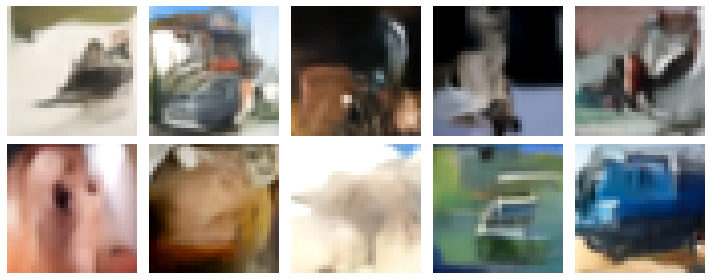

Epoch 237/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0540 - i_loss: 0.2027 - val_n_loss: 0.0525 - val_i_loss: 0.1542 - val_kid: 0.1564


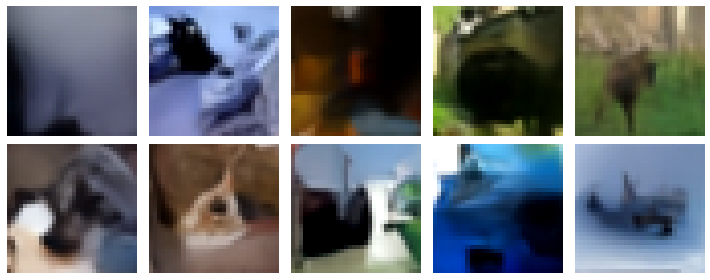

Epoch 238/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0541 - i_loss: 0.2119 - val_n_loss: 0.0520 - val_i_loss: 0.1597 - val_kid: 0.1716


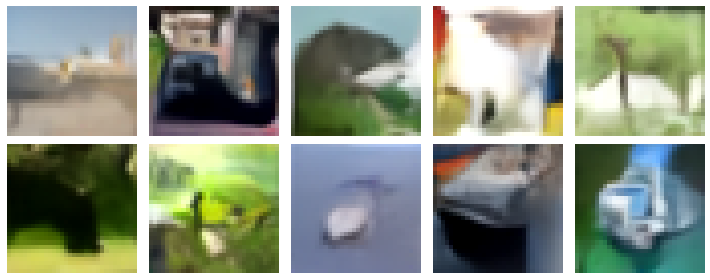

Epoch 239/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0543 - i_loss: 0.2046 - val_n_loss: 0.0524 - val_i_loss: 0.1531 - val_kid: 0.1742


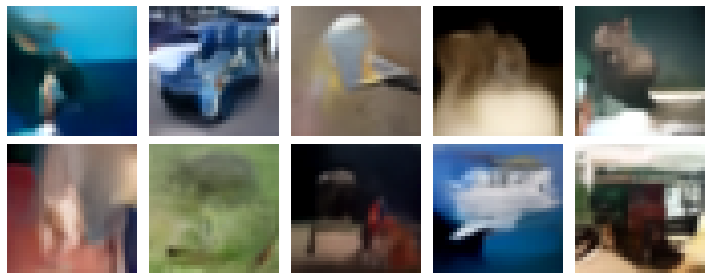

Epoch 240/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0541 - i_loss: 0.2034 - val_n_loss: 0.0519 - val_i_loss: 0.1553 - val_kid: 0.1676


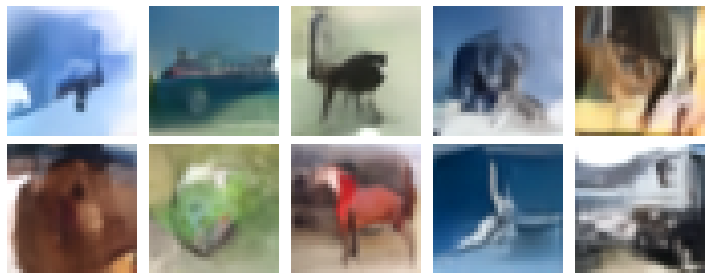

Epoch 241/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0539 - i_loss: 0.2051 - val_n_loss: 0.0516 - val_i_loss: 0.1575 - val_kid: 0.1802


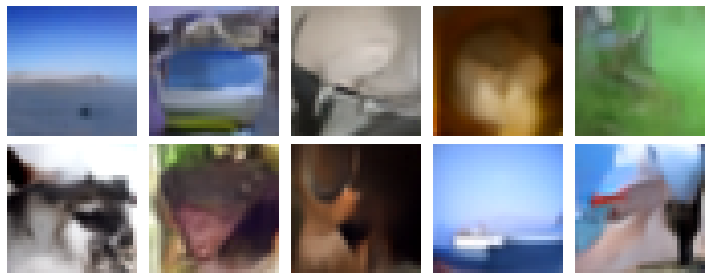

Epoch 242/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0540 - i_loss: 0.2070 - val_n_loss: 0.0521 - val_i_loss: 0.1540 - val_kid: 0.1766


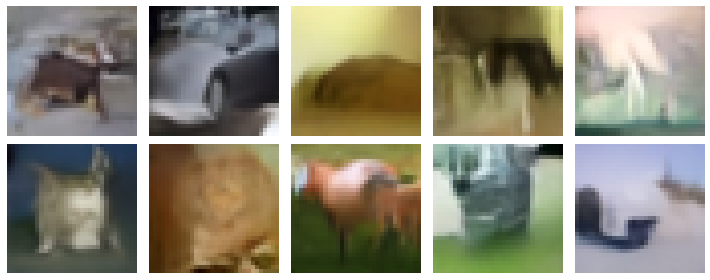

Epoch 243/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0540 - i_loss: 0.2086 - val_n_loss: 0.0521 - val_i_loss: 0.1535 - val_kid: 0.1696


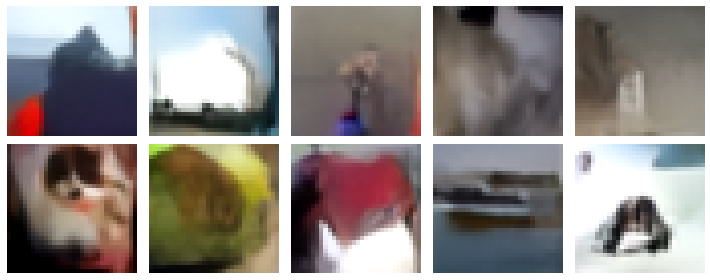

Epoch 244/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0536 - i_loss: 0.2046 - val_n_loss: 0.0527 - val_i_loss: 0.1548 - val_kid: 0.1657


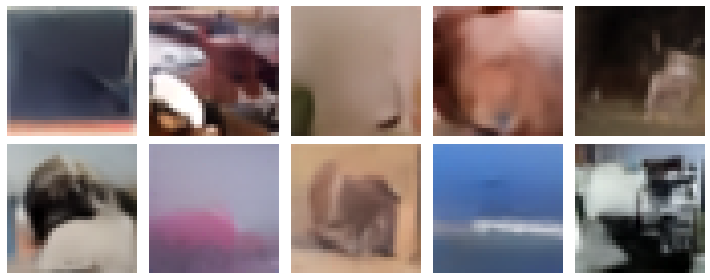

Epoch 245/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0539 - i_loss: 0.2107 - val_n_loss: 0.0517 - val_i_loss: 0.1589 - val_kid: 0.1659


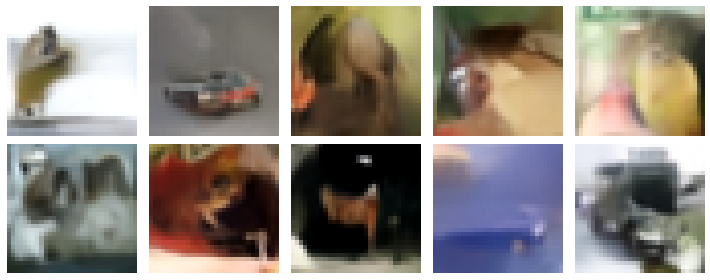

Epoch 246/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0539 - i_loss: 0.2077 - val_n_loss: 0.0520 - val_i_loss: 0.1551 - val_kid: 0.1714


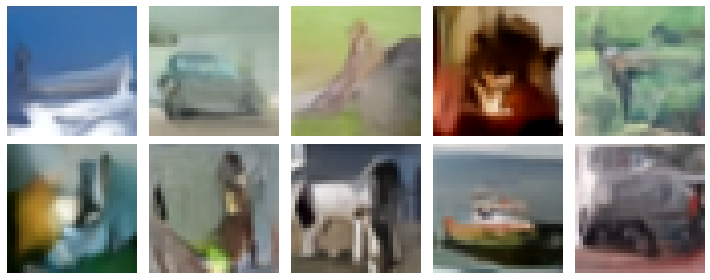

Epoch 247/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0542 - i_loss: 0.2093 - val_n_loss: 0.0526 - val_i_loss: 0.1520 - val_kid: 0.1720


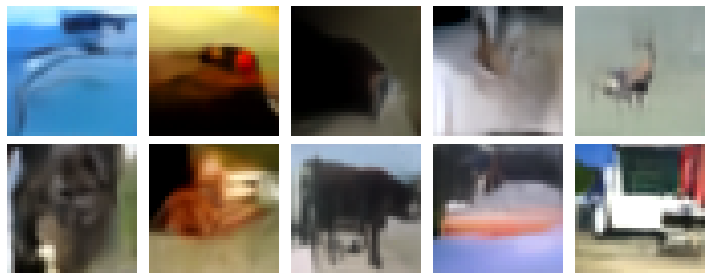

Epoch 248/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0542 - i_loss: 0.2066 - val_n_loss: 0.0528 - val_i_loss: 0.1557 - val_kid: 0.1752


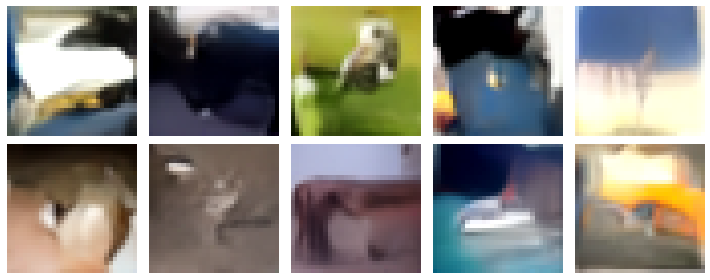

Epoch 249/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0537 - i_loss: 0.2108 - val_n_loss: 0.0520 - val_i_loss: 0.1546 - val_kid: 0.1729


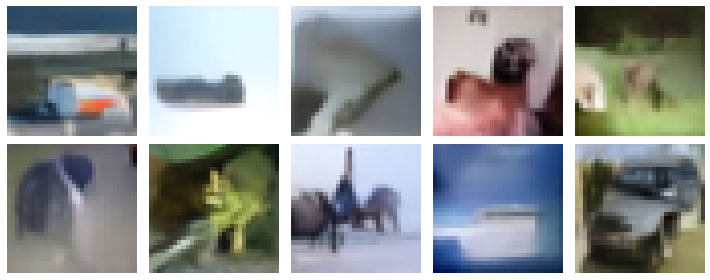

Epoch 250/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0543 - i_loss: 0.2040 - val_n_loss: 0.0516 - val_i_loss: 0.1563 - val_kid: 0.1710


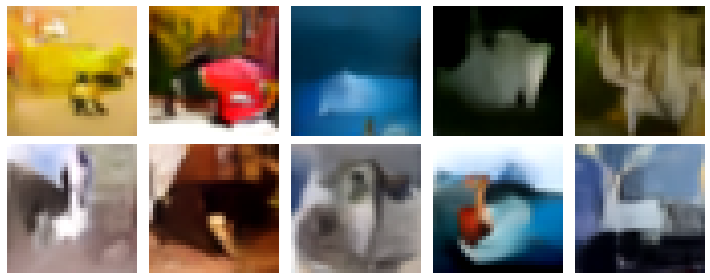

Epoch 251/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0541 - i_loss: 0.2064 - val_n_loss: 0.0525 - val_i_loss: 0.1562 - val_kid: 0.1761


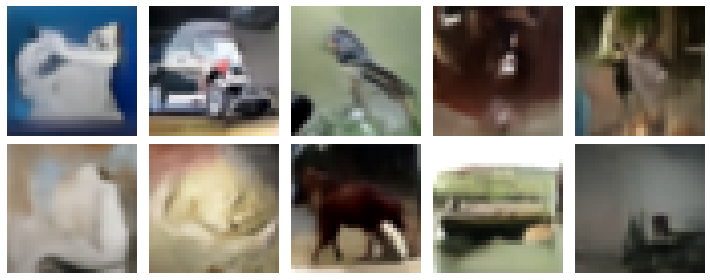

Epoch 252/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0542 - i_loss: 0.2094 - val_n_loss: 0.0520 - val_i_loss: 0.1588 - val_kid: 0.1669


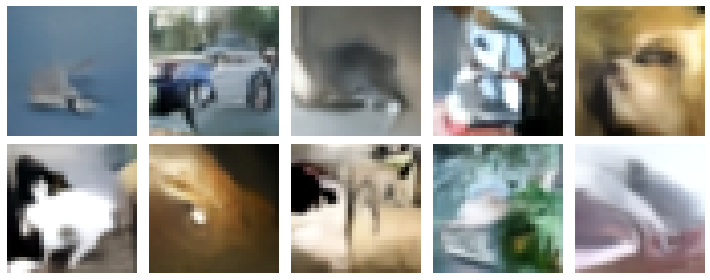

Epoch 253/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0541 - i_loss: 0.2043 - val_n_loss: 0.0524 - val_i_loss: 0.1558 - val_kid: 0.1615


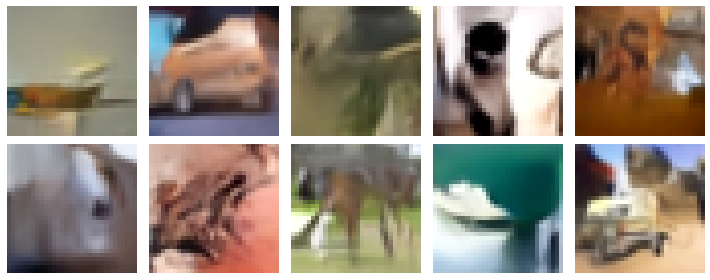

Epoch 254/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0543 - i_loss: 0.2069 - val_n_loss: 0.0522 - val_i_loss: 0.1517 - val_kid: 0.1548


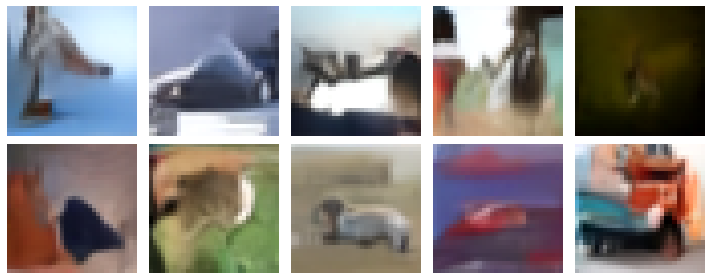

Epoch 255/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0541 - i_loss: 0.2058 - val_n_loss: 0.0518 - val_i_loss: 0.1570 - val_kid: 0.1675


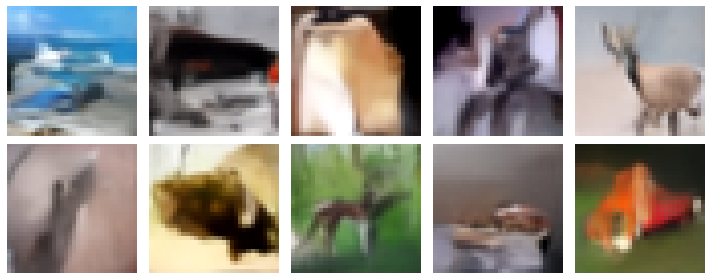

Epoch 256/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0539 - i_loss: 0.2100 - val_n_loss: 0.0525 - val_i_loss: 0.1524 - val_kid: 0.1709


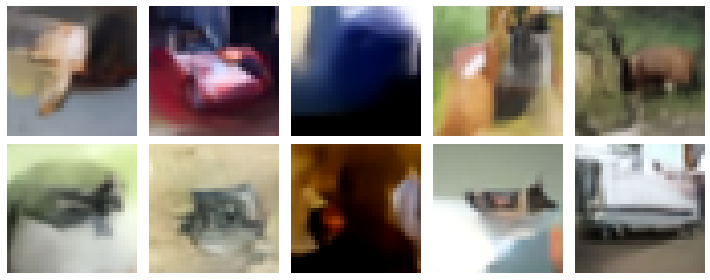

Epoch 257/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0539 - i_loss: 0.2077 - val_n_loss: 0.0516 - val_i_loss: 0.1565 - val_kid: 0.1696


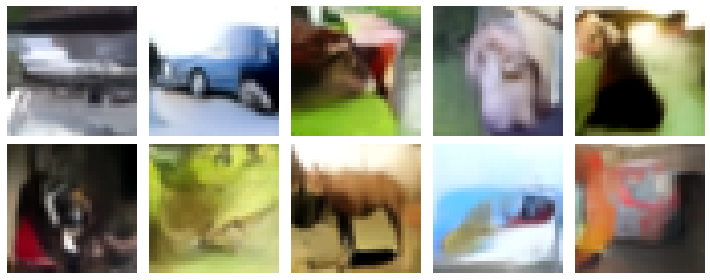

Epoch 258/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0541 - i_loss: 0.2071 - val_n_loss: 0.0520 - val_i_loss: 0.1542 - val_kid: 0.1589


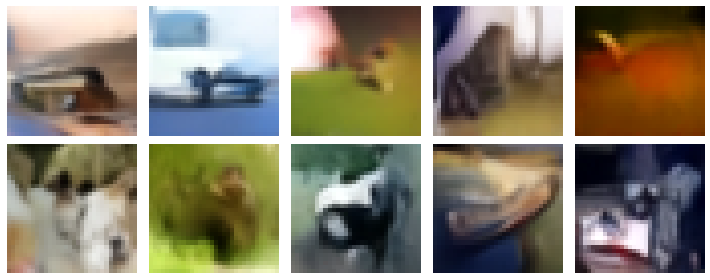

Epoch 259/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0541 - i_loss: 0.2061 - val_n_loss: 0.0519 - val_i_loss: 0.1570 - val_kid: 0.1692


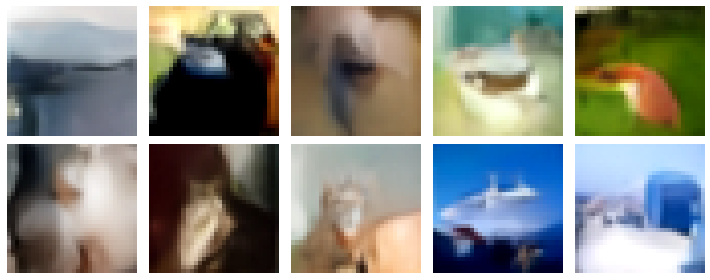

Epoch 260/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0539 - i_loss: 0.2109 - val_n_loss: 0.0528 - val_i_loss: 0.1522 - val_kid: 0.1714


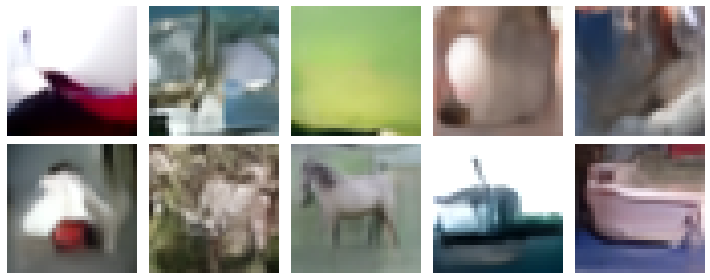

Epoch 261/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0542 - i_loss: 0.2087 - val_n_loss: 0.0519 - val_i_loss: 0.1591 - val_kid: 0.1613


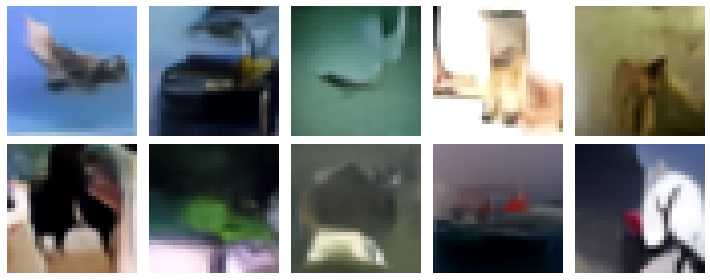

Epoch 262/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0539 - i_loss: 0.2094 - val_n_loss: 0.0523 - val_i_loss: 0.1554 - val_kid: 0.1595


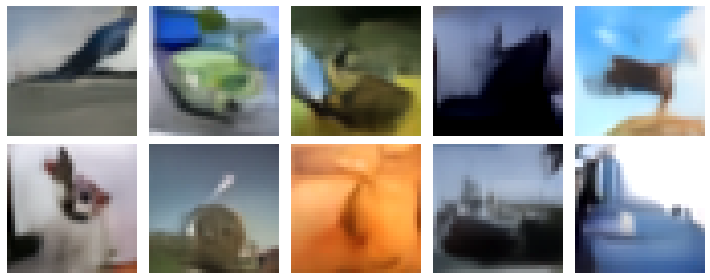

Epoch 263/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0541 - i_loss: 0.2119 - val_n_loss: 0.0517 - val_i_loss: 0.1530 - val_kid: 0.1690


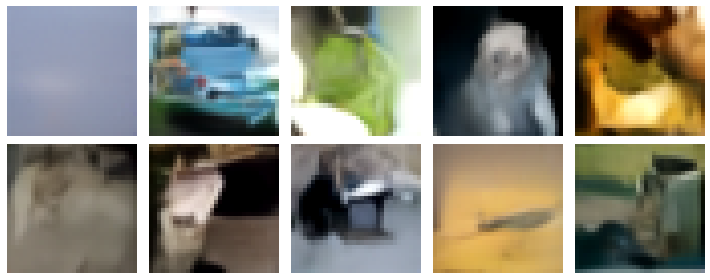

Epoch 264/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0542 - i_loss: 0.2078 - val_n_loss: 0.0529 - val_i_loss: 0.1546 - val_kid: 0.1616


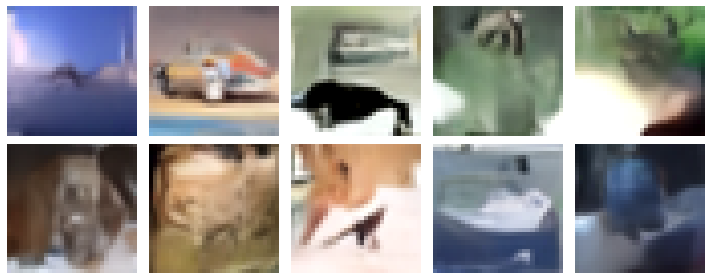

Epoch 265/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0540 - i_loss: 0.2037 - val_n_loss: 0.0505 - val_i_loss: 0.1590 - val_kid: 0.1682


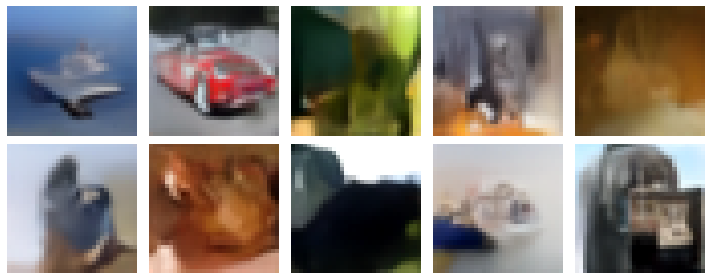

Epoch 266/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0539 - i_loss: 0.2060 - val_n_loss: 0.0523 - val_i_loss: 0.1569 - val_kid: 0.1594


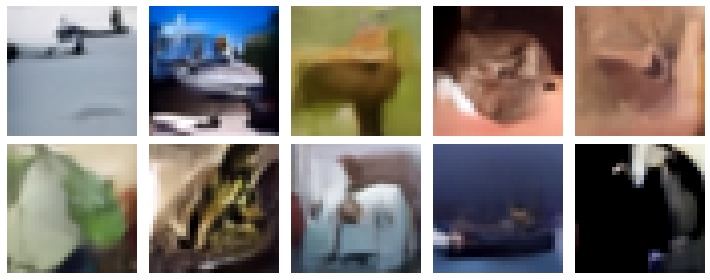

Epoch 267/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0540 - i_loss: 0.2037 - val_n_loss: 0.0517 - val_i_loss: 0.1582 - val_kid: 0.1566


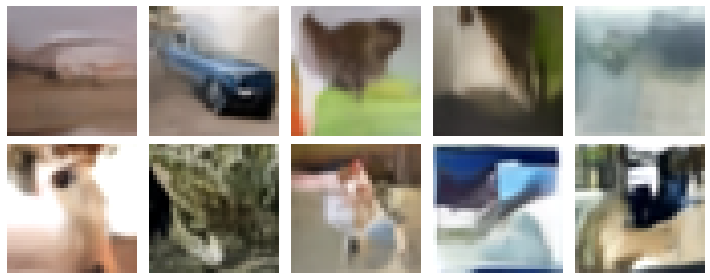

Epoch 268/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0540 - i_loss: 0.2070 - val_n_loss: 0.0525 - val_i_loss: 0.1538 - val_kid: 0.1637


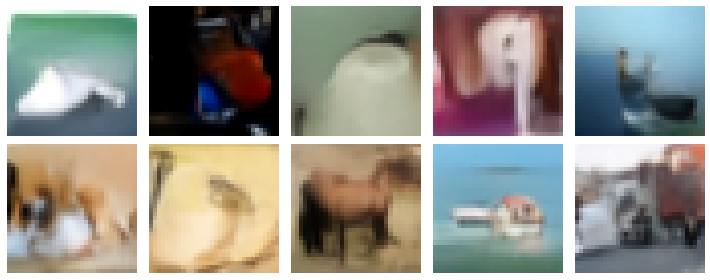

Epoch 269/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0539 - i_loss: 0.2070 - val_n_loss: 0.0520 - val_i_loss: 0.1554 - val_kid: 0.1598


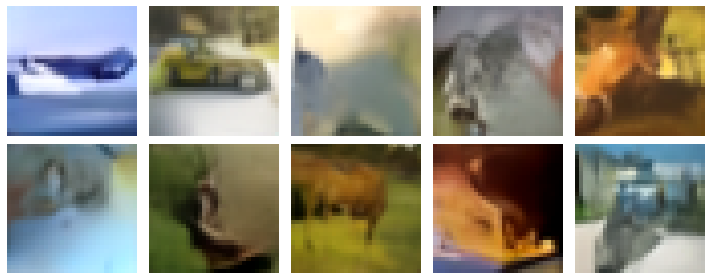

Epoch 270/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0541 - i_loss: 0.2060 - val_n_loss: 0.0522 - val_i_loss: 0.1583 - val_kid: 0.1620


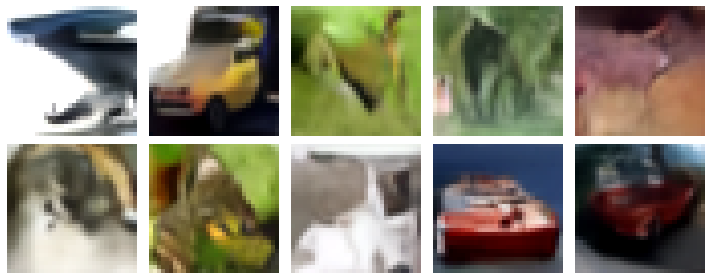

Epoch 271/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0538 - i_loss: 0.2080 - val_n_loss: 0.0509 - val_i_loss: 0.1583 - val_kid: 0.1724


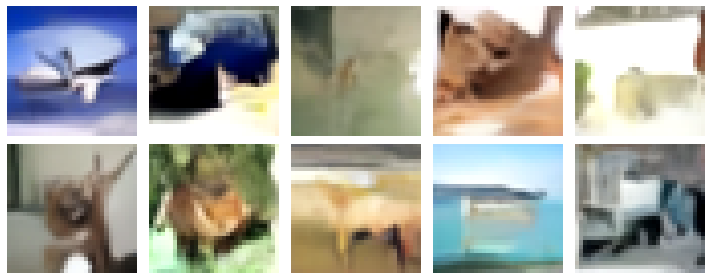

Epoch 272/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0539 - i_loss: 0.2038 - val_n_loss: 0.0516 - val_i_loss: 0.1566 - val_kid: 0.1715


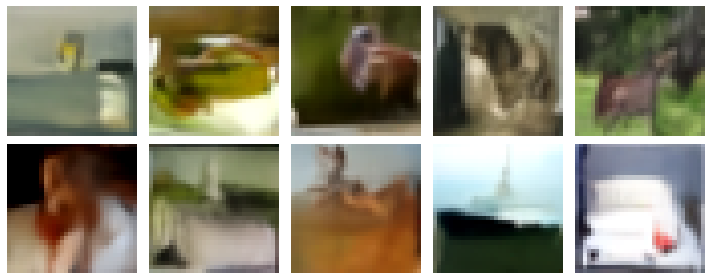

Epoch 273/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0540 - i_loss: 0.2066 - val_n_loss: 0.0512 - val_i_loss: 0.1593 - val_kid: 0.1708


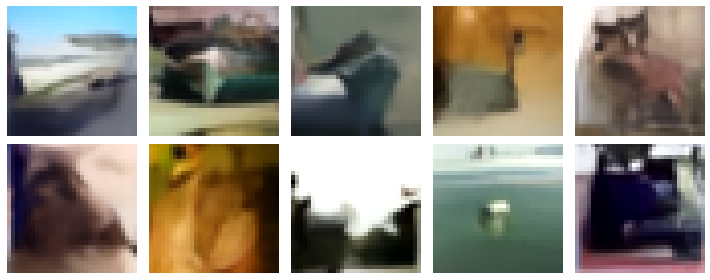

Epoch 274/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0539 - i_loss: 0.2075 - val_n_loss: 0.0517 - val_i_loss: 0.1549 - val_kid: 0.1685


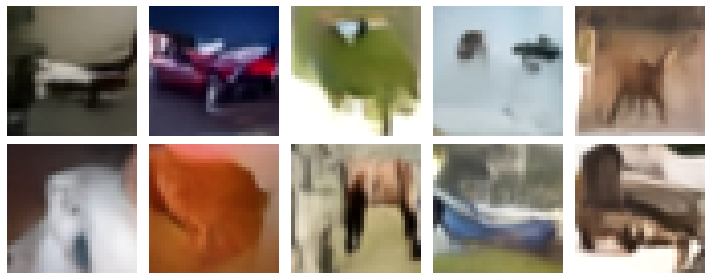

Epoch 275/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0537 - i_loss: 0.2061 - val_n_loss: 0.0521 - val_i_loss: 0.1541 - val_kid: 0.1628


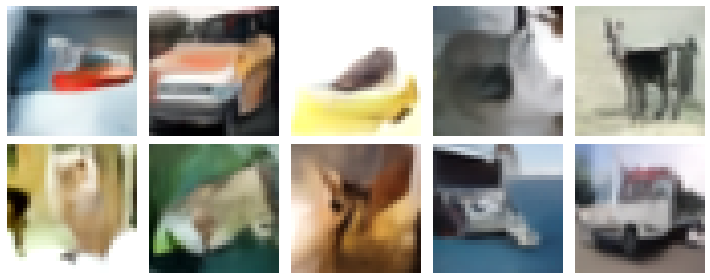

Epoch 276/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0542 - i_loss: 0.2074 - val_n_loss: 0.0511 - val_i_loss: 0.1575 - val_kid: 0.1590


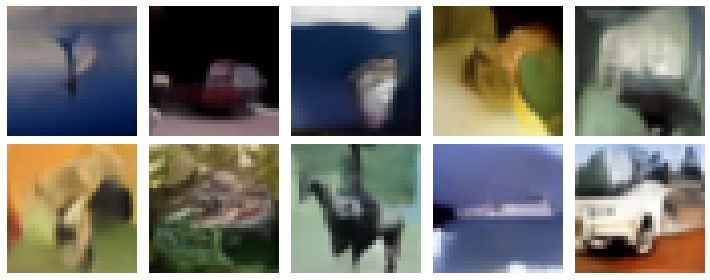

Epoch 277/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0538 - i_loss: 0.2108 - val_n_loss: 0.0513 - val_i_loss: 0.1558 - val_kid: 0.1649


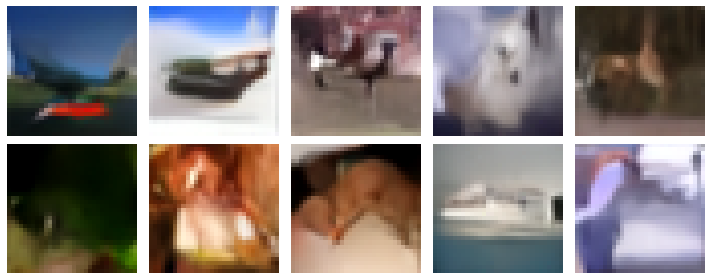

Epoch 278/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0539 - i_loss: 0.2060 - val_n_loss: 0.0512 - val_i_loss: 0.1583 - val_kid: 0.1666


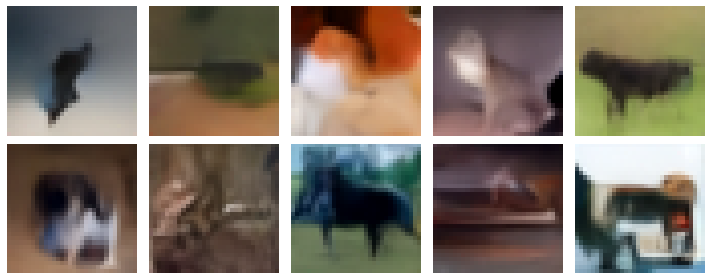

Epoch 279/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0539 - i_loss: 0.2041 - val_n_loss: 0.0522 - val_i_loss: 0.1549 - val_kid: 0.1650


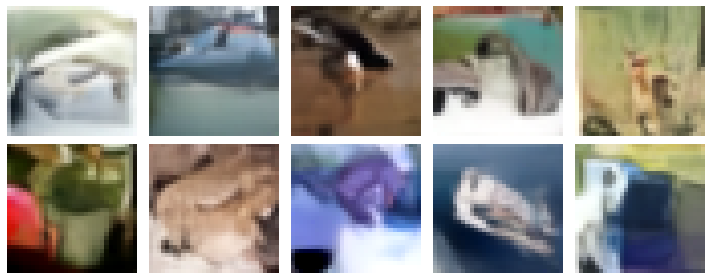

Epoch 280/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0539 - i_loss: 0.2082 - val_n_loss: 0.0525 - val_i_loss: 0.1524 - val_kid: 0.1639


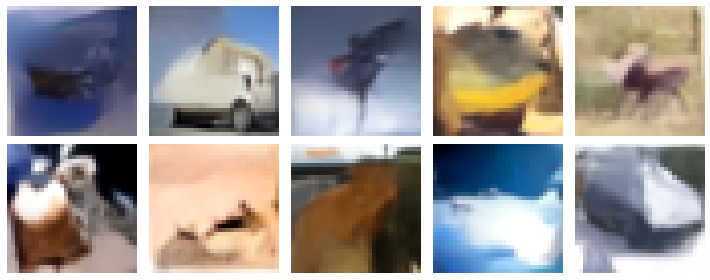

Epoch 281/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0540 - i_loss: 0.2089 - val_n_loss: 0.0512 - val_i_loss: 0.1628 - val_kid: 0.1683


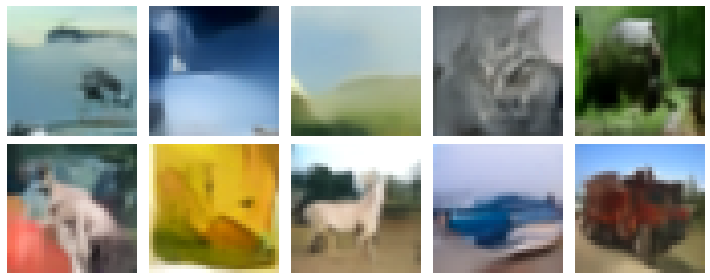

Epoch 282/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0538 - i_loss: 0.2108 - val_n_loss: 0.0517 - val_i_loss: 0.1546 - val_kid: 0.1750


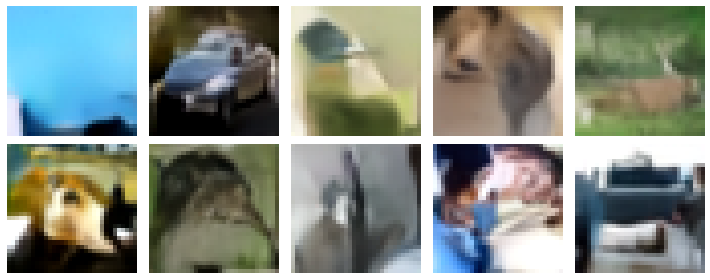

Epoch 283/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0540 - i_loss: 0.2101 - val_n_loss: 0.0524 - val_i_loss: 0.1513 - val_kid: 0.1706


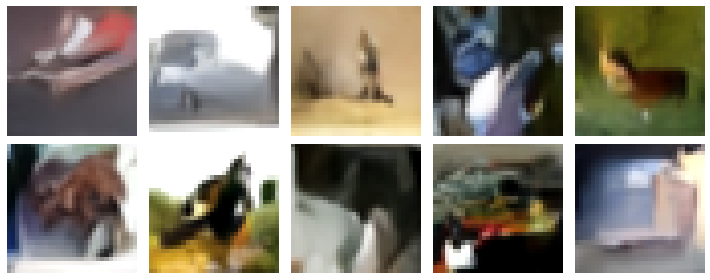

Epoch 284/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0536 - i_loss: 0.2081 - val_n_loss: 0.0512 - val_i_loss: 0.1584 - val_kid: 0.1635


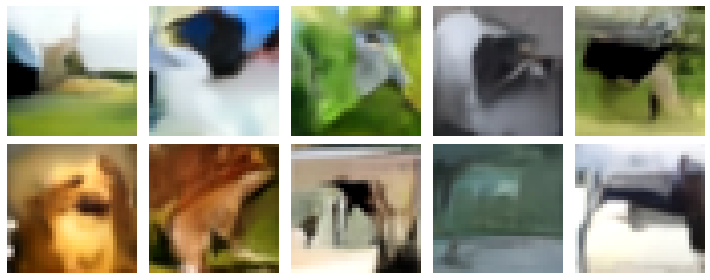

Epoch 285/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0539 - i_loss: 0.2044 - val_n_loss: 0.0516 - val_i_loss: 0.1596 - val_kid: 0.1663


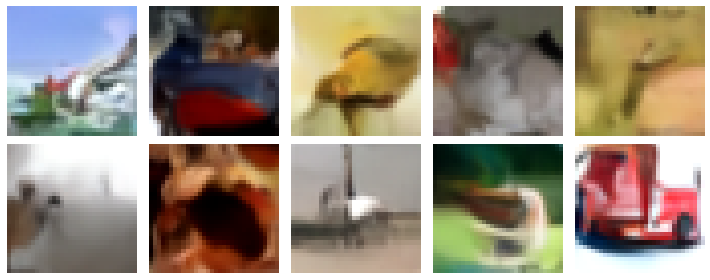

Epoch 286/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0539 - i_loss: 0.2076 - val_n_loss: 0.0515 - val_i_loss: 0.1579 - val_kid: 0.1611


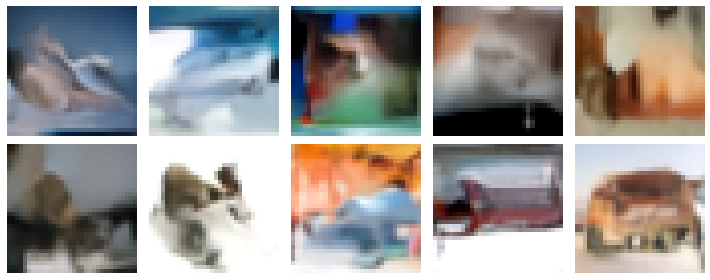

Epoch 287/500
703/703 [==============================] - 48s 68ms/step - n_loss: 0.0538 - i_loss: 0.2087 - val_n_loss: 0.0523 - val_i_loss: 0.1541 - val_kid: 0.1658


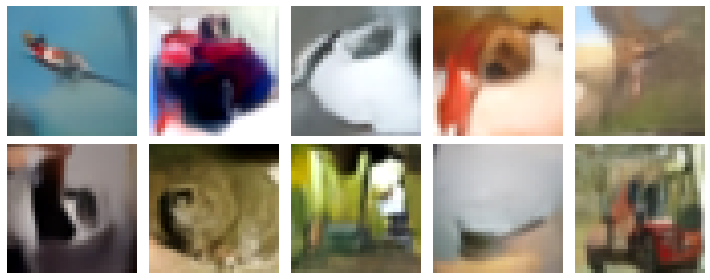

Epoch 288/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0537 - i_loss: 0.2054 - val_n_loss: 0.0516 - val_i_loss: 0.1555 - val_kid: 0.1585


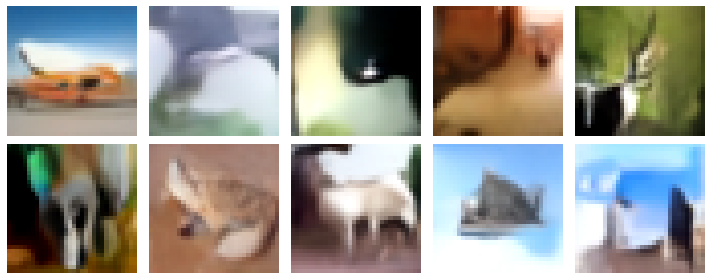

Epoch 289/500
703/703 [==============================] - 48s 69ms/step - n_loss: 0.0540 - i_loss: 0.2078 - val_n_loss: 0.0518 - val_i_loss: 0.1574 - val_kid: 0.1639


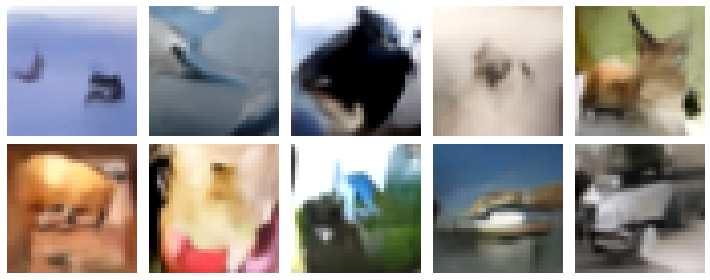

Epoch 290/500
703/703 [==============================] - 48s 68ms/step - n_loss: 0.0536 - i_loss: 0.2101 - val_n_loss: 0.0515 - val_i_loss: 0.1601 - val_kid: 0.1596


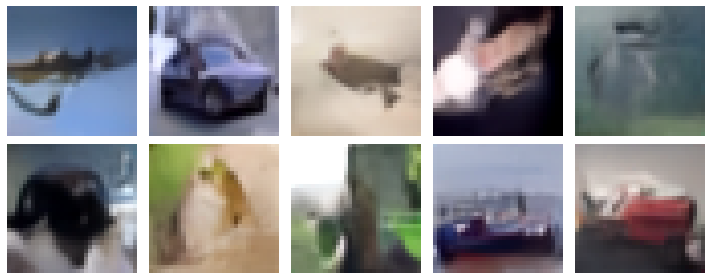

Epoch 291/500
703/703 [==============================] - 48s 68ms/step - n_loss: 0.0542 - i_loss: 0.2048 - val_n_loss: 0.0510 - val_i_loss: 0.1583 - val_kid: 0.1524


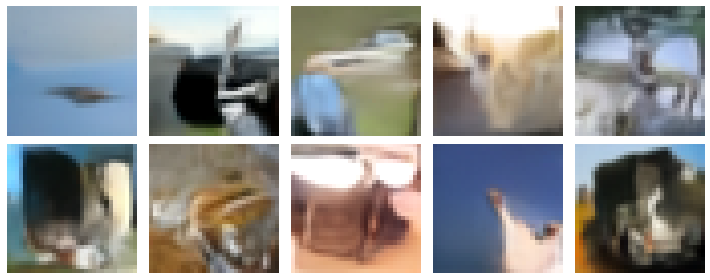

Epoch 292/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0539 - i_loss: 0.2127 - val_n_loss: 0.0514 - val_i_loss: 0.1609 - val_kid: 0.1564


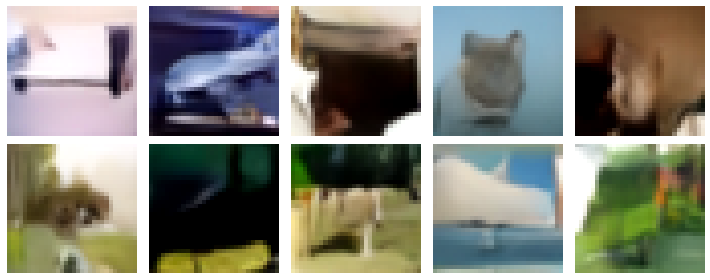

Epoch 293/500
703/703 [==============================] - 47s 68ms/step - n_loss: 0.0539 - i_loss: 0.2056 - val_n_loss: 0.0524 - val_i_loss: 0.1592 - val_kid: 0.1688


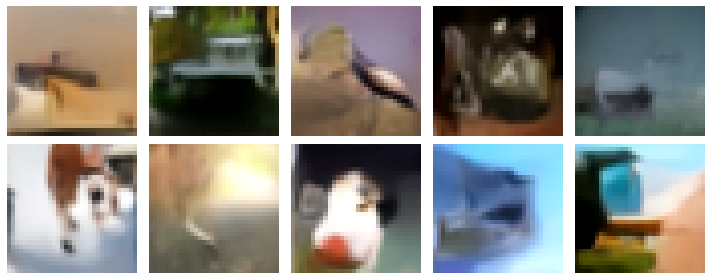

Epoch 294/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0535 - i_loss: 0.2093 - val_n_loss: 0.0508 - val_i_loss: 0.1622 - val_kid: 0.1691


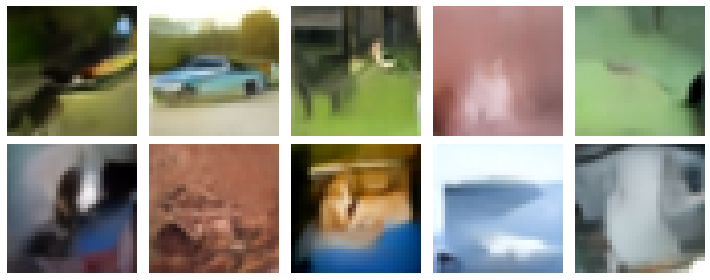

Epoch 295/500
703/703 [==============================] - 48s 68ms/step - n_loss: 0.0537 - i_loss: 0.2040 - val_n_loss: 0.0509 - val_i_loss: 0.1582 - val_kid: 0.1704


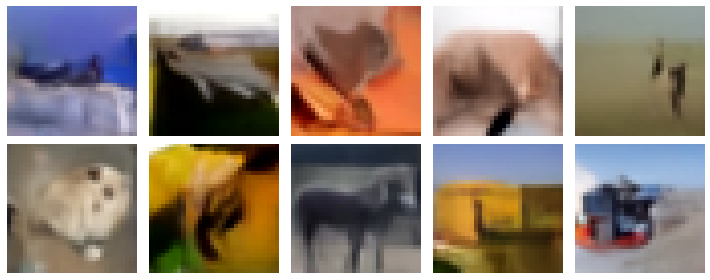

Epoch 296/500
703/703 [==============================] - 48s 68ms/step - n_loss: 0.0541 - i_loss: 0.2080 - val_n_loss: 0.0525 - val_i_loss: 0.1595 - val_kid: 0.1750


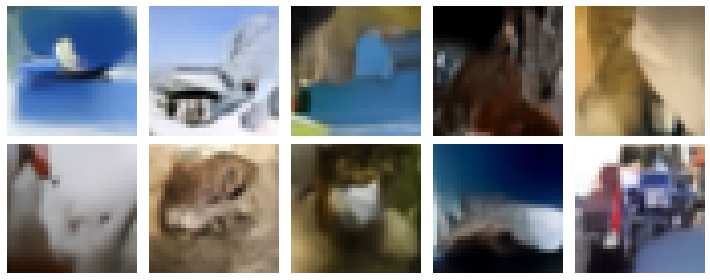

Epoch 297/500
703/703 [==============================] - 48s 68ms/step - n_loss: 0.0536 - i_loss: 0.2088 - val_n_loss: 0.0522 - val_i_loss: 0.1607 - val_kid: 0.1690


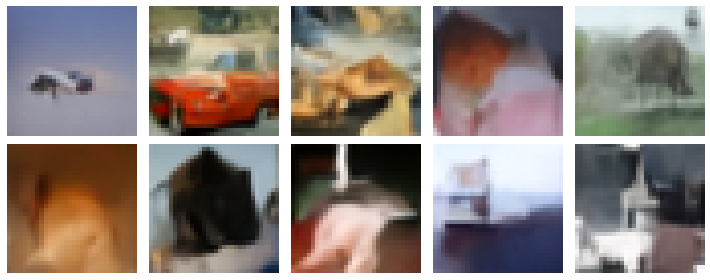

Epoch 298/500
703/703 [==============================] - 48s 68ms/step - n_loss: 0.0539 - i_loss: 0.2072 - val_n_loss: 0.0524 - val_i_loss: 0.1558 - val_kid: 0.1635


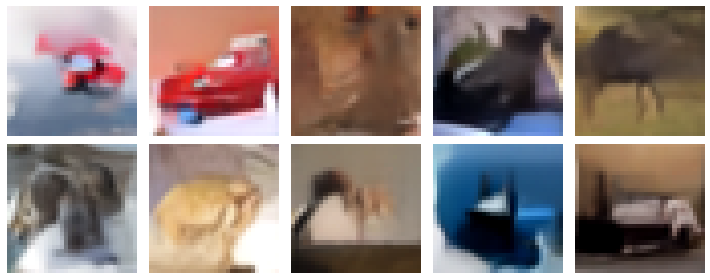

Epoch 299/500
703/703 [==============================] - 47s 68ms/step - n_loss: 0.0535 - i_loss: 0.2080 - val_n_loss: 0.0524 - val_i_loss: 0.1538 - val_kid: 0.1586


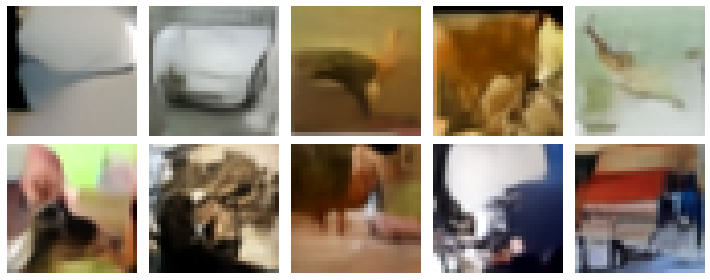

Epoch 300/500
703/703 [==============================] - 48s 68ms/step - n_loss: 0.0540 - i_loss: 0.2041 - val_n_loss: 0.0523 - val_i_loss: 0.1519 - val_kid: 0.1552


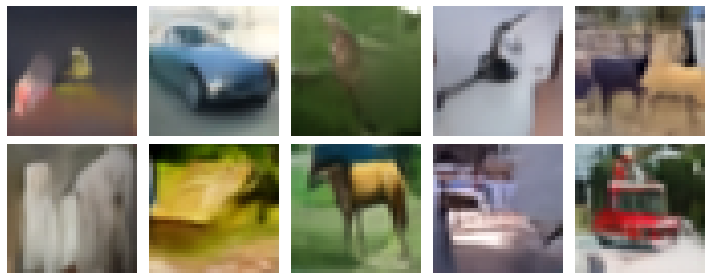

Epoch 301/500
703/703 [==============================] - 48s 68ms/step - n_loss: 0.0540 - i_loss: 0.2027 - val_n_loss: 0.0517 - val_i_loss: 0.1563 - val_kid: 0.1614


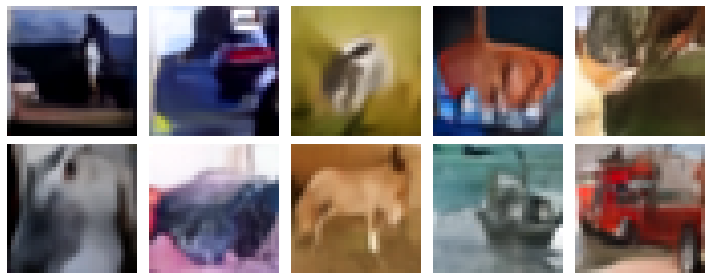

Epoch 302/500
703/703 [==============================] - 48s 68ms/step - n_loss: 0.0539 - i_loss: 0.2071 - val_n_loss: 0.0518 - val_i_loss: 0.1566 - val_kid: 0.1633


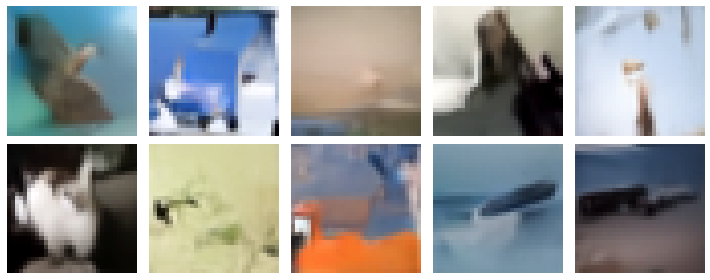

Epoch 303/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0543 - i_loss: 0.2047 - val_n_loss: 0.0514 - val_i_loss: 0.1574 - val_kid: 0.1563


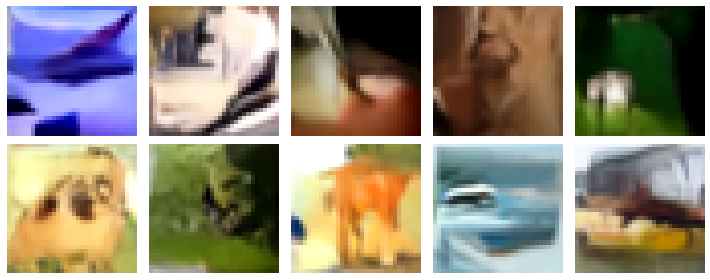

Epoch 304/500
703/703 [==============================] - 47s 68ms/step - n_loss: 0.0540 - i_loss: 0.2064 - val_n_loss: 0.0524 - val_i_loss: 0.1550 - val_kid: 0.1592


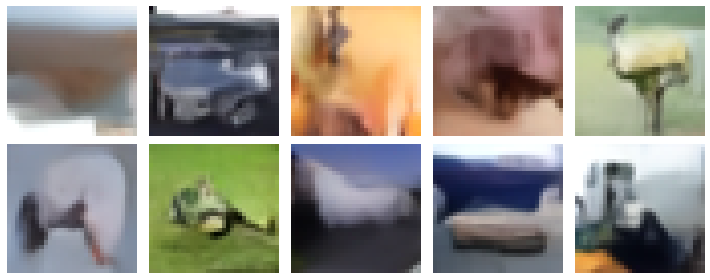

Epoch 305/500
703/703 [==============================] - 47s 68ms/step - n_loss: 0.0545 - i_loss: 0.2042 - val_n_loss: 0.0516 - val_i_loss: 0.1575 - val_kid: 0.1685


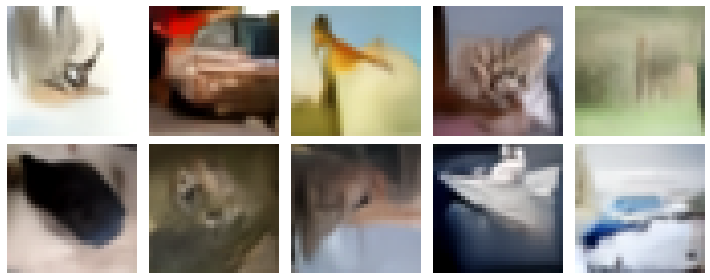

Epoch 306/500
703/703 [==============================] - 48s 68ms/step - n_loss: 0.0537 - i_loss: 0.2037 - val_n_loss: 0.0522 - val_i_loss: 0.1518 - val_kid: 0.1559


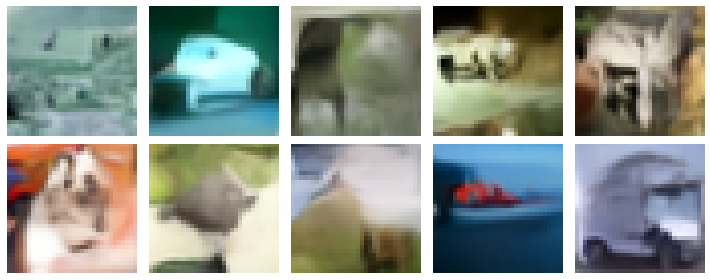

Epoch 307/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0538 - i_loss: 0.2093 - val_n_loss: 0.0516 - val_i_loss: 0.1561 - val_kid: 0.1696


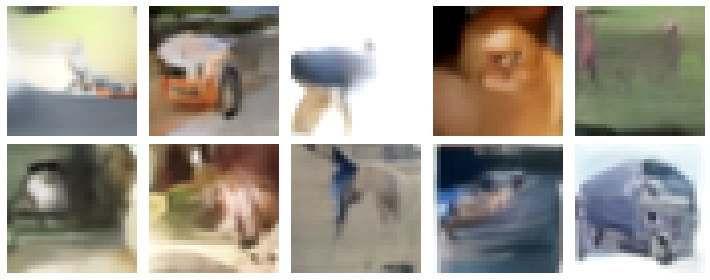

Epoch 308/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0539 - i_loss: 0.2029 - val_n_loss: 0.0506 - val_i_loss: 0.1616 - val_kid: 0.1605


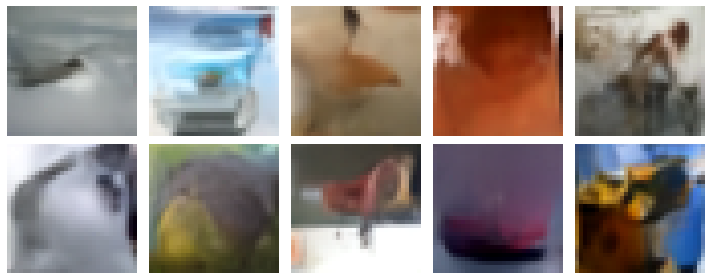

Epoch 309/500
703/703 [==============================] - 47s 68ms/step - n_loss: 0.0538 - i_loss: 0.2069 - val_n_loss: 0.0516 - val_i_loss: 0.1520 - val_kid: 0.1697


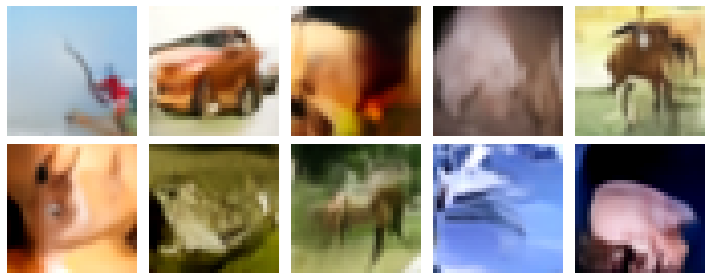

Epoch 310/500
703/703 [==============================] - 48s 68ms/step - n_loss: 0.0538 - i_loss: 0.2104 - val_n_loss: 0.0514 - val_i_loss: 0.1620 - val_kid: 0.1684


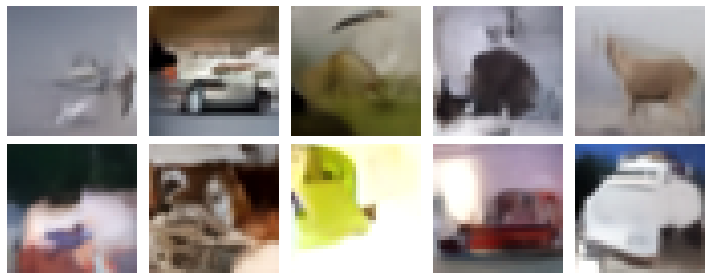

Epoch 311/500
703/703 [==============================] - 47s 68ms/step - n_loss: 0.0539 - i_loss: 0.2092 - val_n_loss: 0.0519 - val_i_loss: 0.1512 - val_kid: 0.1591


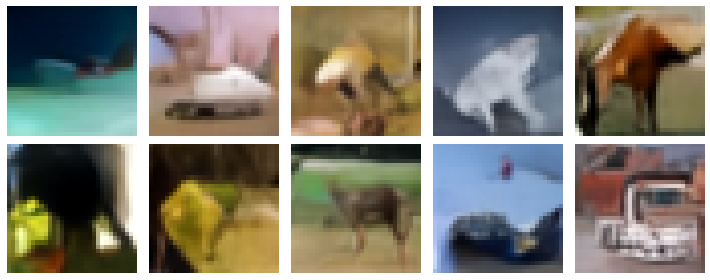

Epoch 312/500
703/703 [==============================] - 48s 68ms/step - n_loss: 0.0539 - i_loss: 0.2067 - val_n_loss: 0.0521 - val_i_loss: 0.1543 - val_kid: 0.1611


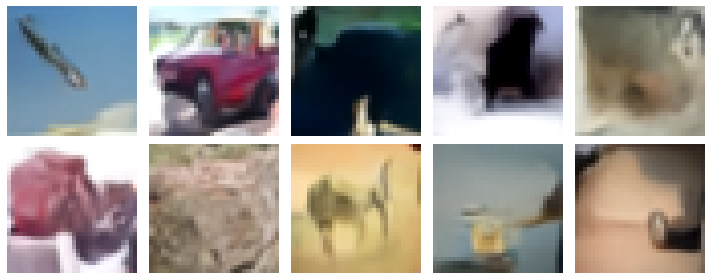

Epoch 313/500
703/703 [==============================] - 47s 68ms/step - n_loss: 0.0540 - i_loss: 0.2120 - val_n_loss: 0.0513 - val_i_loss: 0.1599 - val_kid: 0.1697


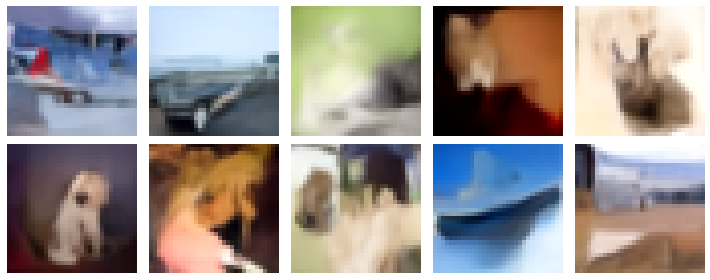

Epoch 314/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0537 - i_loss: 0.2048 - val_n_loss: 0.0510 - val_i_loss: 0.1597 - val_kid: 0.1765


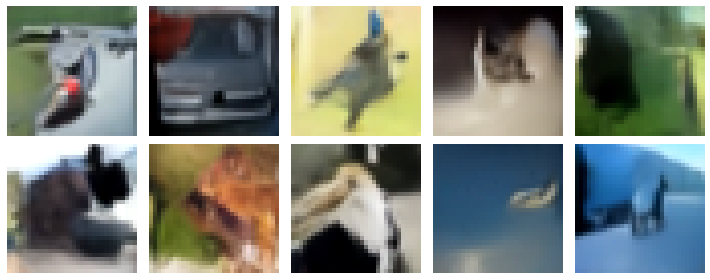

Epoch 315/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0540 - i_loss: 0.2091 - val_n_loss: 0.0510 - val_i_loss: 0.1584 - val_kid: 0.1676


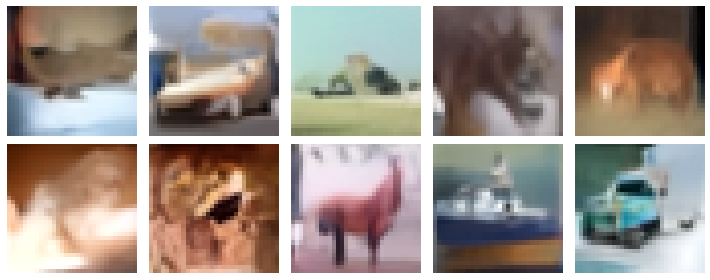

Epoch 316/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0539 - i_loss: 0.2078 - val_n_loss: 0.0524 - val_i_loss: 0.1561 - val_kid: 0.1635


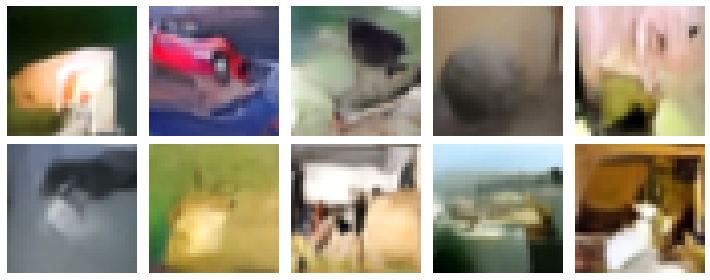

Epoch 317/500
703/703 [==============================] - 47s 68ms/step - n_loss: 0.0540 - i_loss: 0.2054 - val_n_loss: 0.0523 - val_i_loss: 0.1564 - val_kid: 0.1640


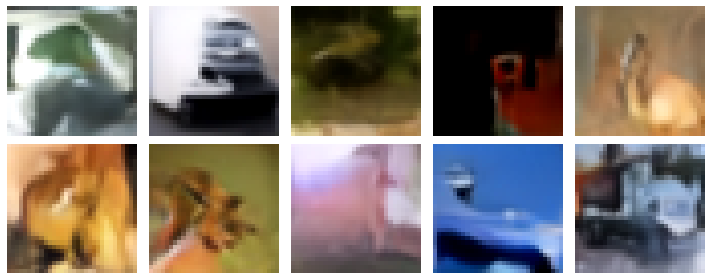

Epoch 318/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0538 - i_loss: 0.2038 - val_n_loss: 0.0525 - val_i_loss: 0.1512 - val_kid: 0.1566


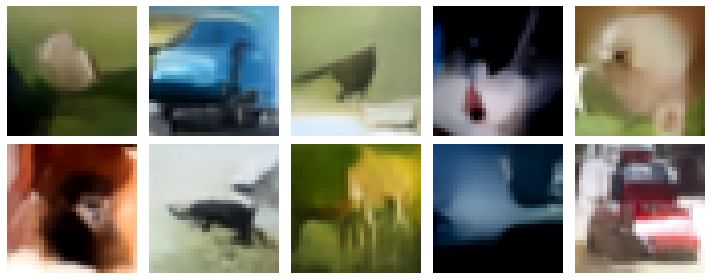

Epoch 319/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0538 - i_loss: 0.2114 - val_n_loss: 0.0518 - val_i_loss: 0.1534 - val_kid: 0.1716


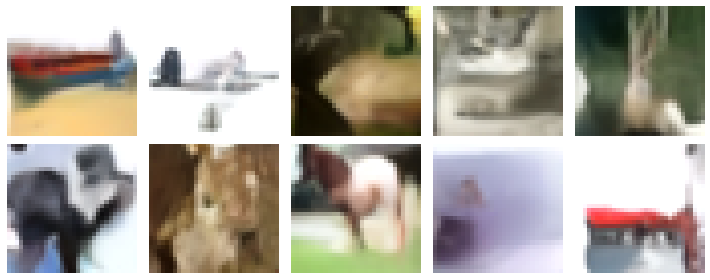

Epoch 320/500
703/703 [==============================] - 47s 68ms/step - n_loss: 0.0542 - i_loss: 0.2097 - val_n_loss: 0.0526 - val_i_loss: 0.1496 - val_kid: 0.1557


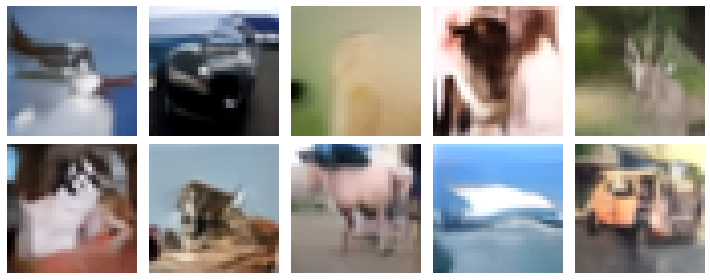

Epoch 321/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0538 - i_loss: 0.2070 - val_n_loss: 0.0519 - val_i_loss: 0.1562 - val_kid: 0.1591


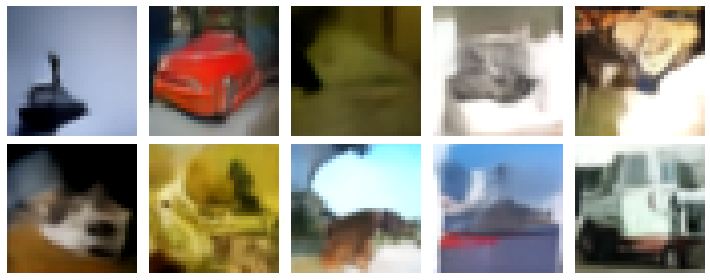

Epoch 322/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0537 - i_loss: 0.2107 - val_n_loss: 0.0514 - val_i_loss: 0.1585 - val_kid: 0.1712


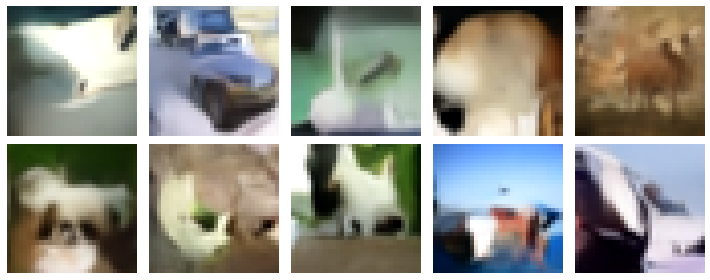

Epoch 323/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0541 - i_loss: 0.2041 - val_n_loss: 0.0514 - val_i_loss: 0.1582 - val_kid: 0.1703


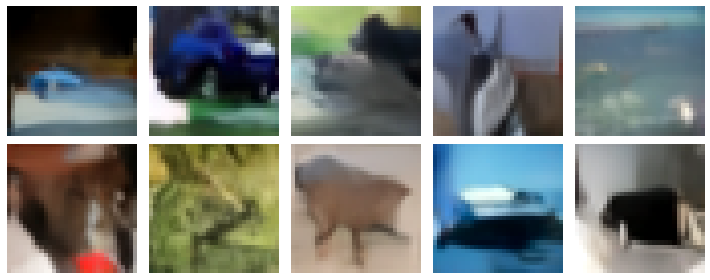

Epoch 324/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0541 - i_loss: 0.2056 - val_n_loss: 0.0509 - val_i_loss: 0.1601 - val_kid: 0.1678


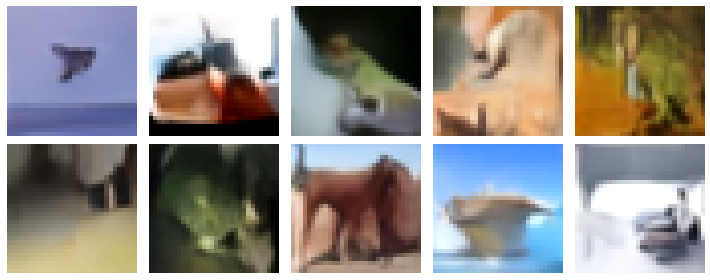

Epoch 325/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0538 - i_loss: 0.2080 - val_n_loss: 0.0522 - val_i_loss: 0.1533 - val_kid: 0.1742


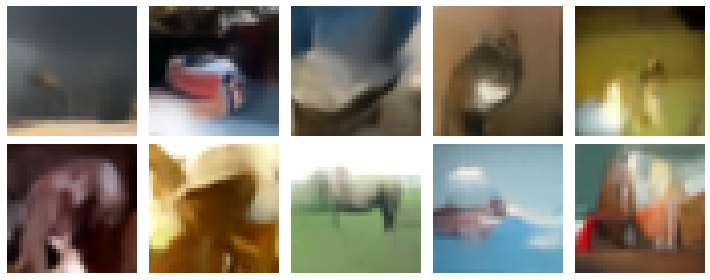

Epoch 326/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0541 - i_loss: 0.2082 - val_n_loss: 0.0527 - val_i_loss: 0.1529 - val_kid: 0.1649


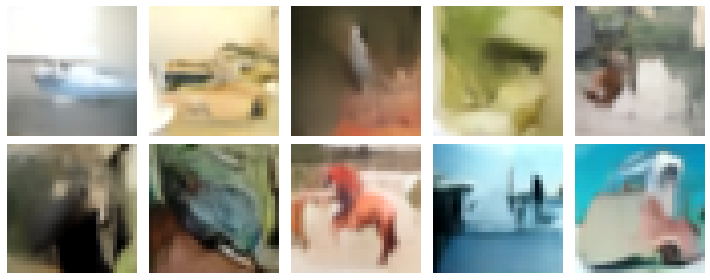

Epoch 327/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0538 - i_loss: 0.2049 - val_n_loss: 0.0527 - val_i_loss: 0.1495 - val_kid: 0.1587


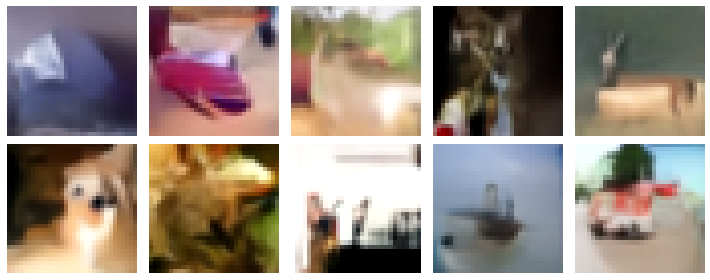

Epoch 328/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0537 - i_loss: 0.2074 - val_n_loss: 0.0524 - val_i_loss: 0.1541 - val_kid: 0.1572


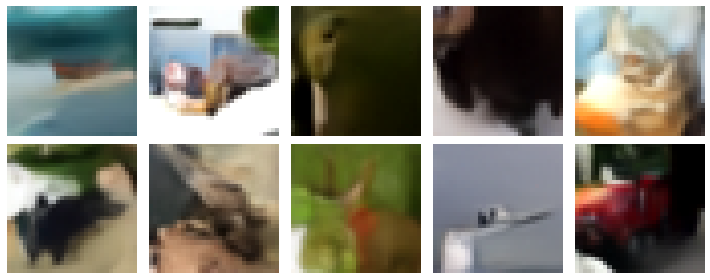

Epoch 329/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0539 - i_loss: 0.2094 - val_n_loss: 0.0521 - val_i_loss: 0.1548 - val_kid: 0.1625


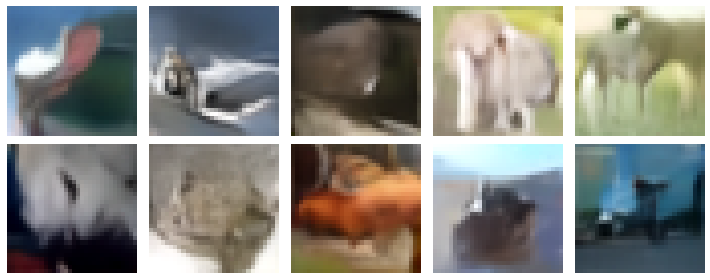

Epoch 330/500
703/703 [==============================] - 47s 68ms/step - n_loss: 0.0538 - i_loss: 0.2105 - val_n_loss: 0.0521 - val_i_loss: 0.1529 - val_kid: 0.1776


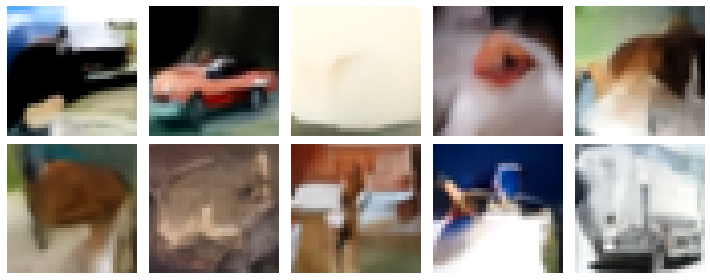

Epoch 331/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0539 - i_loss: 0.2043 - val_n_loss: 0.0509 - val_i_loss: 0.1613 - val_kid: 0.1665


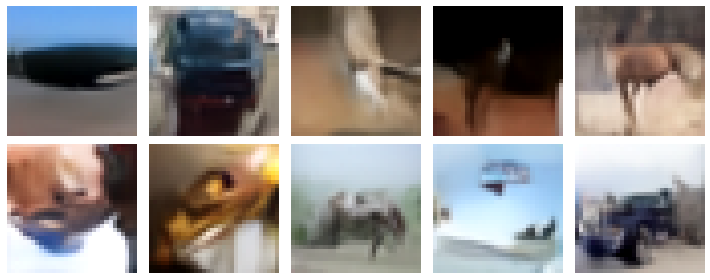

Epoch 332/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0541 - i_loss: 0.2089 - val_n_loss: 0.0516 - val_i_loss: 0.1571 - val_kid: 0.1617


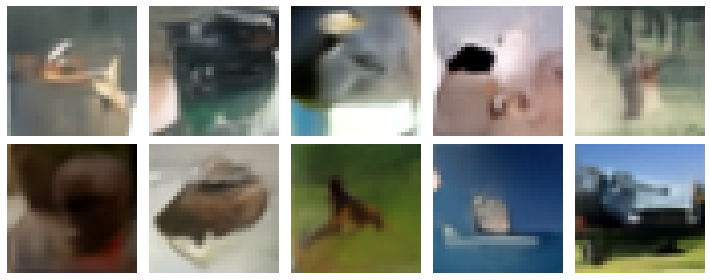

Epoch 333/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0537 - i_loss: 0.2044 - val_n_loss: 0.0516 - val_i_loss: 0.1610 - val_kid: 0.1618


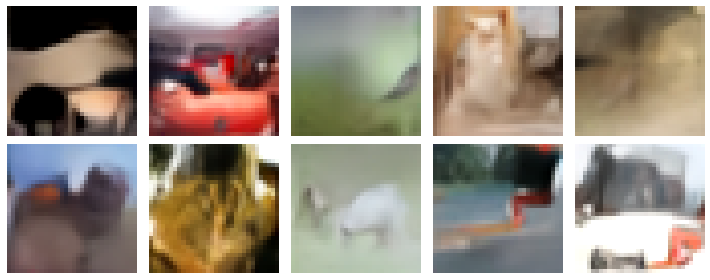

Epoch 334/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0538 - i_loss: 0.2078 - val_n_loss: 0.0518 - val_i_loss: 0.1552 - val_kid: 0.1704


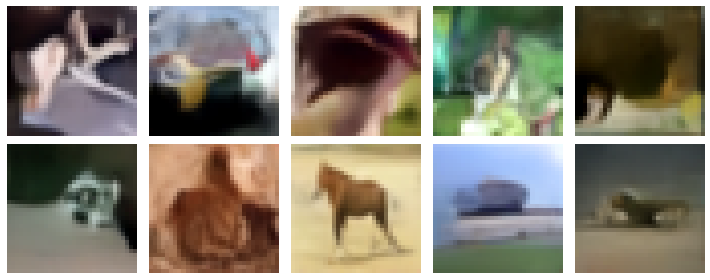

Epoch 335/500
703/703 [==============================] - 47s 68ms/step - n_loss: 0.0536 - i_loss: 0.2091 - val_n_loss: 0.0518 - val_i_loss: 0.1644 - val_kid: 0.1743


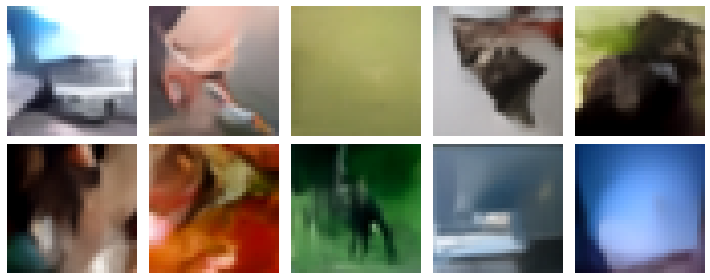

Epoch 336/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0539 - i_loss: 0.2079 - val_n_loss: 0.0524 - val_i_loss: 0.1538 - val_kid: 0.1751


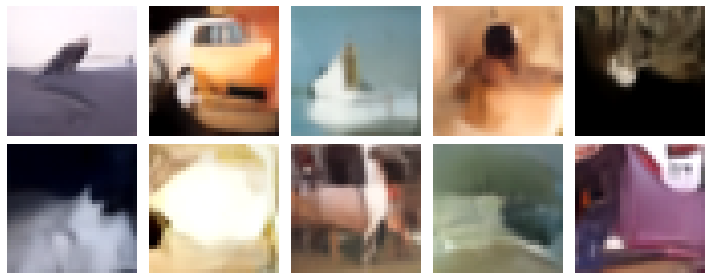

Epoch 337/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0536 - i_loss: 0.2117 - val_n_loss: 0.0523 - val_i_loss: 0.1504 - val_kid: 0.1835


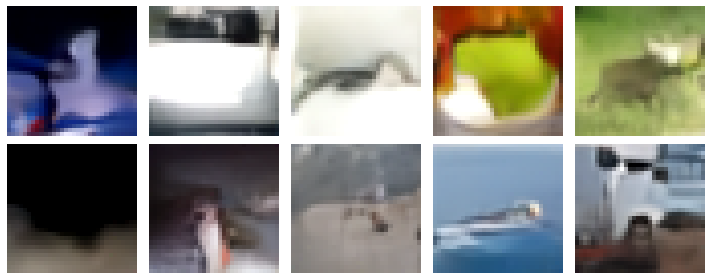

Epoch 338/500
703/703 [==============================] - 48s 68ms/step - n_loss: 0.0536 - i_loss: 0.2072 - val_n_loss: 0.0525 - val_i_loss: 0.1489 - val_kid: 0.1679


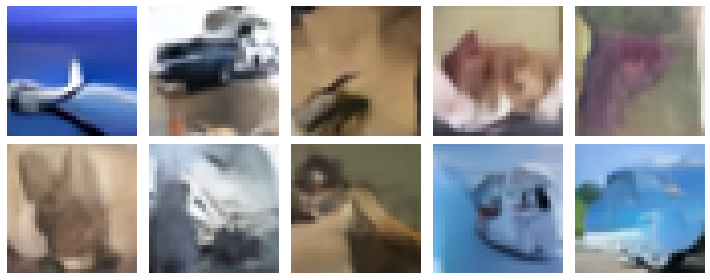

Epoch 339/500
703/703 [==============================] - 48s 68ms/step - n_loss: 0.0536 - i_loss: 0.2107 - val_n_loss: 0.0517 - val_i_loss: 0.1574 - val_kid: 0.1622


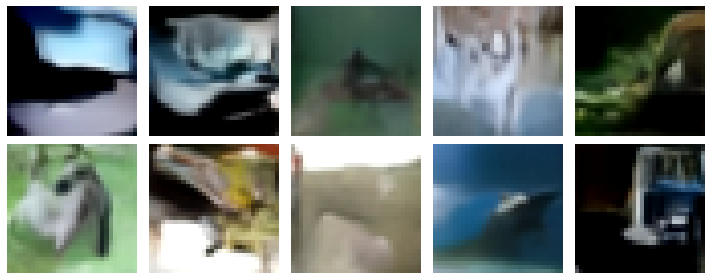

Epoch 340/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0542 - i_loss: 0.2082 - val_n_loss: 0.0512 - val_i_loss: 0.1593 - val_kid: 0.1644


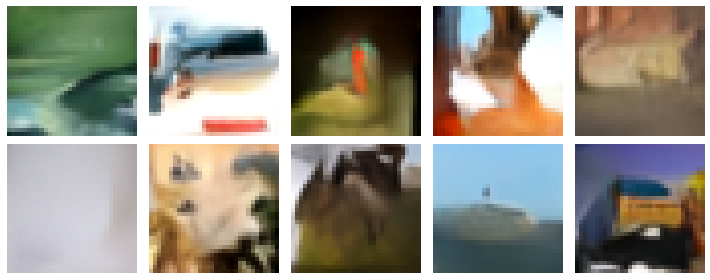

Epoch 341/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0538 - i_loss: 0.2034 - val_n_loss: 0.0511 - val_i_loss: 0.1597 - val_kid: 0.1717


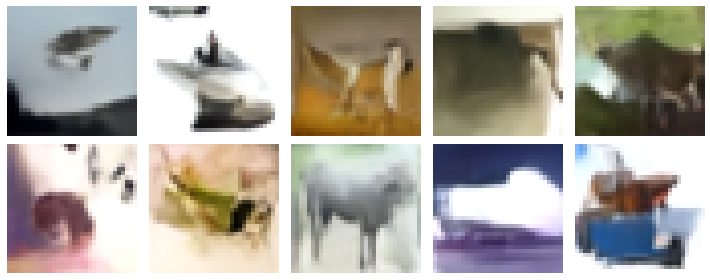

Epoch 342/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0538 - i_loss: 0.2165 - val_n_loss: 0.0520 - val_i_loss: 0.1520 - val_kid: 0.1780


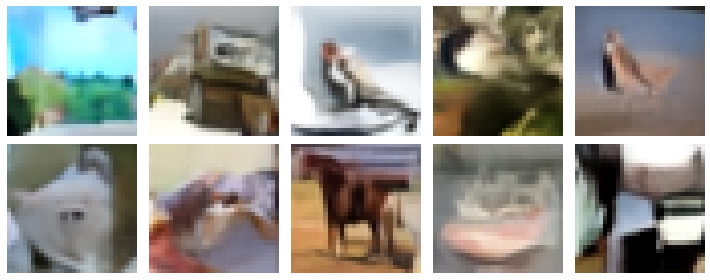

Epoch 343/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0536 - i_loss: 0.2064 - val_n_loss: 0.0519 - val_i_loss: 0.1586 - val_kid: 0.1739


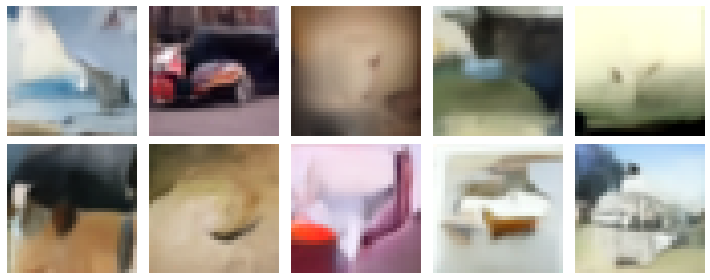

Epoch 344/500
703/703 [==============================] - 47s 68ms/step - n_loss: 0.0539 - i_loss: 0.2099 - val_n_loss: 0.0525 - val_i_loss: 0.1543 - val_kid: 0.1729


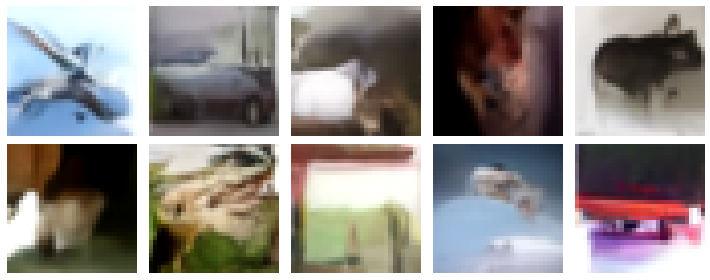

Epoch 345/500
703/703 [==============================] - 48s 68ms/step - n_loss: 0.0538 - i_loss: 0.2079 - val_n_loss: 0.0522 - val_i_loss: 0.1529 - val_kid: 0.1837


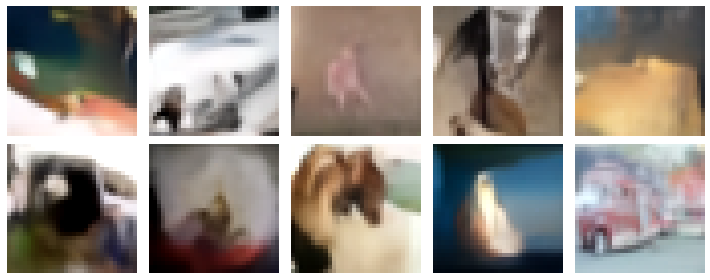

Epoch 346/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0541 - i_loss: 0.2039 - val_n_loss: 0.0519 - val_i_loss: 0.1561 - val_kid: 0.1698


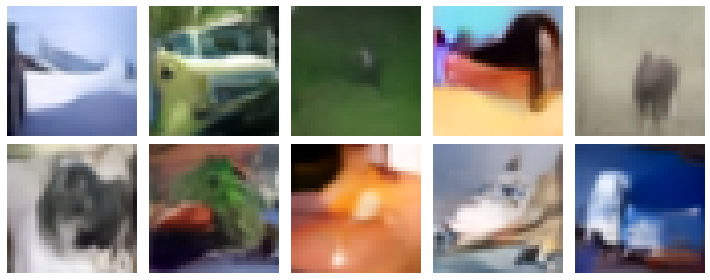

Epoch 347/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0544 - i_loss: 0.2059 - val_n_loss: 0.0523 - val_i_loss: 0.1574 - val_kid: 0.1671


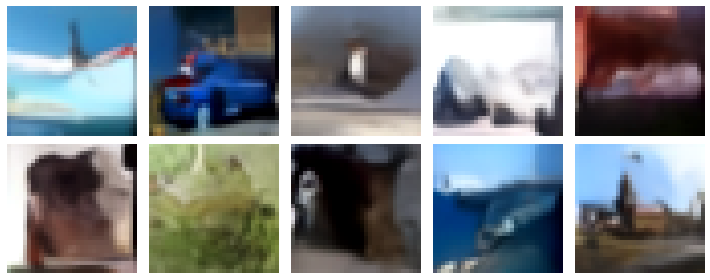

Epoch 348/500
703/703 [==============================] - 48s 68ms/step - n_loss: 0.0540 - i_loss: 0.2105 - val_n_loss: 0.0514 - val_i_loss: 0.1642 - val_kid: 0.1803


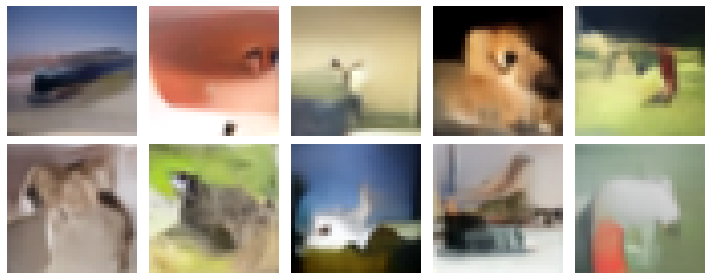

Epoch 349/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0541 - i_loss: 0.2087 - val_n_loss: 0.0509 - val_i_loss: 0.1602 - val_kid: 0.1721


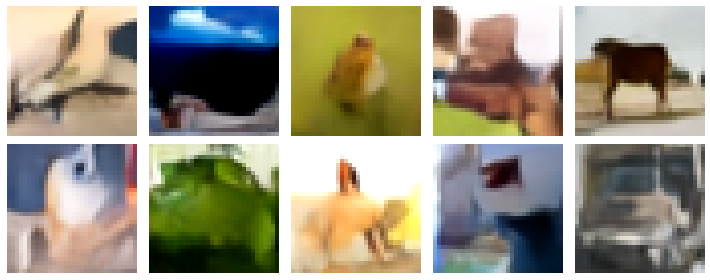

Epoch 350/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0542 - i_loss: 0.2107 - val_n_loss: 0.0523 - val_i_loss: 0.1537 - val_kid: 0.1672


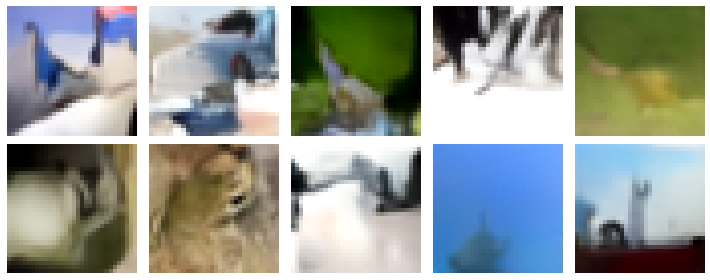

Epoch 351/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0538 - i_loss: 0.2111 - val_n_loss: 0.0516 - val_i_loss: 0.1579 - val_kid: 0.1680


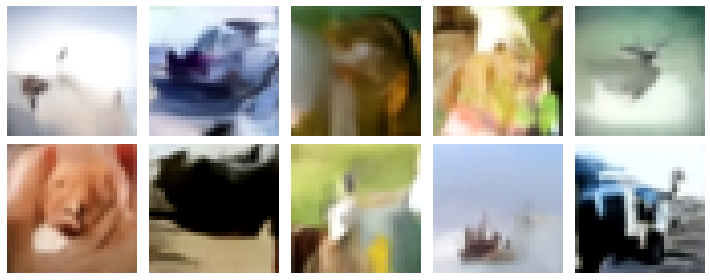

Epoch 352/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0537 - i_loss: 0.2021 - val_n_loss: 0.0520 - val_i_loss: 0.1575 - val_kid: 0.1688


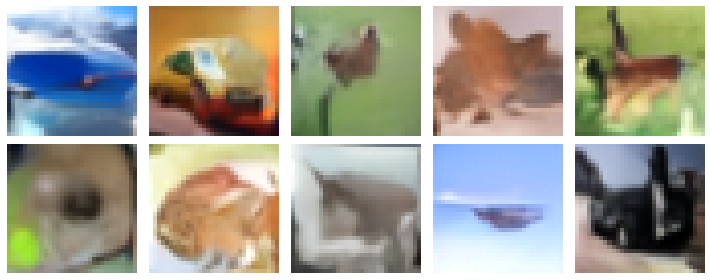

Epoch 353/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0540 - i_loss: 0.2081 - val_n_loss: 0.0517 - val_i_loss: 0.1558 - val_kid: 0.1616


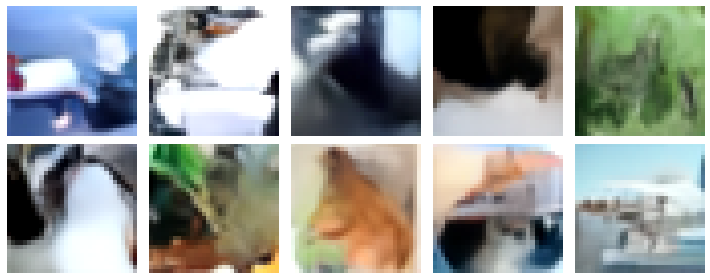

Epoch 354/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0539 - i_loss: 0.2120 - val_n_loss: 0.0516 - val_i_loss: 0.1601 - val_kid: 0.1673


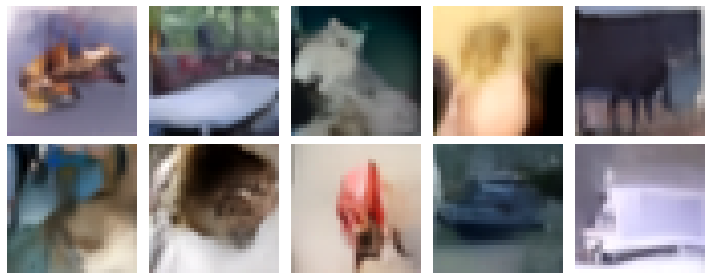

Epoch 355/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0542 - i_loss: 0.2066 - val_n_loss: 0.0522 - val_i_loss: 0.1531 - val_kid: 0.1736


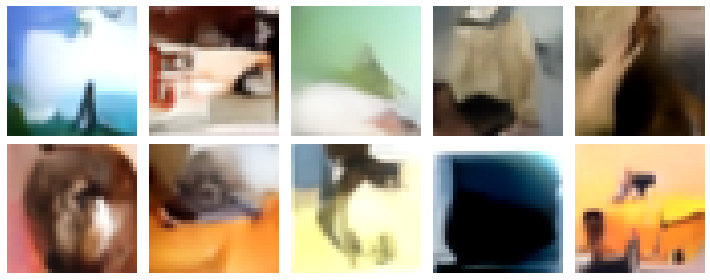

Epoch 356/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0539 - i_loss: 0.2049 - val_n_loss: 0.0515 - val_i_loss: 0.1547 - val_kid: 0.1745


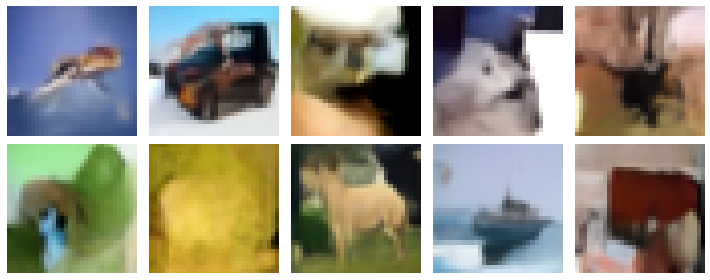

Epoch 357/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0538 - i_loss: 0.2100 - val_n_loss: 0.0519 - val_i_loss: 0.1542 - val_kid: 0.1687


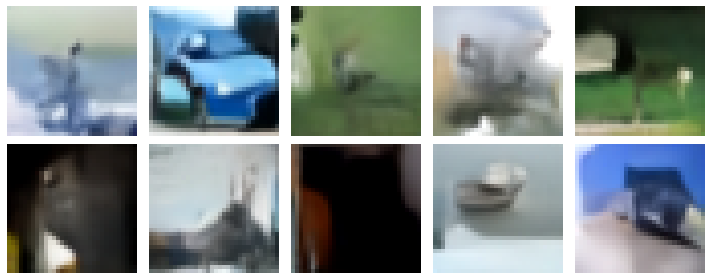

Epoch 358/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0538 - i_loss: 0.2059 - val_n_loss: 0.0525 - val_i_loss: 0.1509 - val_kid: 0.1757


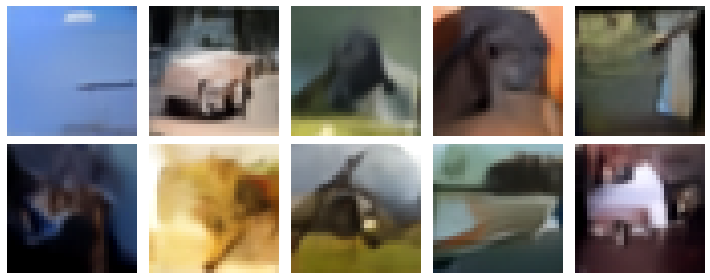

Epoch 359/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0541 - i_loss: 0.2071 - val_n_loss: 0.0524 - val_i_loss: 0.1523 - val_kid: 0.1686


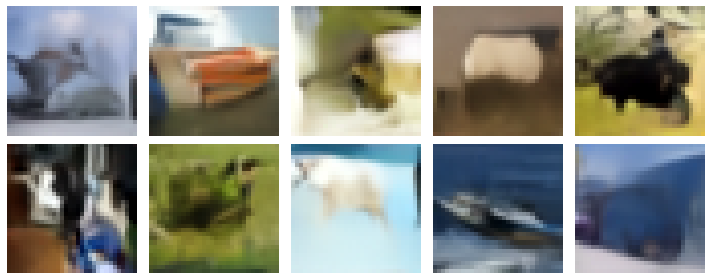

Epoch 360/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0539 - i_loss: 0.2099 - val_n_loss: 0.0524 - val_i_loss: 0.1552 - val_kid: 0.1736


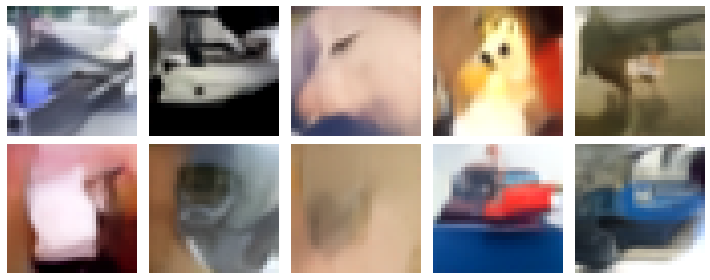

Epoch 361/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0535 - i_loss: 0.2101 - val_n_loss: 0.0513 - val_i_loss: 0.1542 - val_kid: 0.1679


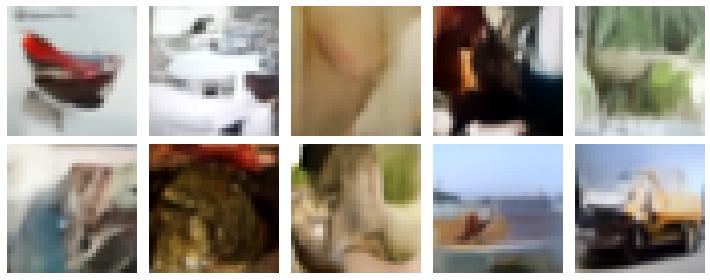

Epoch 362/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0538 - i_loss: 0.2080 - val_n_loss: 0.0523 - val_i_loss: 0.1508 - val_kid: 0.1712


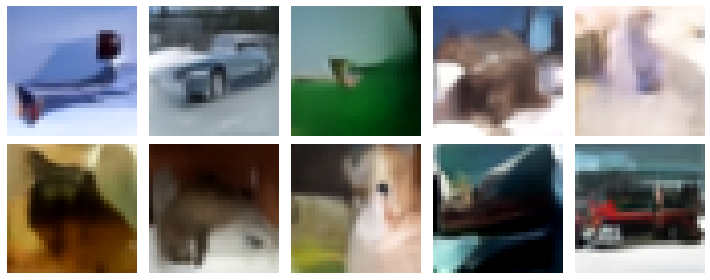

Epoch 363/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0540 - i_loss: 0.2081 - val_n_loss: 0.0532 - val_i_loss: 0.1557 - val_kid: 0.1695


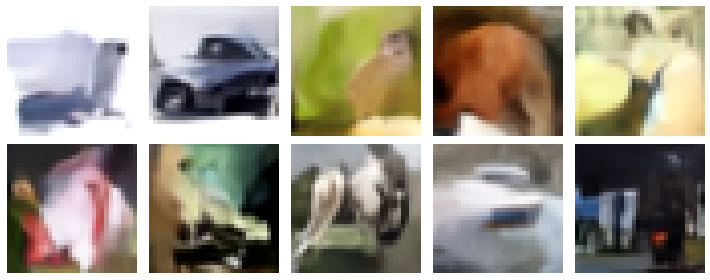

Epoch 364/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0536 - i_loss: 0.2113 - val_n_loss: 0.0525 - val_i_loss: 0.1563 - val_kid: 0.1725


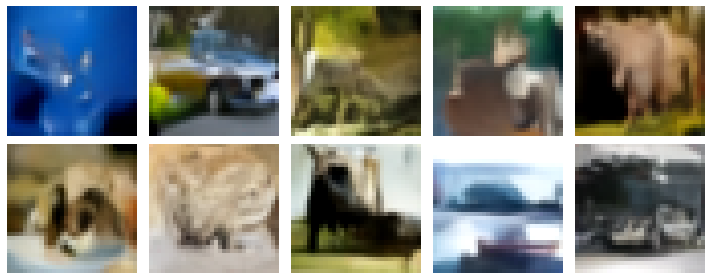

Epoch 365/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0540 - i_loss: 0.2079 - val_n_loss: 0.0514 - val_i_loss: 0.1581 - val_kid: 0.1683


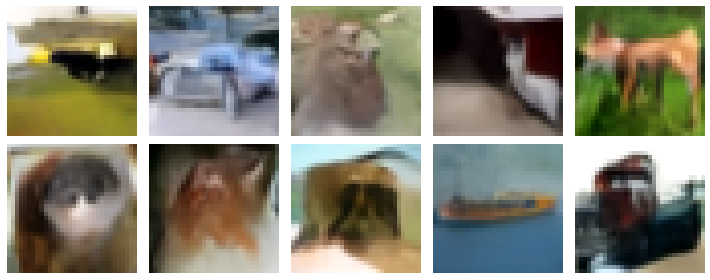

Epoch 366/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0539 - i_loss: 0.2043 - val_n_loss: 0.0526 - val_i_loss: 0.1518 - val_kid: 0.1658


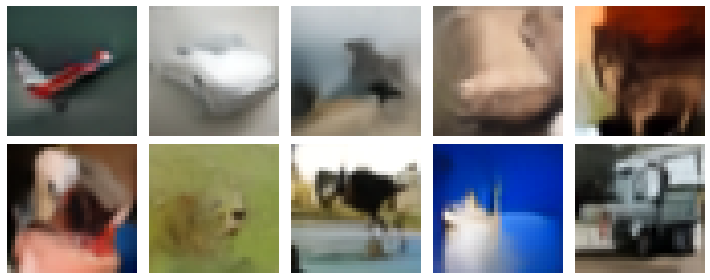

Epoch 367/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0537 - i_loss: 0.2078 - val_n_loss: 0.0518 - val_i_loss: 0.1553 - val_kid: 0.1724


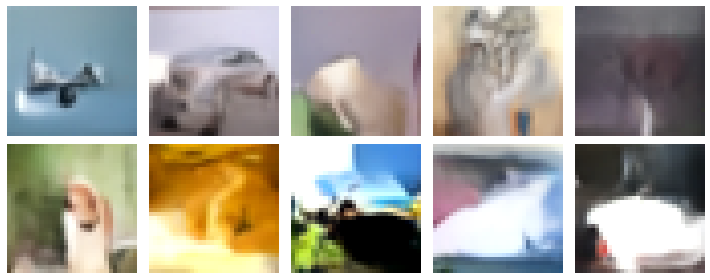

Epoch 368/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0540 - i_loss: 0.2079 - val_n_loss: 0.0517 - val_i_loss: 0.1560 - val_kid: 0.1686


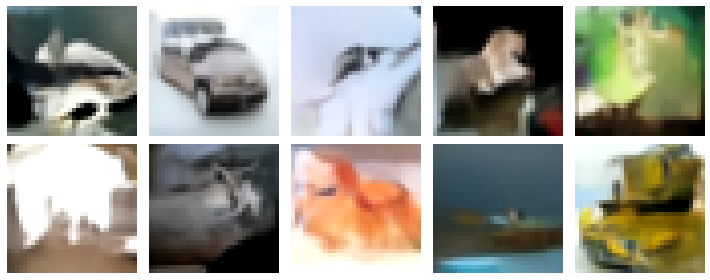

Epoch 369/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0537 - i_loss: 0.2062 - val_n_loss: 0.0520 - val_i_loss: 0.1542 - val_kid: 0.1728


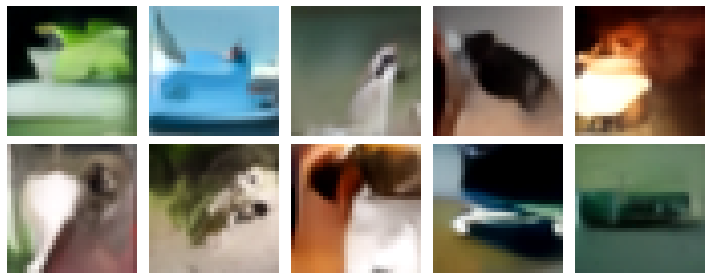

Epoch 370/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0539 - i_loss: 0.2049 - val_n_loss: 0.0519 - val_i_loss: 0.1592 - val_kid: 0.1825


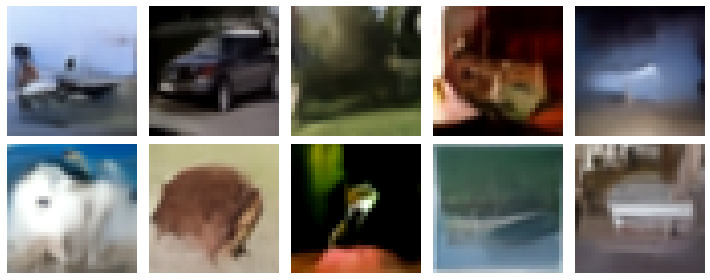

Epoch 371/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0540 - i_loss: 0.2093 - val_n_loss: 0.0524 - val_i_loss: 0.1538 - val_kid: 0.1759


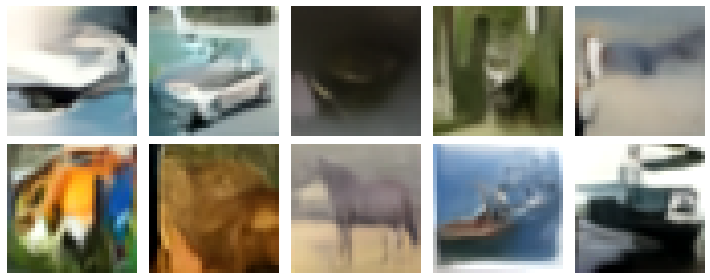

Epoch 372/500
703/703 [==============================] - 47s 68ms/step - n_loss: 0.0537 - i_loss: 0.2124 - val_n_loss: 0.0523 - val_i_loss: 0.1516 - val_kid: 0.1747


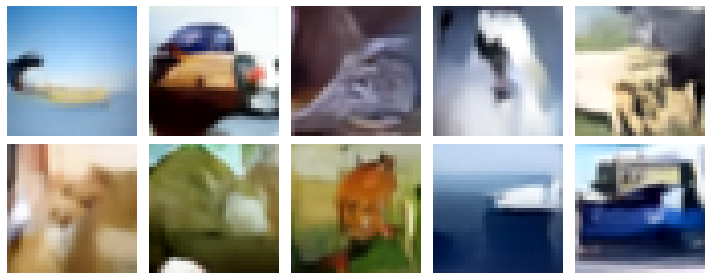

Epoch 373/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0540 - i_loss: 0.2079 - val_n_loss: 0.0522 - val_i_loss: 0.1577 - val_kid: 0.1672


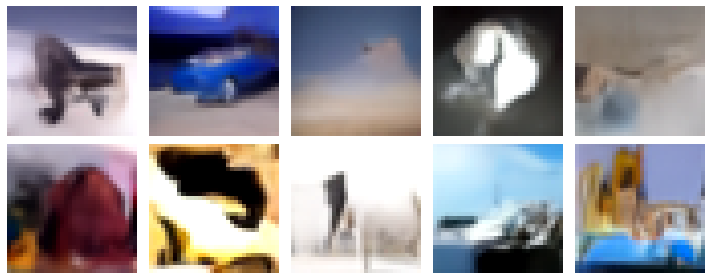

Epoch 374/500
703/703 [==============================] - 47s 68ms/step - n_loss: 0.0538 - i_loss: 0.2047 - val_n_loss: 0.0514 - val_i_loss: 0.1545 - val_kid: 0.1699


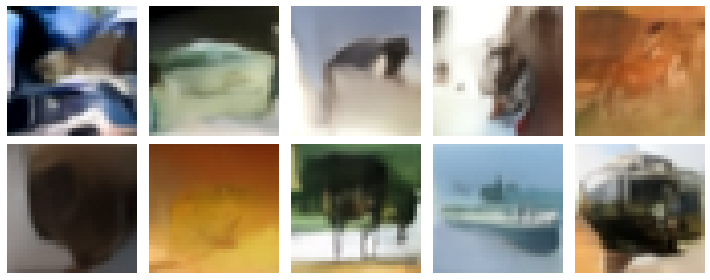

Epoch 375/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0537 - i_loss: 0.2121 - val_n_loss: 0.0512 - val_i_loss: 0.1614 - val_kid: 0.1745


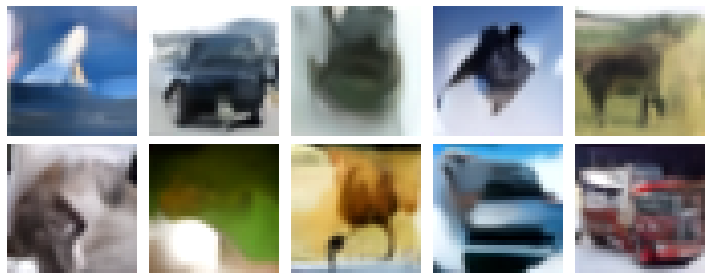

Epoch 376/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0541 - i_loss: 0.2052 - val_n_loss: 0.0526 - val_i_loss: 0.1537 - val_kid: 0.1632


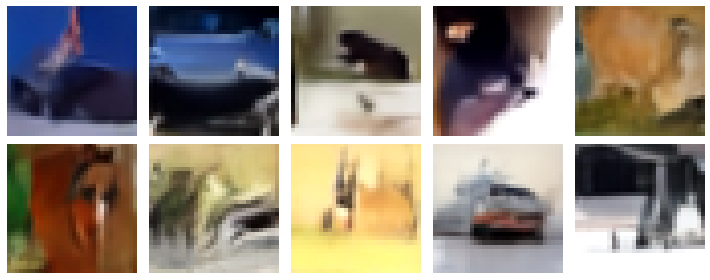

Epoch 377/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0540 - i_loss: 0.2068 - val_n_loss: 0.0520 - val_i_loss: 0.1527 - val_kid: 0.1726


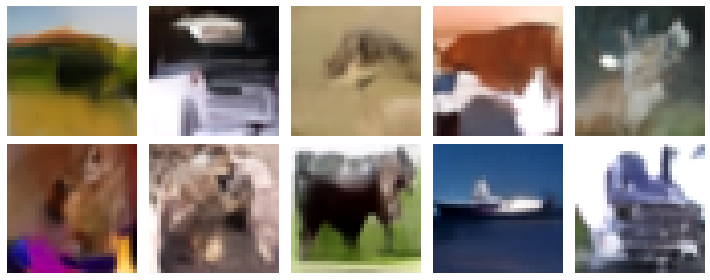

Epoch 378/500
703/703 [==============================] - 47s 68ms/step - n_loss: 0.0543 - i_loss: 0.2080 - val_n_loss: 0.0520 - val_i_loss: 0.1503 - val_kid: 0.1703


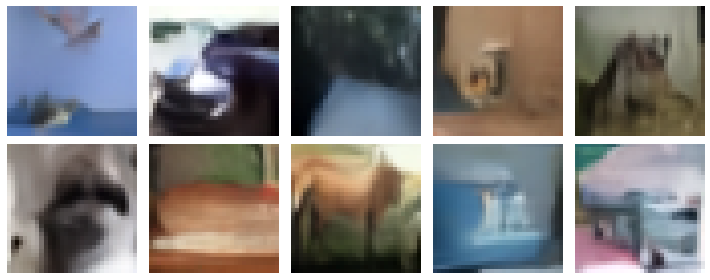

Epoch 379/500
703/703 [==============================] - 47s 68ms/step - n_loss: 0.0540 - i_loss: 0.2042 - val_n_loss: 0.0526 - val_i_loss: 0.1548 - val_kid: 0.1701


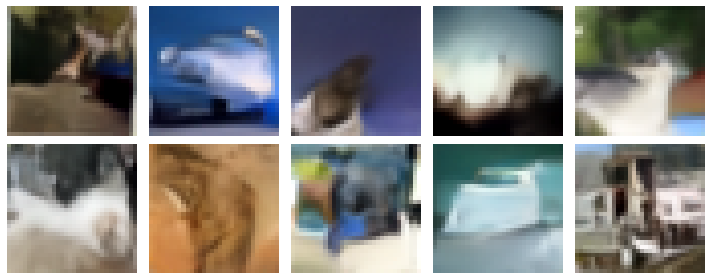

Epoch 380/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0536 - i_loss: 0.2093 - val_n_loss: 0.0515 - val_i_loss: 0.1597 - val_kid: 0.1720


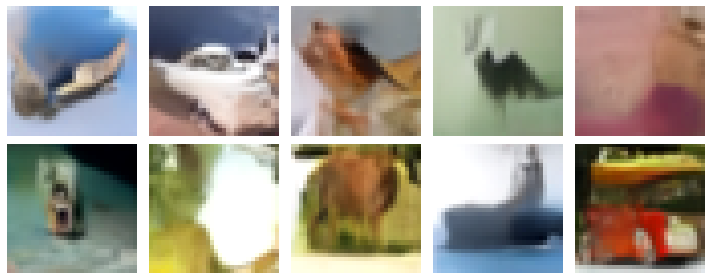

Epoch 381/500
703/703 [==============================] - 47s 68ms/step - n_loss: 0.0539 - i_loss: 0.2054 - val_n_loss: 0.0521 - val_i_loss: 0.1544 - val_kid: 0.1678


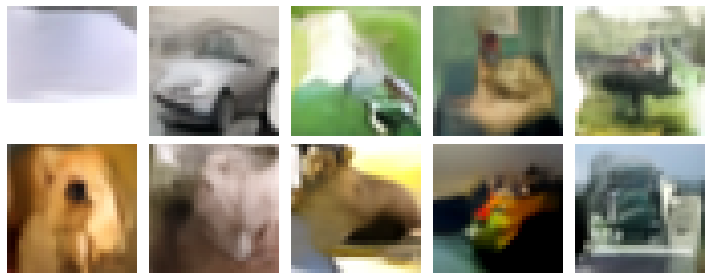

Epoch 382/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0540 - i_loss: 0.2043 - val_n_loss: 0.0524 - val_i_loss: 0.1529 - val_kid: 0.1677


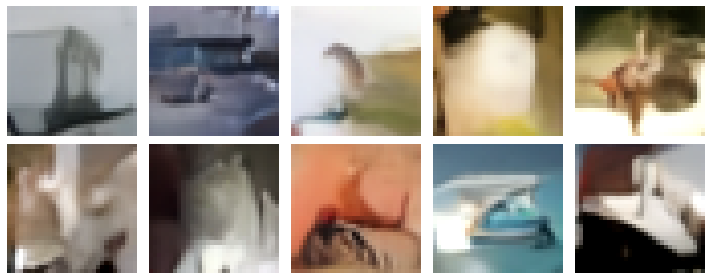

Epoch 383/500
703/703 [==============================] - 47s 68ms/step - n_loss: 0.0538 - i_loss: 0.2057 - val_n_loss: 0.0520 - val_i_loss: 0.1623 - val_kid: 0.1732


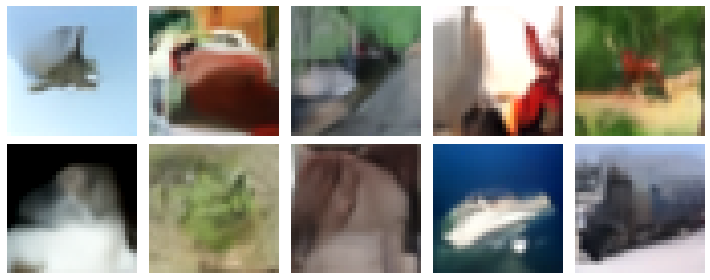

Epoch 384/500
703/703 [==============================] - 47s 68ms/step - n_loss: 0.0541 - i_loss: 0.2084 - val_n_loss: 0.0522 - val_i_loss: 0.1535 - val_kid: 0.1708


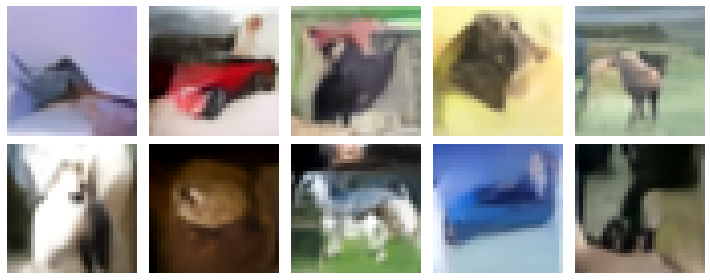

Epoch 385/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0539 - i_loss: 0.2065 - val_n_loss: 0.0521 - val_i_loss: 0.1513 - val_kid: 0.1719


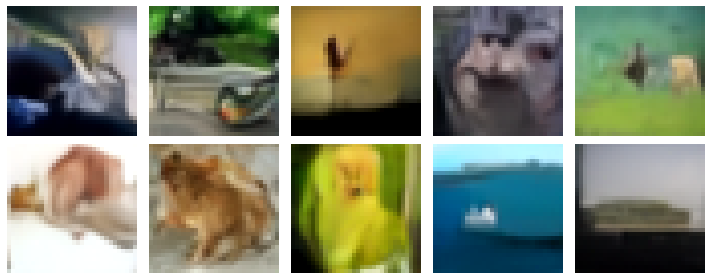

Epoch 386/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0539 - i_loss: 0.2098 - val_n_loss: 0.0523 - val_i_loss: 0.1534 - val_kid: 0.1697


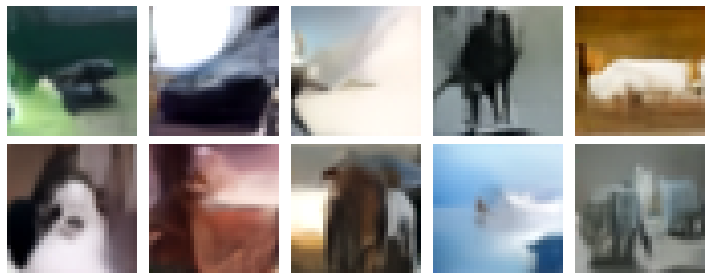

Epoch 387/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0537 - i_loss: 0.2079 - val_n_loss: 0.0522 - val_i_loss: 0.1565 - val_kid: 0.1744


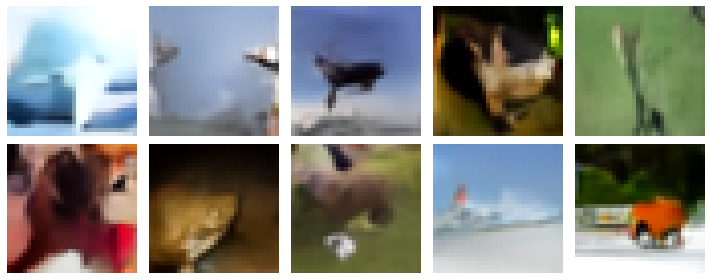

Epoch 388/500
703/703 [==============================] - 48s 68ms/step - n_loss: 0.0538 - i_loss: 0.2051 - val_n_loss: 0.0522 - val_i_loss: 0.1584 - val_kid: 0.1698


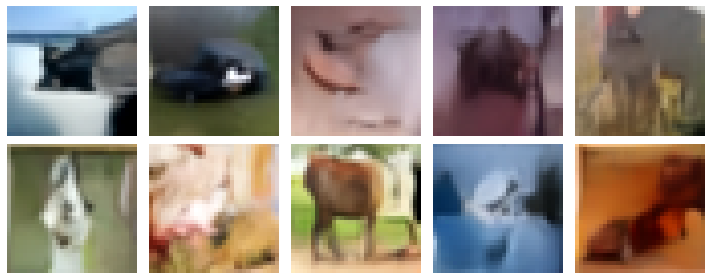

Epoch 389/500
703/703 [==============================] - 47s 68ms/step - n_loss: 0.0542 - i_loss: 0.2039 - val_n_loss: 0.0516 - val_i_loss: 0.1566 - val_kid: 0.1694


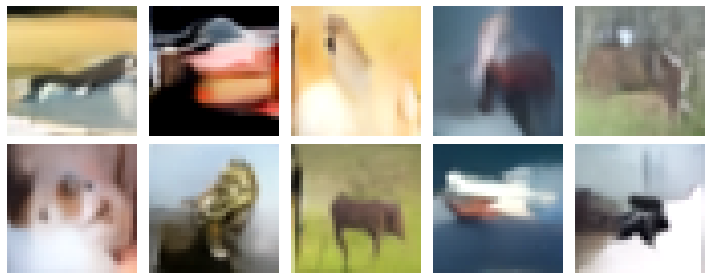

Epoch 390/500
703/703 [==============================] - 47s 68ms/step - n_loss: 0.0536 - i_loss: 0.2128 - val_n_loss: 0.0519 - val_i_loss: 0.1544 - val_kid: 0.1843


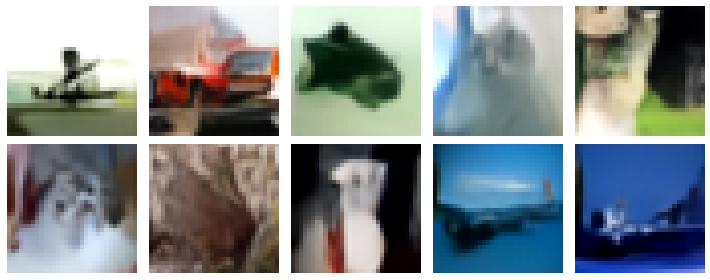

Epoch 391/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0540 - i_loss: 0.2104 - val_n_loss: 0.0518 - val_i_loss: 0.1569 - val_kid: 0.1724


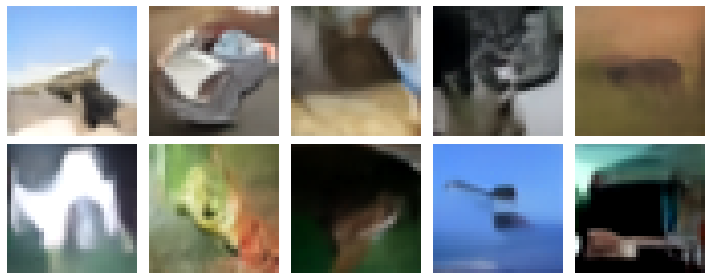

Epoch 392/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0538 - i_loss: 0.2085 - val_n_loss: 0.0519 - val_i_loss: 0.1559 - val_kid: 0.1623


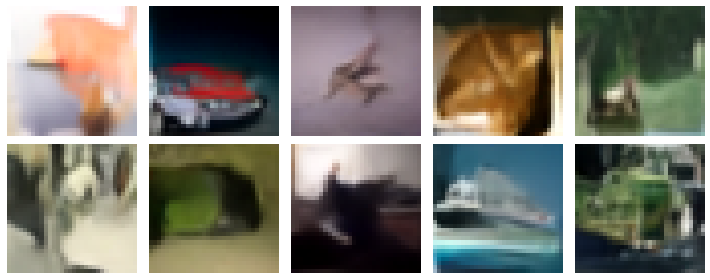

Epoch 393/500
703/703 [==============================] - 47s 68ms/step - n_loss: 0.0538 - i_loss: 0.2069 - val_n_loss: 0.0525 - val_i_loss: 0.1496 - val_kid: 0.1707


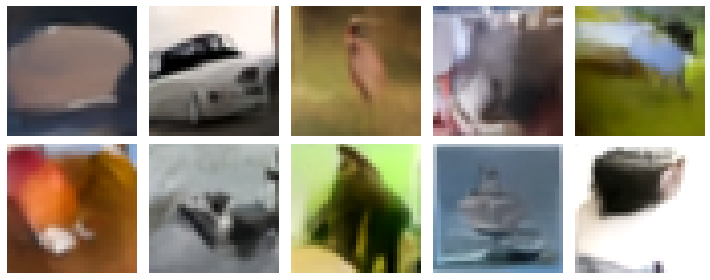

Epoch 394/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0540 - i_loss: 0.2077 - val_n_loss: 0.0515 - val_i_loss: 0.1545 - val_kid: 0.1594


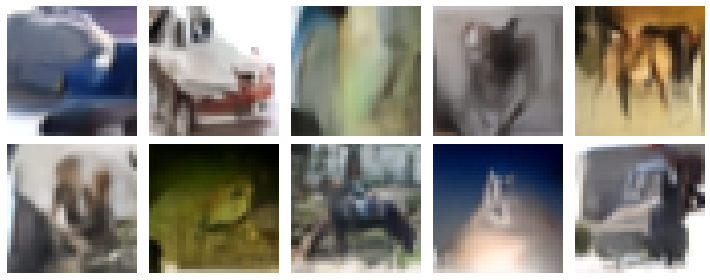

Epoch 395/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0534 - i_loss: 0.2122 - val_n_loss: 0.0518 - val_i_loss: 0.1550 - val_kid: 0.1711


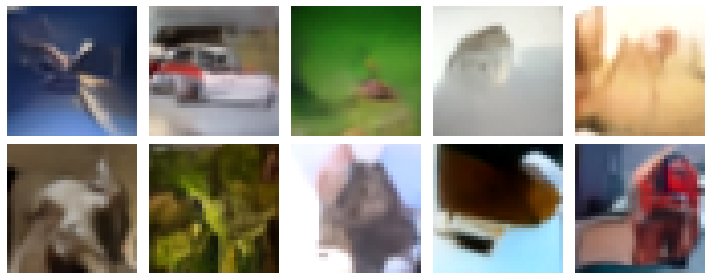

Epoch 396/500
703/703 [==============================] - 47s 68ms/step - n_loss: 0.0542 - i_loss: 0.2078 - val_n_loss: 0.0513 - val_i_loss: 0.1582 - val_kid: 0.1603


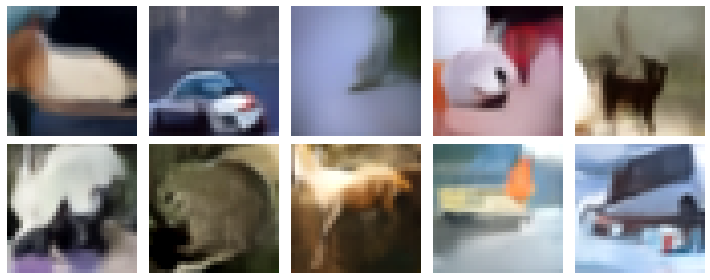

Epoch 397/500
703/703 [==============================] - 47s 68ms/step - n_loss: 0.0539 - i_loss: 0.2083 - val_n_loss: 0.0522 - val_i_loss: 0.1506 - val_kid: 0.1667


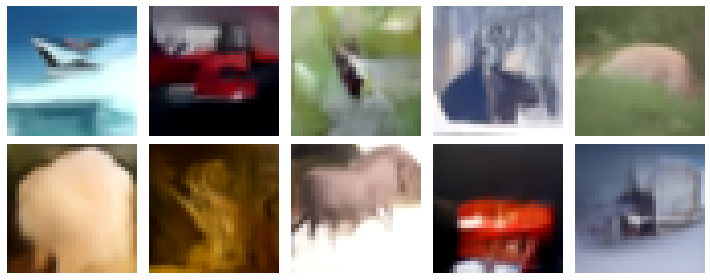

Epoch 398/500
703/703 [==============================] - 47s 68ms/step - n_loss: 0.0539 - i_loss: 0.2067 - val_n_loss: 0.0524 - val_i_loss: 0.1542 - val_kid: 0.1708


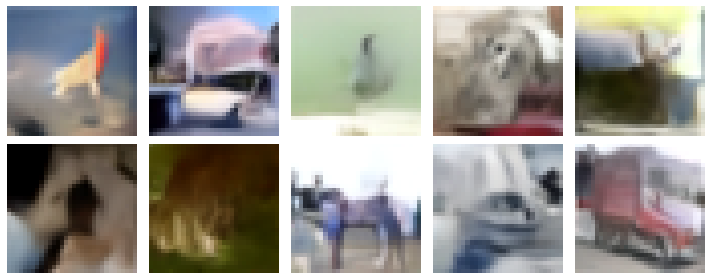

Epoch 399/500
703/703 [==============================] - 47s 68ms/step - n_loss: 0.0542 - i_loss: 0.2056 - val_n_loss: 0.0518 - val_i_loss: 0.1564 - val_kid: 0.1633


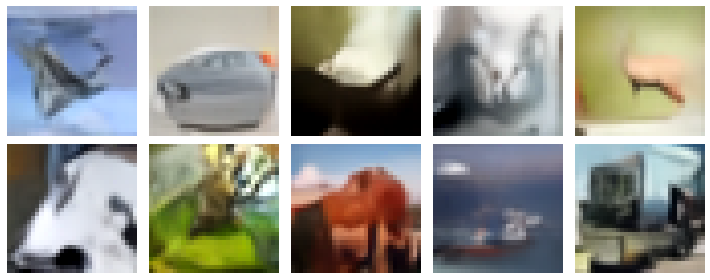

Epoch 400/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0540 - i_loss: 0.2135 - val_n_loss: 0.0524 - val_i_loss: 0.1581 - val_kid: 0.1739


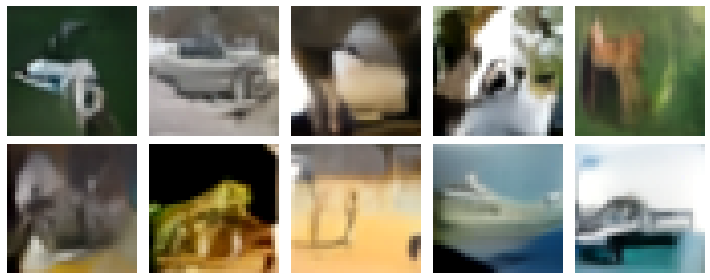

Epoch 401/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0541 - i_loss: 0.2061 - val_n_loss: 0.0518 - val_i_loss: 0.1534 - val_kid: 0.1755


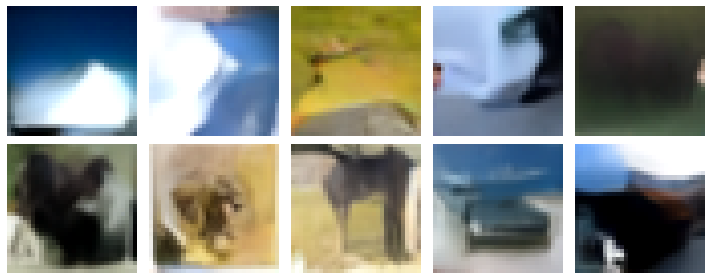

Epoch 402/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0537 - i_loss: 0.2078 - val_n_loss: 0.0515 - val_i_loss: 0.1543 - val_kid: 0.1628


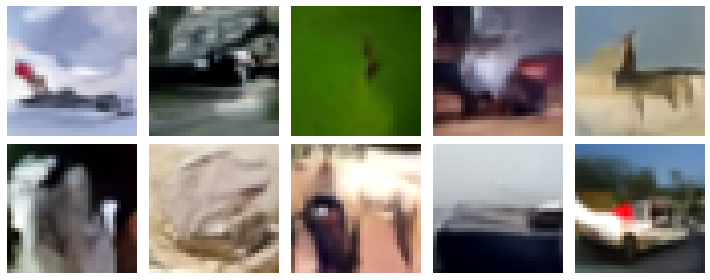

Epoch 403/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0539 - i_loss: 0.2113 - val_n_loss: 0.0517 - val_i_loss: 0.1566 - val_kid: 0.1741


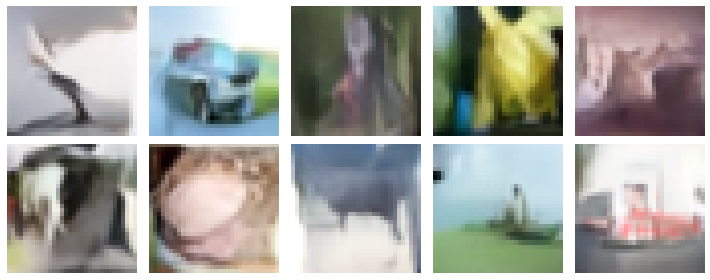

Epoch 404/500
703/703 [==============================] - 47s 68ms/step - n_loss: 0.0538 - i_loss: 0.2061 - val_n_loss: 0.0522 - val_i_loss: 0.1555 - val_kid: 0.1581


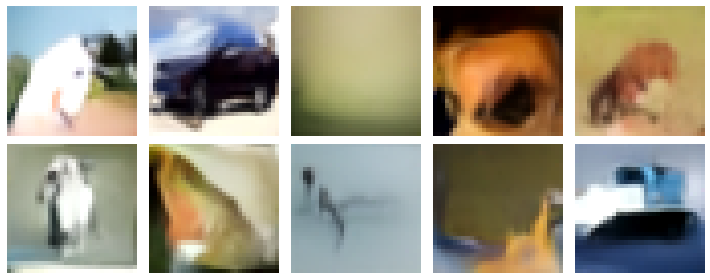

Epoch 405/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0537 - i_loss: 0.2111 - val_n_loss: 0.0520 - val_i_loss: 0.1525 - val_kid: 0.1673


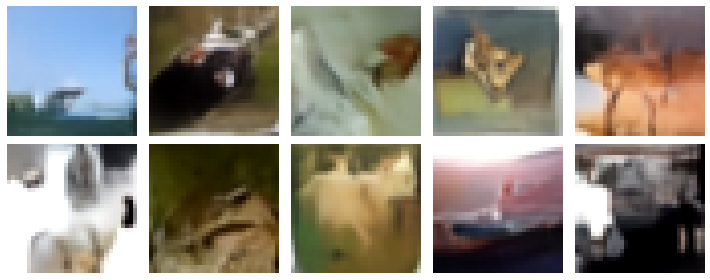

Epoch 406/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0535 - i_loss: 0.2051 - val_n_loss: 0.0514 - val_i_loss: 0.1556 - val_kid: 0.1666


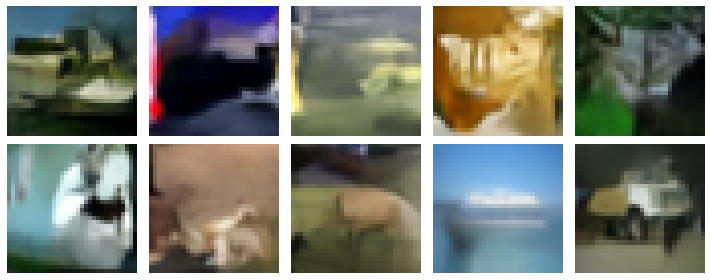

Epoch 407/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0541 - i_loss: 0.2082 - val_n_loss: 0.0514 - val_i_loss: 0.1586 - val_kid: 0.1554


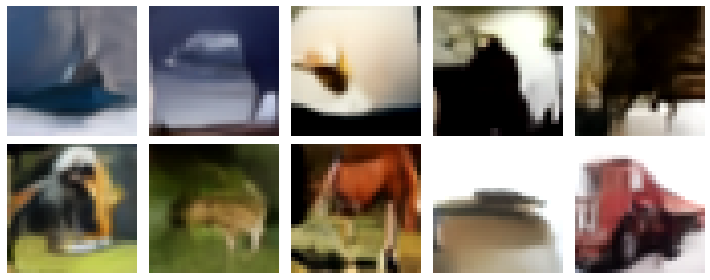

Epoch 408/500
703/703 [==============================] - 47s 68ms/step - n_loss: 0.0545 - i_loss: 0.2088 - val_n_loss: 0.0517 - val_i_loss: 0.1520 - val_kid: 0.1618


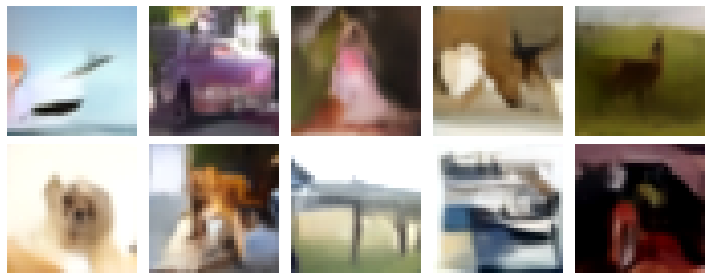

Epoch 409/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0538 - i_loss: 0.2062 - val_n_loss: 0.0517 - val_i_loss: 0.1578 - val_kid: 0.1659


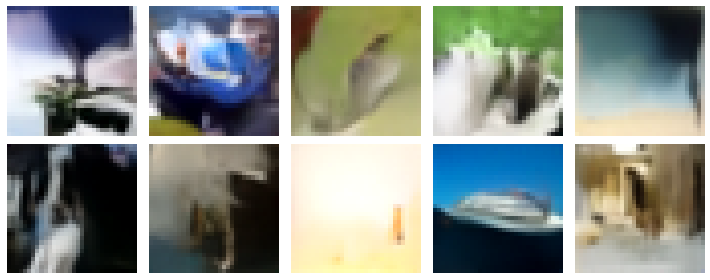

Epoch 410/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0537 - i_loss: 0.2100 - val_n_loss: 0.0514 - val_i_loss: 0.1583 - val_kid: 0.1658


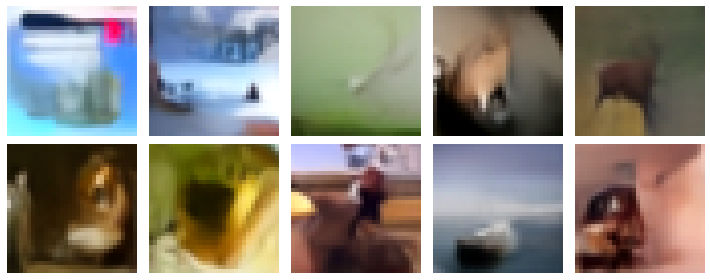

Epoch 411/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0539 - i_loss: 0.2081 - val_n_loss: 0.0524 - val_i_loss: 0.1511 - val_kid: 0.1585


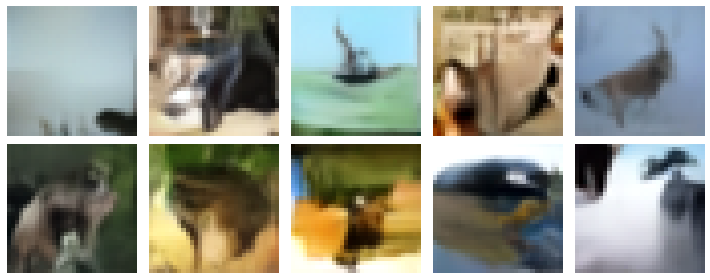

Epoch 412/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0539 - i_loss: 0.2092 - val_n_loss: 0.0514 - val_i_loss: 0.1570 - val_kid: 0.1648


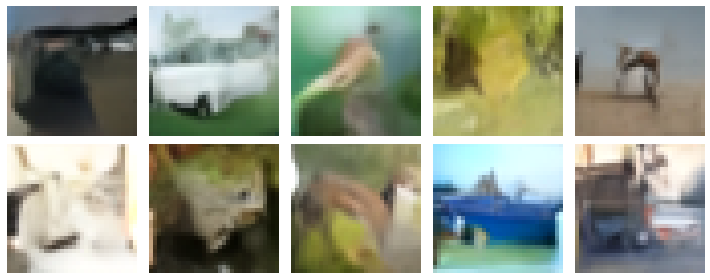

Epoch 413/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0539 - i_loss: 0.2055 - val_n_loss: 0.0508 - val_i_loss: 0.1591 - val_kid: 0.1622


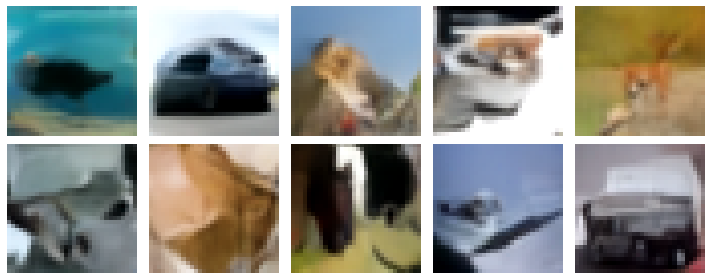

Epoch 414/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0539 - i_loss: 0.2031 - val_n_loss: 0.0517 - val_i_loss: 0.1596 - val_kid: 0.1730


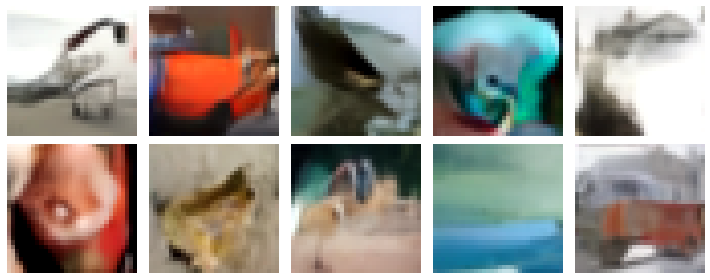

Epoch 415/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0537 - i_loss: 0.2121 - val_n_loss: 0.0512 - val_i_loss: 0.1575 - val_kid: 0.1599


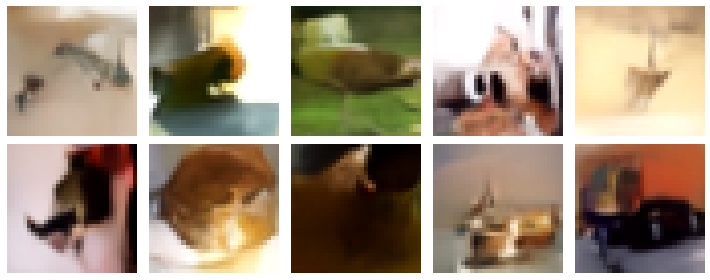

Epoch 416/500
703/703 [==============================] - 47s 68ms/step - n_loss: 0.0542 - i_loss: 0.2069 - val_n_loss: 0.0521 - val_i_loss: 0.1607 - val_kid: 0.1673


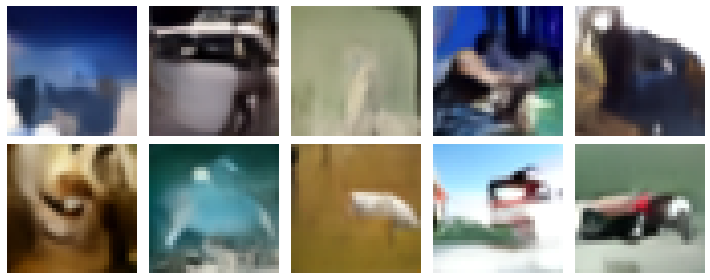

Epoch 417/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0537 - i_loss: 0.2050 - val_n_loss: 0.0520 - val_i_loss: 0.1555 - val_kid: 0.1905


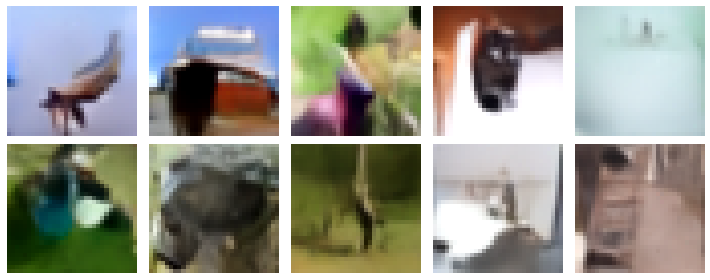

Epoch 418/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0539 - i_loss: 0.2081 - val_n_loss: 0.0512 - val_i_loss: 0.1582 - val_kid: 0.1699


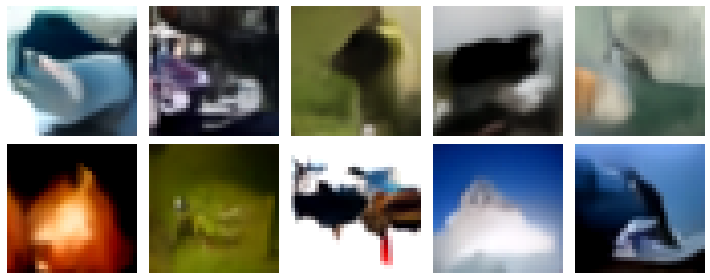

Epoch 419/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0540 - i_loss: 0.2082 - val_n_loss: 0.0512 - val_i_loss: 0.1616 - val_kid: 0.1738


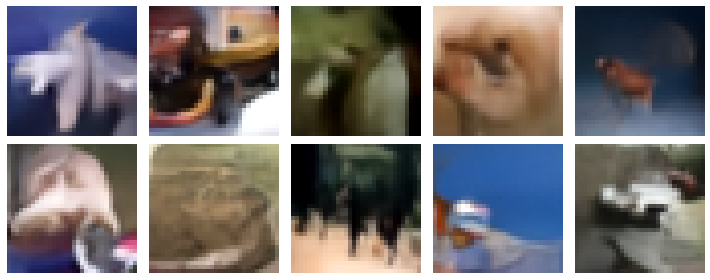

Epoch 420/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0538 - i_loss: 0.2056 - val_n_loss: 0.0523 - val_i_loss: 0.1560 - val_kid: 0.1673


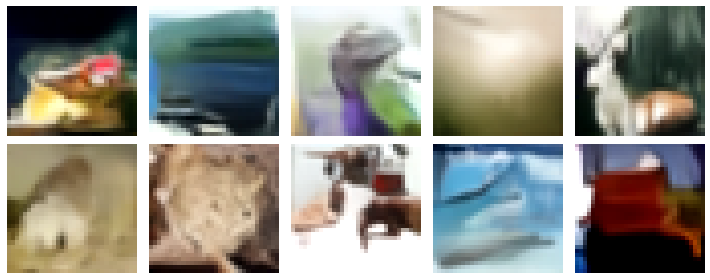

Epoch 421/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0536 - i_loss: 0.2112 - val_n_loss: 0.0529 - val_i_loss: 0.1523 - val_kid: 0.1607


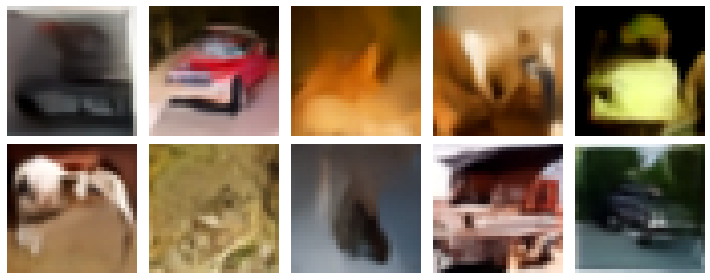

Epoch 422/500
703/703 [==============================] - 47s 68ms/step - n_loss: 0.0539 - i_loss: 0.2020 - val_n_loss: 0.0534 - val_i_loss: 0.1464 - val_kid: 0.1681


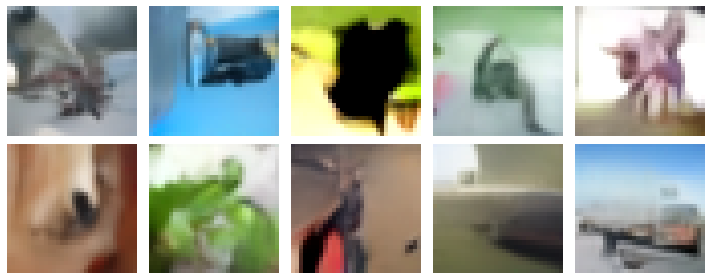

Epoch 423/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0538 - i_loss: 0.2116 - val_n_loss: 0.0525 - val_i_loss: 0.1508 - val_kid: 0.1656


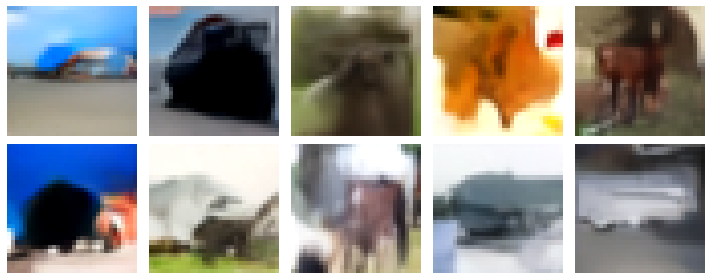

Epoch 424/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0541 - i_loss: 0.2098 - val_n_loss: 0.0518 - val_i_loss: 0.1562 - val_kid: 0.1605


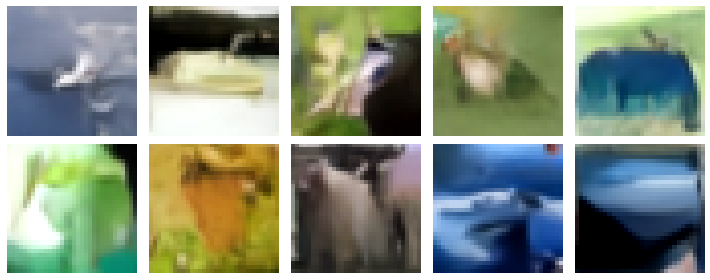

Epoch 425/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0537 - i_loss: 0.2059 - val_n_loss: 0.0529 - val_i_loss: 0.1518 - val_kid: 0.1674


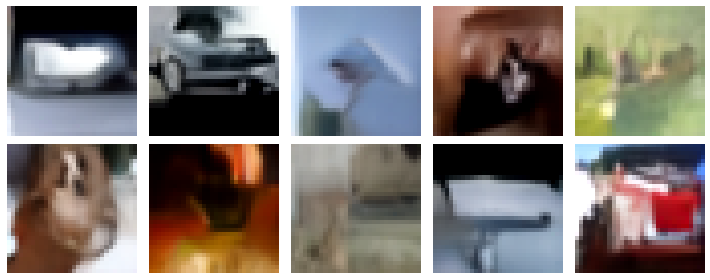

Epoch 426/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0539 - i_loss: 0.2095 - val_n_loss: 0.0528 - val_i_loss: 0.1577 - val_kid: 0.1747


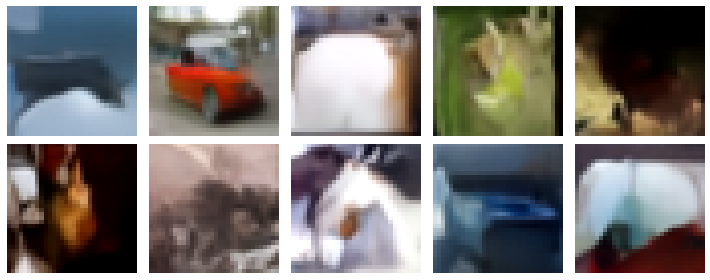

Epoch 427/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0540 - i_loss: 0.2123 - val_n_loss: 0.0514 - val_i_loss: 0.1531 - val_kid: 0.1860


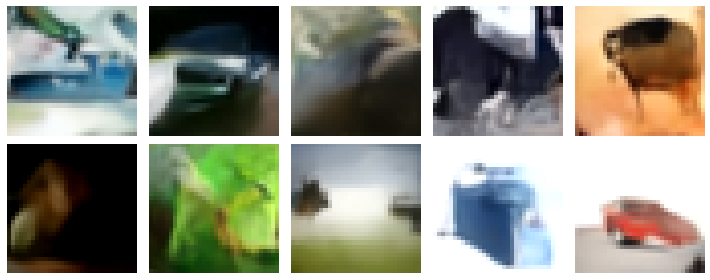

Epoch 428/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0537 - i_loss: 0.2135 - val_n_loss: 0.0516 - val_i_loss: 0.1574 - val_kid: 0.1719


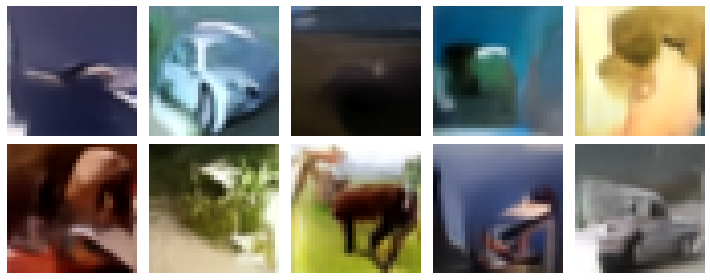

Epoch 429/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0540 - i_loss: 0.2148 - val_n_loss: 0.0524 - val_i_loss: 0.1549 - val_kid: 0.1825


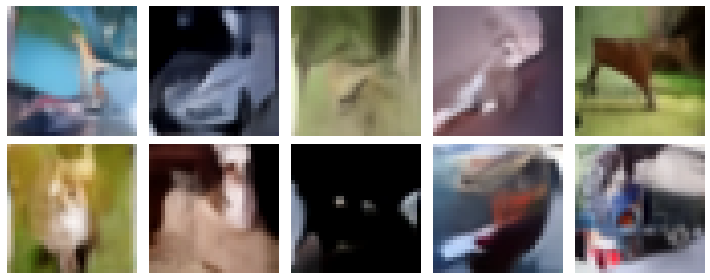

Epoch 430/500
703/703 [==============================] - 47s 68ms/step - n_loss: 0.0538 - i_loss: 0.2071 - val_n_loss: 0.0528 - val_i_loss: 0.1549 - val_kid: 0.1605


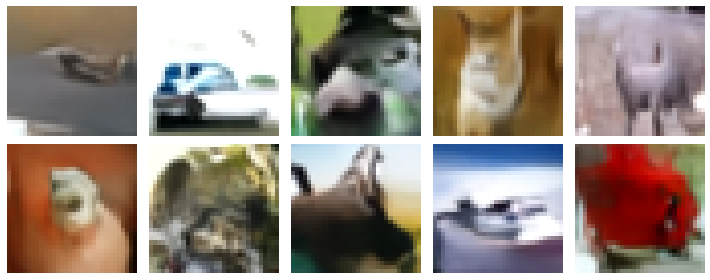

Epoch 431/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0537 - i_loss: 0.2064 - val_n_loss: 0.0524 - val_i_loss: 0.1512 - val_kid: 0.1623


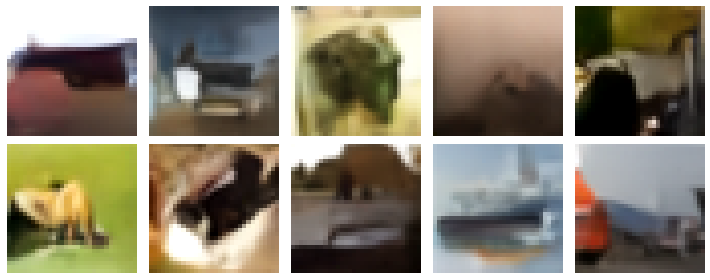

Epoch 432/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0540 - i_loss: 0.2095 - val_n_loss: 0.0521 - val_i_loss: 0.1596 - val_kid: 0.1731


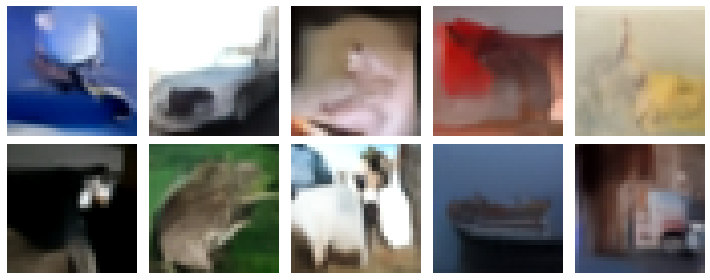

Epoch 433/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0541 - i_loss: 0.2072 - val_n_loss: 0.0518 - val_i_loss: 0.1583 - val_kid: 0.1738


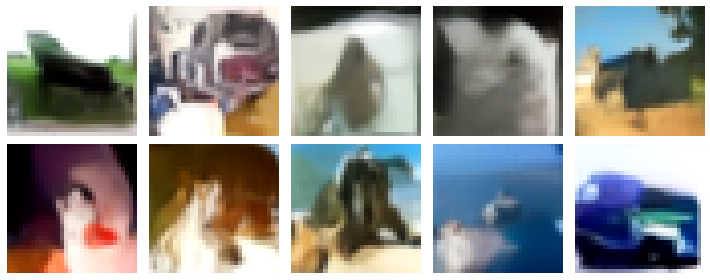

Epoch 434/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0539 - i_loss: 0.2042 - val_n_loss: 0.0522 - val_i_loss: 0.1521 - val_kid: 0.1831


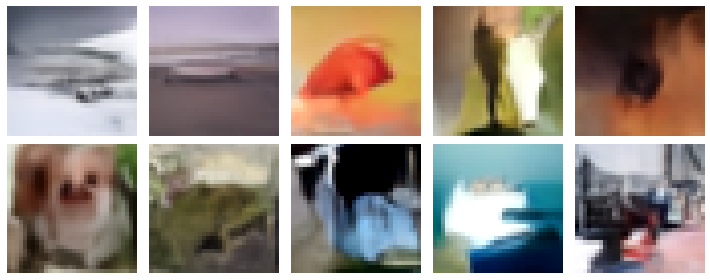

Epoch 435/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0537 - i_loss: 0.2102 - val_n_loss: 0.0517 - val_i_loss: 0.1542 - val_kid: 0.1692


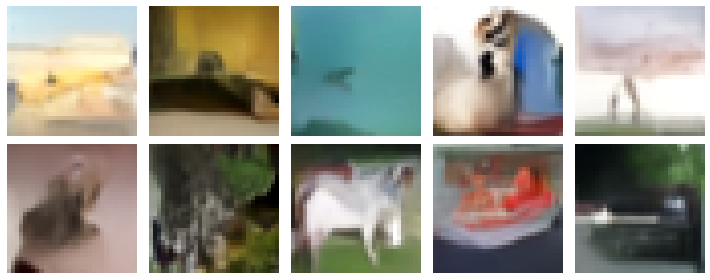

Epoch 436/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0536 - i_loss: 0.2129 - val_n_loss: 0.0530 - val_i_loss: 0.1485 - val_kid: 0.1768


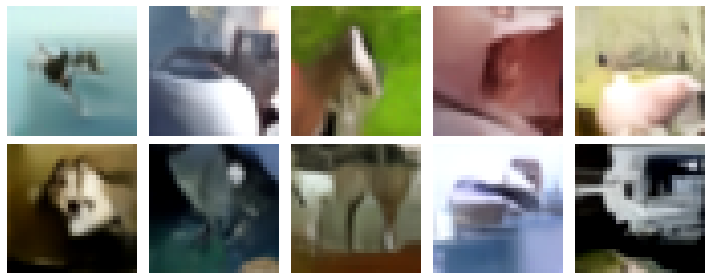

Epoch 437/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0540 - i_loss: 0.2070 - val_n_loss: 0.0520 - val_i_loss: 0.1527 - val_kid: 0.1848


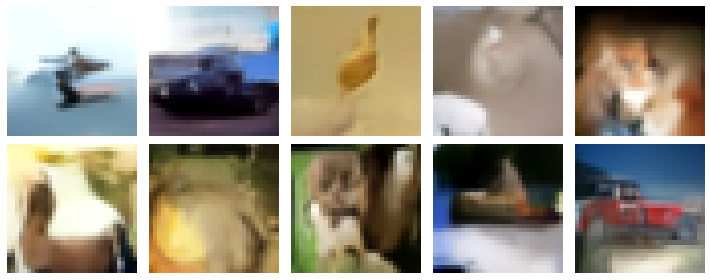

Epoch 438/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0537 - i_loss: 0.2069 - val_n_loss: 0.0511 - val_i_loss: 0.1580 - val_kid: 0.1674


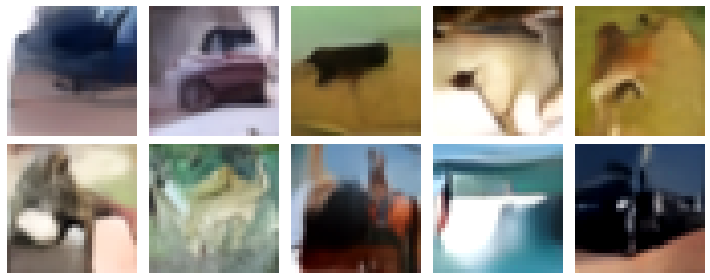

Epoch 439/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0541 - i_loss: 0.2071 - val_n_loss: 0.0519 - val_i_loss: 0.1542 - val_kid: 0.1742


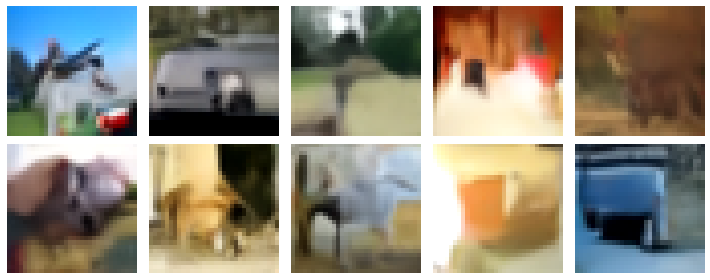

Epoch 440/500
703/703 [==============================] - 47s 68ms/step - n_loss: 0.0540 - i_loss: 0.2120 - val_n_loss: 0.0513 - val_i_loss: 0.1585 - val_kid: 0.1630


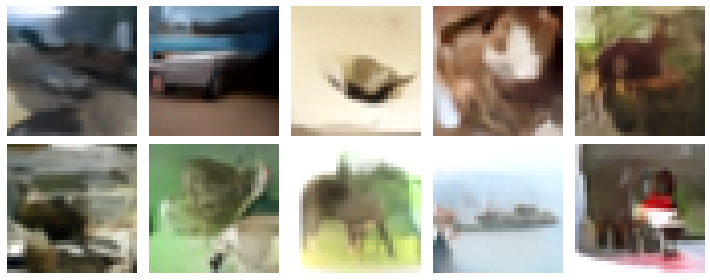

Epoch 441/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0537 - i_loss: 0.2106 - val_n_loss: 0.0524 - val_i_loss: 0.1492 - val_kid: 0.1709


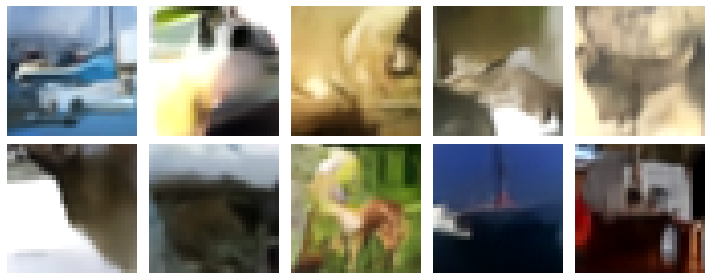

Epoch 442/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0537 - i_loss: 0.2140 - val_n_loss: 0.0506 - val_i_loss: 0.1616 - val_kid: 0.1666


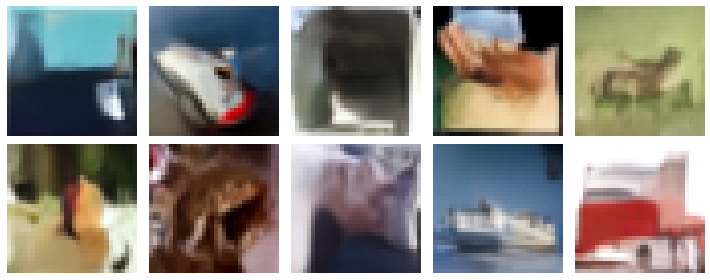

Epoch 443/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0541 - i_loss: 0.2068 - val_n_loss: 0.0511 - val_i_loss: 0.1567 - val_kid: 0.1674


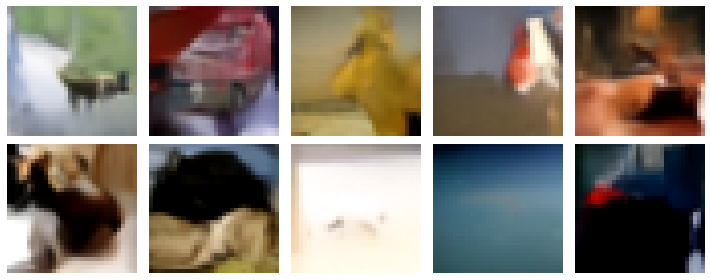

Epoch 444/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0538 - i_loss: 0.2082 - val_n_loss: 0.0510 - val_i_loss: 0.1582 - val_kid: 0.1621


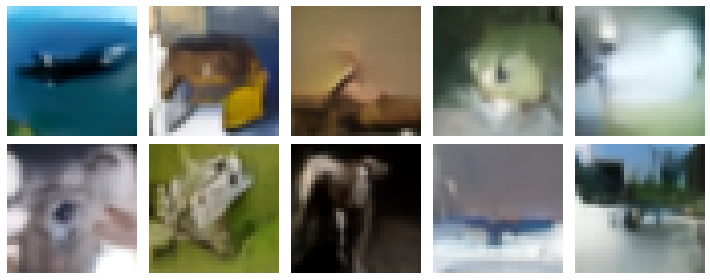

Epoch 445/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0537 - i_loss: 0.2055 - val_n_loss: 0.0518 - val_i_loss: 0.1546 - val_kid: 0.1664


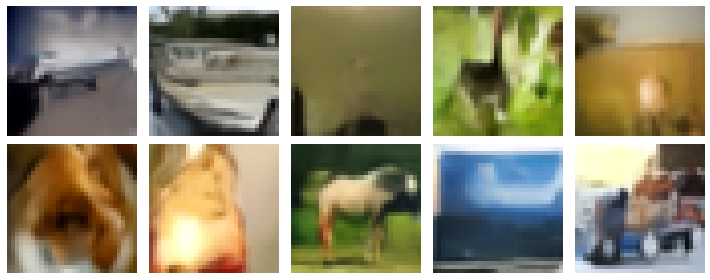

Epoch 446/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0543 - i_loss: 0.2041 - val_n_loss: 0.0516 - val_i_loss: 0.1570 - val_kid: 0.1641


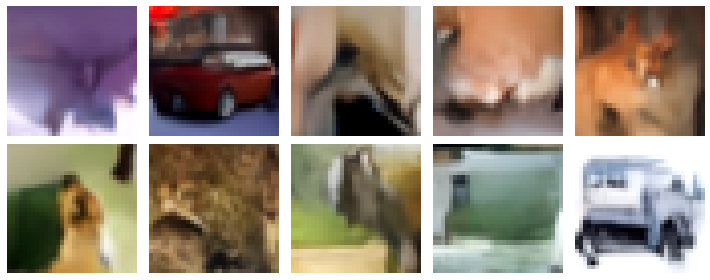

Epoch 447/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0538 - i_loss: 0.2065 - val_n_loss: 0.0511 - val_i_loss: 0.1564 - val_kid: 0.1744


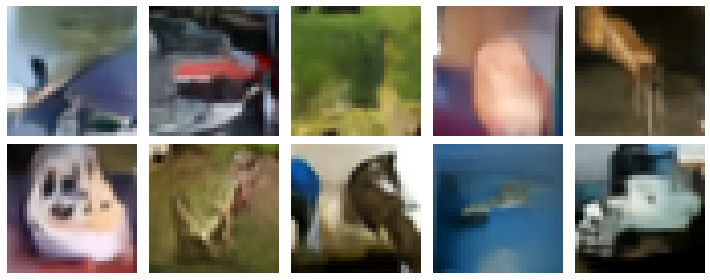

Epoch 448/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0539 - i_loss: 0.2049 - val_n_loss: 0.0519 - val_i_loss: 0.1564 - val_kid: 0.1707


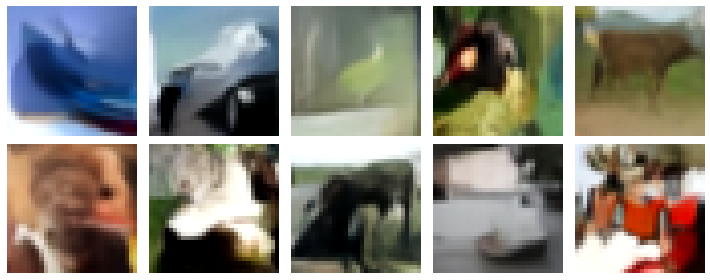

Epoch 449/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0540 - i_loss: 0.2081 - val_n_loss: 0.0522 - val_i_loss: 0.1537 - val_kid: 0.1748


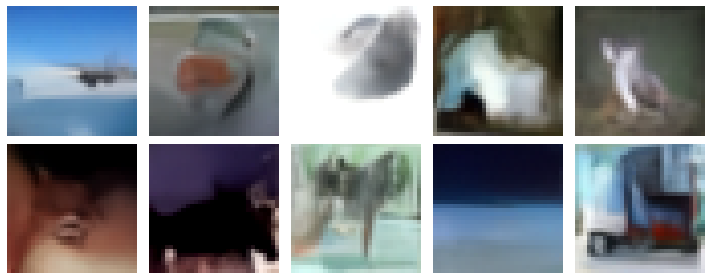

Epoch 450/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0539 - i_loss: 0.2050 - val_n_loss: 0.0514 - val_i_loss: 0.1606 - val_kid: 0.1668


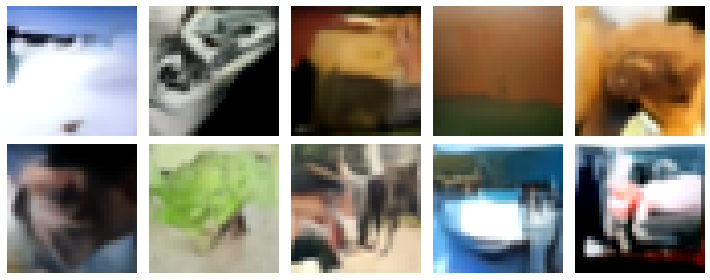

Epoch 451/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0536 - i_loss: 0.2105 - val_n_loss: 0.0526 - val_i_loss: 0.1532 - val_kid: 0.1626


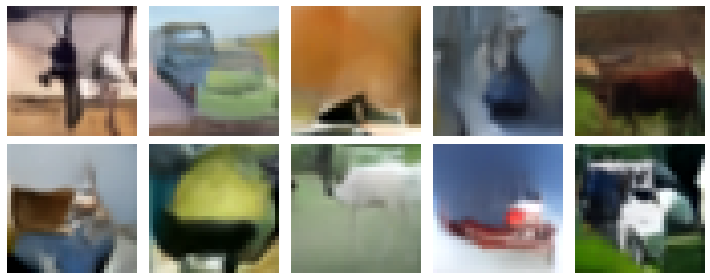

Epoch 452/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0538 - i_loss: 0.2099 - val_n_loss: 0.0521 - val_i_loss: 0.1569 - val_kid: 0.1702


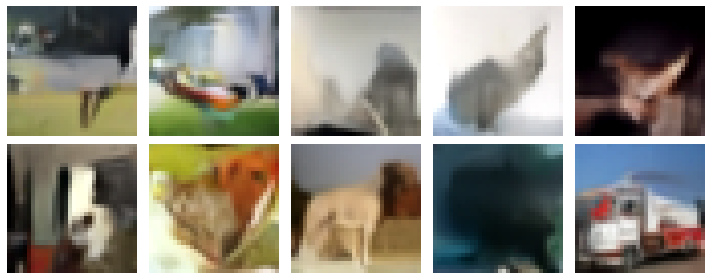

Epoch 453/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0534 - i_loss: 0.2110 - val_n_loss: 0.0519 - val_i_loss: 0.1526 - val_kid: 0.1738


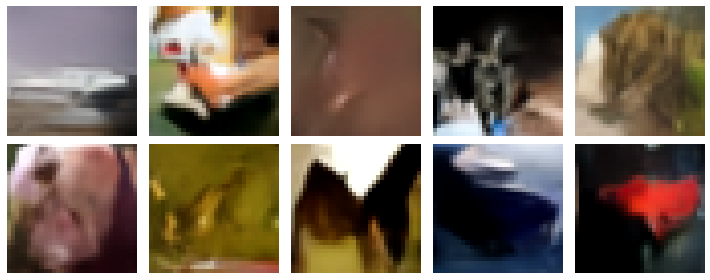

Epoch 454/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0535 - i_loss: 0.2097 - val_n_loss: 0.0518 - val_i_loss: 0.1578 - val_kid: 0.1656


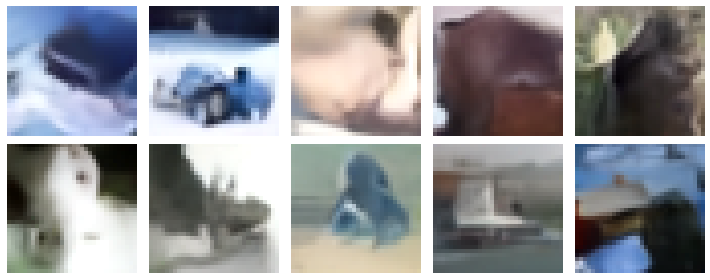

Epoch 455/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0539 - i_loss: 0.2038 - val_n_loss: 0.0518 - val_i_loss: 0.1544 - val_kid: 0.1791


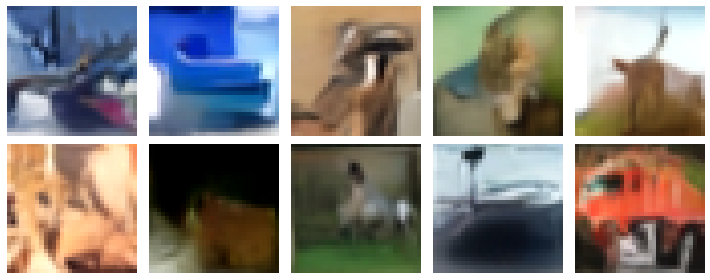

Epoch 456/500
703/703 [==============================] - 47s 68ms/step - n_loss: 0.0538 - i_loss: 0.2098 - val_n_loss: 0.0515 - val_i_loss: 0.1577 - val_kid: 0.1601


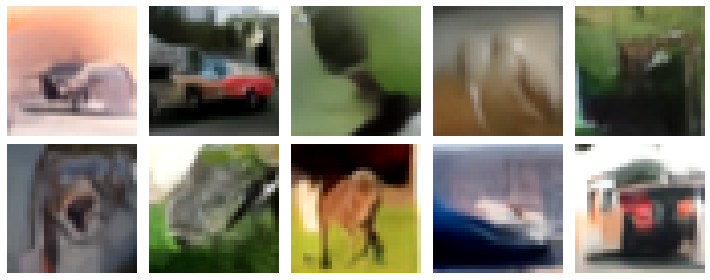

Epoch 457/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0542 - i_loss: 0.2112 - val_n_loss: 0.0511 - val_i_loss: 0.1613 - val_kid: 0.1694


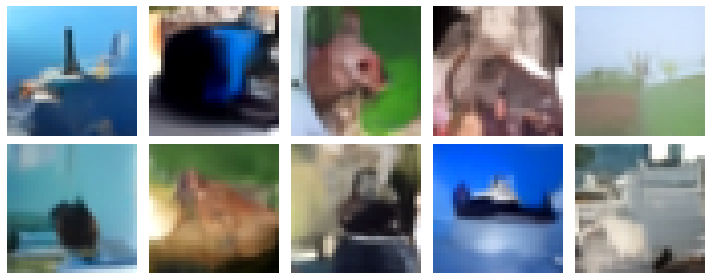

Epoch 458/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0536 - i_loss: 0.2090 - val_n_loss: 0.0522 - val_i_loss: 0.1545 - val_kid: 0.1667


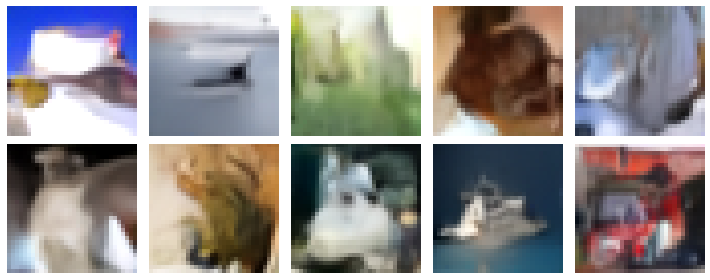

Epoch 459/500
703/703 [==============================] - 47s 68ms/step - n_loss: 0.0539 - i_loss: 0.2058 - val_n_loss: 0.0514 - val_i_loss: 0.1580 - val_kid: 0.1732


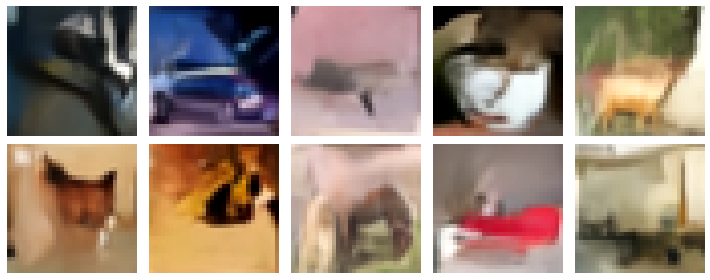

Epoch 460/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0539 - i_loss: 0.2080 - val_n_loss: 0.0514 - val_i_loss: 0.1571 - val_kid: 0.1664


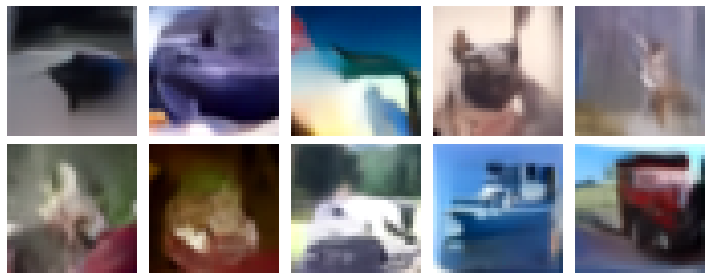

Epoch 461/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0538 - i_loss: 0.2074 - val_n_loss: 0.0517 - val_i_loss: 0.1541 - val_kid: 0.1710


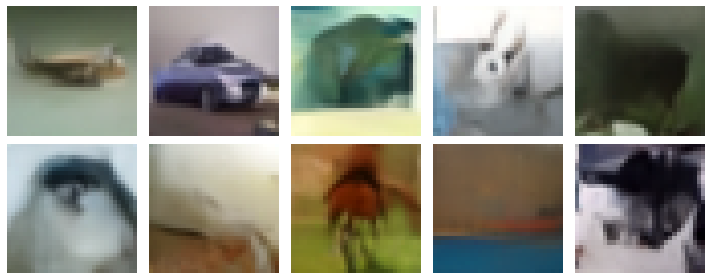

Epoch 462/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0539 - i_loss: 0.2090 - val_n_loss: 0.0528 - val_i_loss: 0.1516 - val_kid: 0.1703


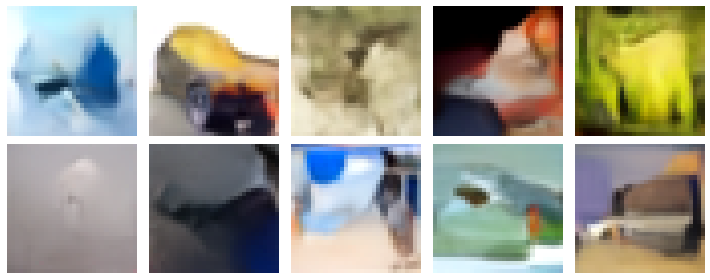

Epoch 463/500
703/703 [==============================] - 47s 68ms/step - n_loss: 0.0540 - i_loss: 0.2084 - val_n_loss: 0.0517 - val_i_loss: 0.1544 - val_kid: 0.1691


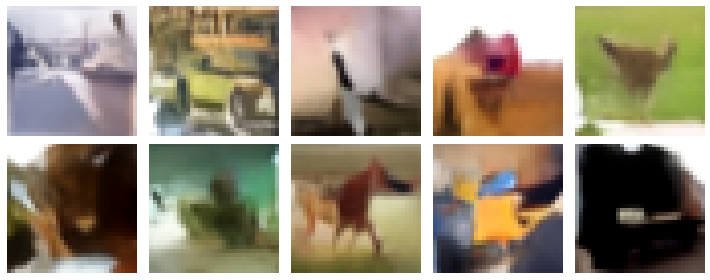

Epoch 464/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0540 - i_loss: 0.2056 - val_n_loss: 0.0518 - val_i_loss: 0.1566 - val_kid: 0.1711


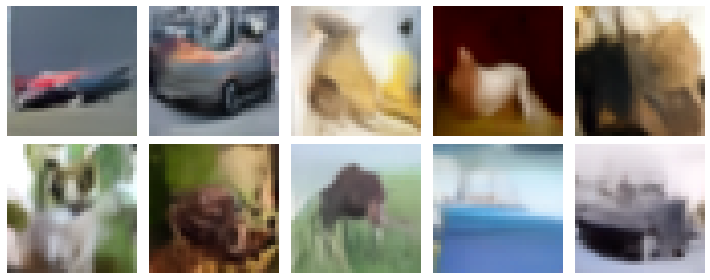

Epoch 465/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0540 - i_loss: 0.2061 - val_n_loss: 0.0515 - val_i_loss: 0.1545 - val_kid: 0.1621


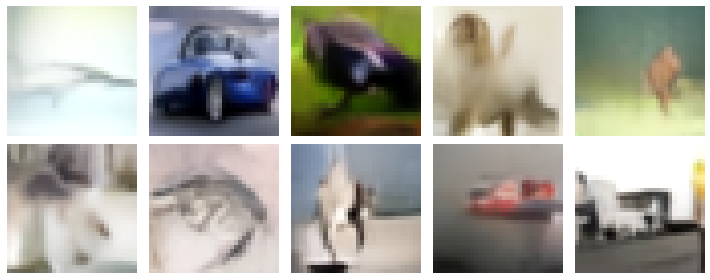

Epoch 466/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0536 - i_loss: 0.2072 - val_n_loss: 0.0515 - val_i_loss: 0.1586 - val_kid: 0.1739


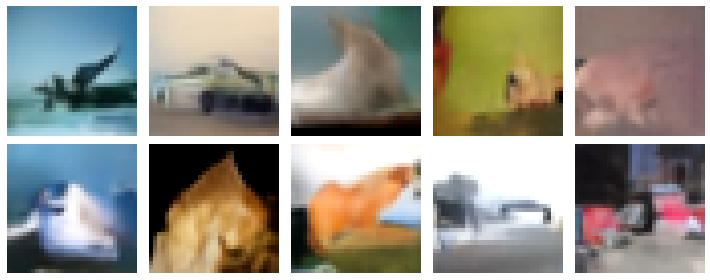

Epoch 467/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0540 - i_loss: 0.2101 - val_n_loss: 0.0520 - val_i_loss: 0.1549 - val_kid: 0.1671


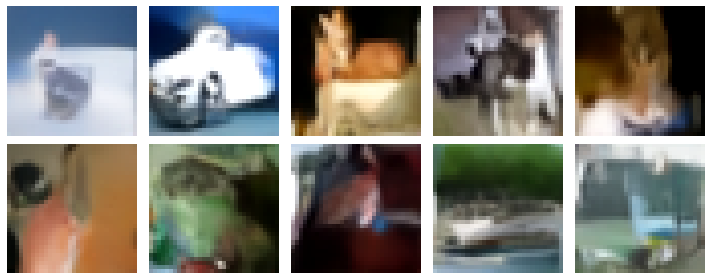

Epoch 468/500
703/703 [==============================] - 47s 68ms/step - n_loss: 0.0539 - i_loss: 0.2063 - val_n_loss: 0.0519 - val_i_loss: 0.1539 - val_kid: 0.1589


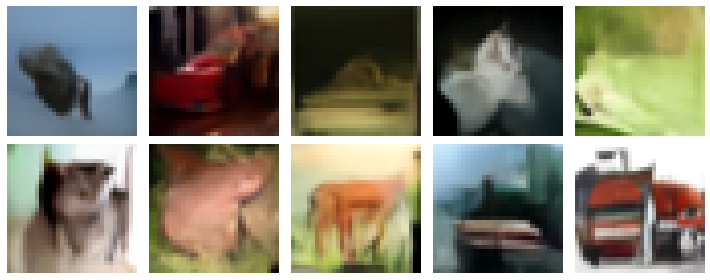

Epoch 469/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0532 - i_loss: 0.2080 - val_n_loss: 0.0529 - val_i_loss: 0.1512 - val_kid: 0.1639


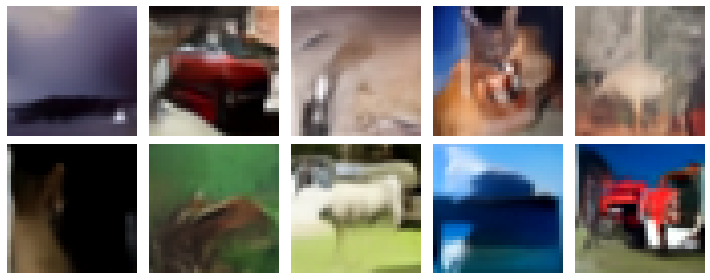

Epoch 470/500
703/703 [==============================] - 47s 68ms/step - n_loss: 0.0538 - i_loss: 0.2087 - val_n_loss: 0.0517 - val_i_loss: 0.1599 - val_kid: 0.1502


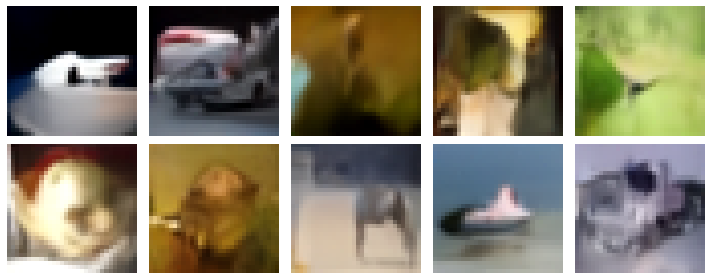

Epoch 471/500
703/703 [==============================] - 48s 68ms/step - n_loss: 0.0539 - i_loss: 0.2077 - val_n_loss: 0.0521 - val_i_loss: 0.1501 - val_kid: 0.1618


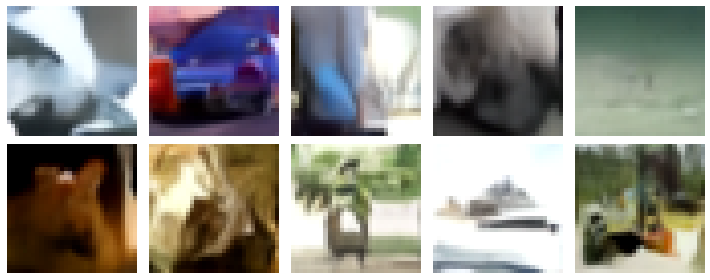

Epoch 472/500
703/703 [==============================] - 48s 68ms/step - n_loss: 0.0540 - i_loss: 0.2060 - val_n_loss: 0.0519 - val_i_loss: 0.1570 - val_kid: 0.1612


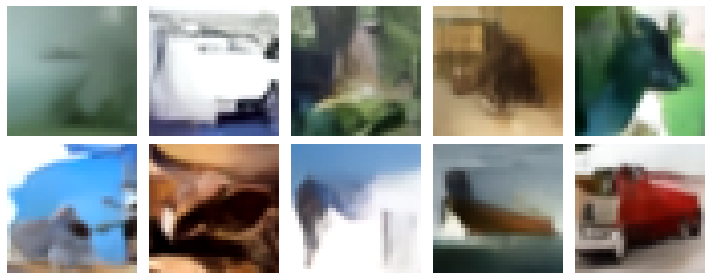

Epoch 473/500
703/703 [==============================] - 48s 68ms/step - n_loss: 0.0540 - i_loss: 0.2067 - val_n_loss: 0.0509 - val_i_loss: 0.1592 - val_kid: 0.1676


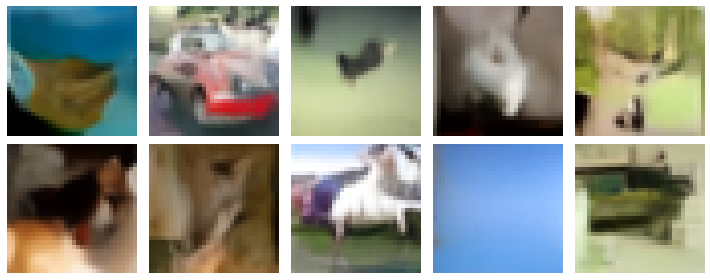

Epoch 474/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0536 - i_loss: 0.2050 - val_n_loss: 0.0519 - val_i_loss: 0.1549 - val_kid: 0.1620


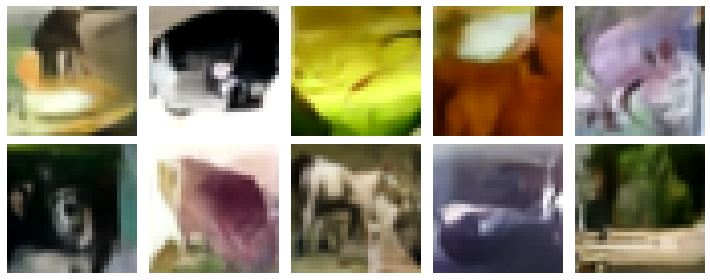

Epoch 475/500
703/703 [==============================] - 47s 67ms/step - n_loss: 0.0542 - i_loss: 0.2031 - val_n_loss: 0.0511 - val_i_loss: 0.1577 - val_kid: 0.1545


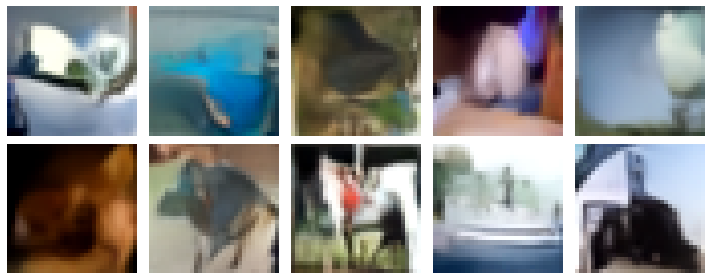

Epoch 476/500
703/703 [==============================] - 47s 68ms/step - n_loss: 0.0535 - i_loss: 0.2088 - val_n_loss: 0.0523 - val_i_loss: 0.1531 - val_kid: 0.1542


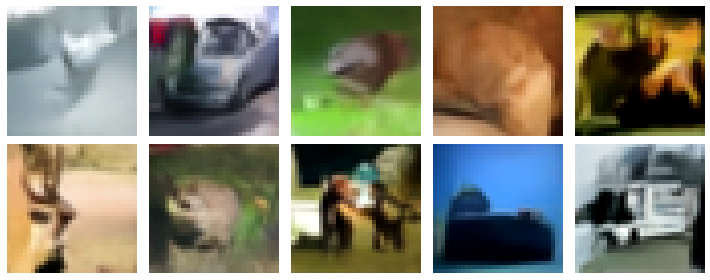

Epoch 477/500
703/703 [==============================] - 48s 68ms/step - n_loss: 0.0538 - i_loss: 0.2107 - val_n_loss: 0.0524 - val_i_loss: 0.1556 - val_kid: 0.1609


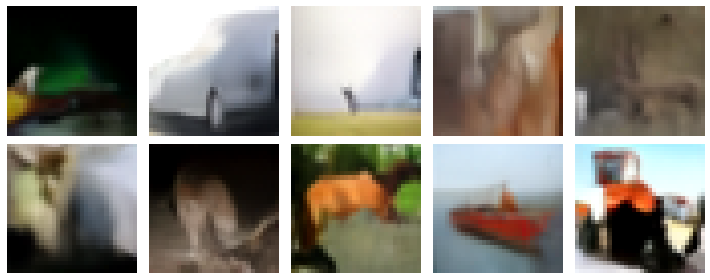

Epoch 478/500
703/703 [==============================] - 48s 69ms/step - n_loss: 0.0538 - i_loss: 0.2086 - val_n_loss: 0.0509 - val_i_loss: 0.1619 - val_kid: 0.1643


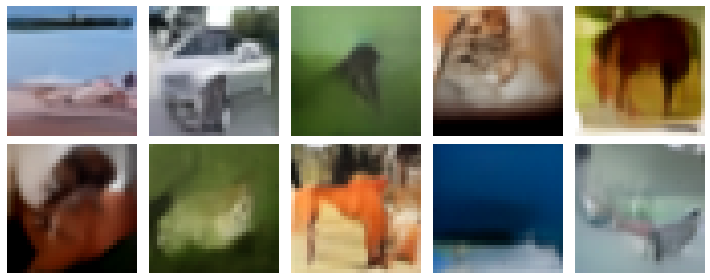

Epoch 479/500
703/703 [==============================] - 48s 68ms/step - n_loss: 0.0535 - i_loss: 0.2081 - val_n_loss: 0.0521 - val_i_loss: 0.1576 - val_kid: 0.1640


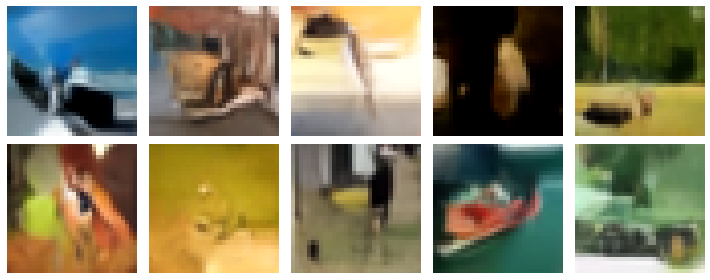

Epoch 480/500
703/703 [==============================] - 48s 68ms/step - n_loss: 0.0537 - i_loss: 0.2054 - val_n_loss: 0.0513 - val_i_loss: 0.1524 - val_kid: 0.1636


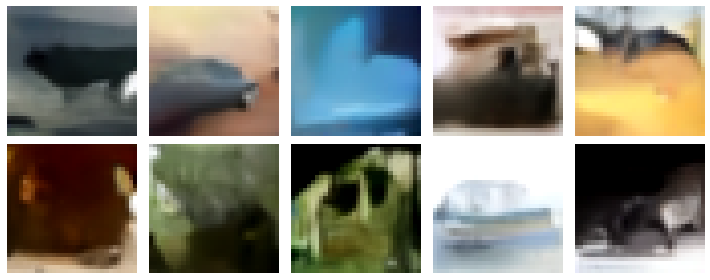

Epoch 481/500
703/703 [==============================] - 48s 68ms/step - n_loss: 0.0541 - i_loss: 0.2032 - val_n_loss: 0.0522 - val_i_loss: 0.1551 - val_kid: 0.1657


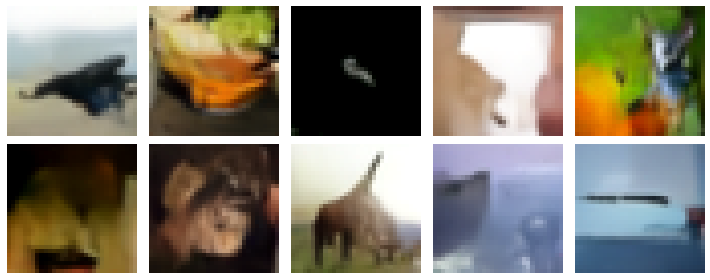

Epoch 482/500
703/703 [==============================] - 48s 68ms/step - n_loss: 0.0539 - i_loss: 0.2110 - val_n_loss: 0.0521 - val_i_loss: 0.1574 - val_kid: 0.1671


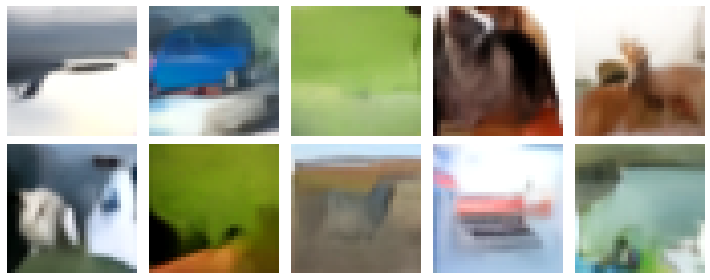

Epoch 483/500
703/703 [==============================] - 48s 68ms/step - n_loss: 0.0537 - i_loss: 0.2054 - val_n_loss: 0.0527 - val_i_loss: 0.1507 - val_kid: 0.1679


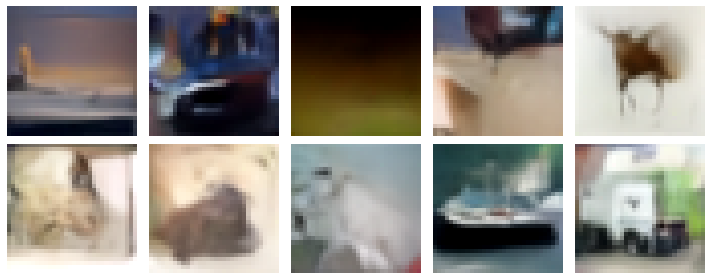

Epoch 484/500
703/703 [==============================] - 48s 68ms/step - n_loss: 0.0540 - i_loss: 0.2084 - val_n_loss: 0.0518 - val_i_loss: 0.1580 - val_kid: 0.1658


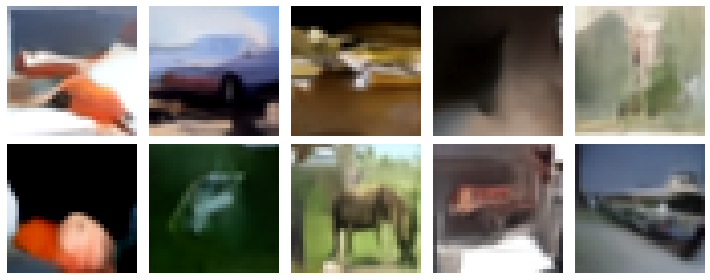

Epoch 485/500
703/703 [==============================] - 48s 68ms/step - n_loss: 0.0538 - i_loss: 0.2061 - val_n_loss: 0.0518 - val_i_loss: 0.1557 - val_kid: 0.1685


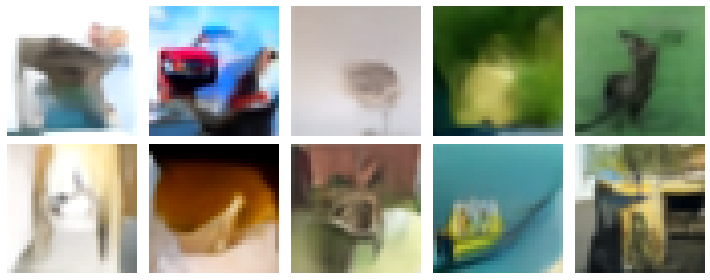

Epoch 486/500
703/703 [==============================] - 48s 68ms/step - n_loss: 0.0539 - i_loss: 0.2121 - val_n_loss: 0.0514 - val_i_loss: 0.1562 - val_kid: 0.1610


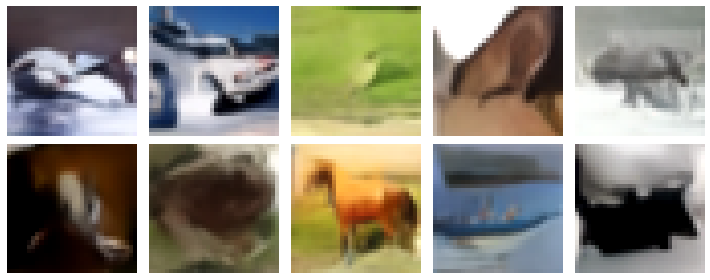

Epoch 487/500
703/703 [==============================] - 48s 68ms/step - n_loss: 0.0539 - i_loss: 0.2099 - val_n_loss: 0.0518 - val_i_loss: 0.1547 - val_kid: 0.1652


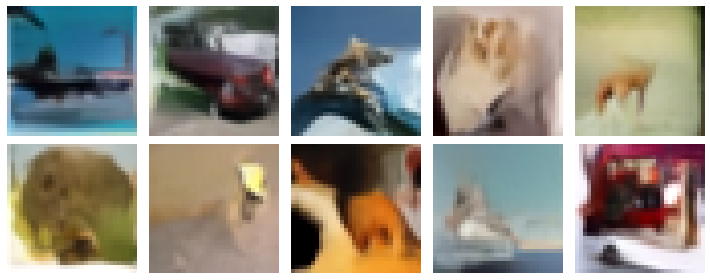

Epoch 488/500
703/703 [==============================] - 48s 68ms/step - n_loss: 0.0540 - i_loss: 0.2069 - val_n_loss: 0.0516 - val_i_loss: 0.1549 - val_kid: 0.1553


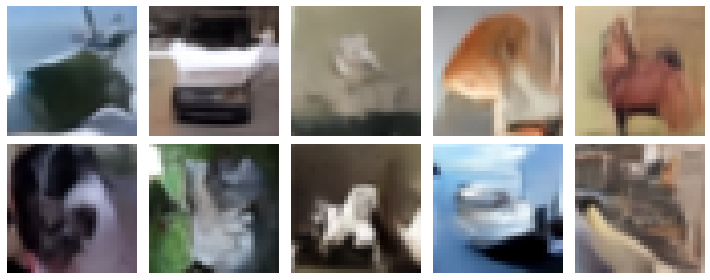

Epoch 489/500
703/703 [==============================] - 48s 68ms/step - n_loss: 0.0538 - i_loss: 0.2093 - val_n_loss: 0.0521 - val_i_loss: 0.1573 - val_kid: 0.1527


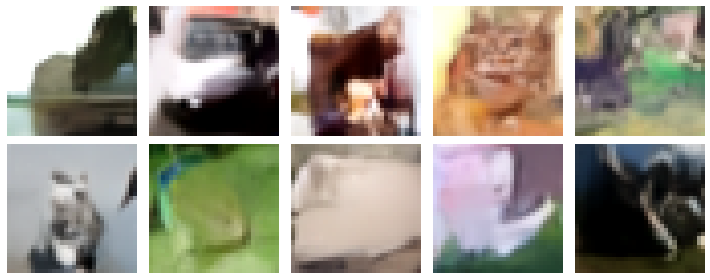

Epoch 490/500
703/703 [==============================] - 48s 68ms/step - n_loss: 0.0537 - i_loss: 0.2073 - val_n_loss: 0.0520 - val_i_loss: 0.1559 - val_kid: 0.1478


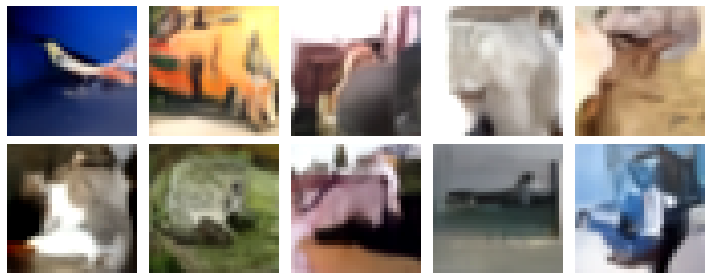

Epoch 491/500
703/703 [==============================] - 48s 68ms/step - n_loss: 0.0537 - i_loss: 0.2085 - val_n_loss: 0.0515 - val_i_loss: 0.1597 - val_kid: 0.1529


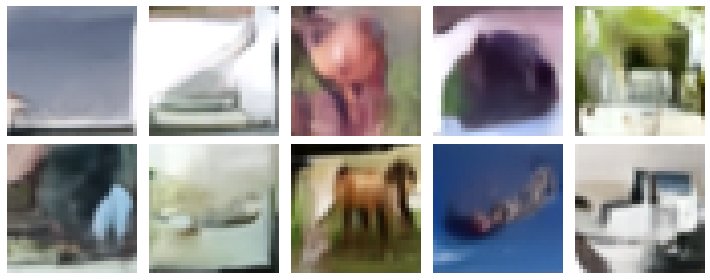

Epoch 492/500
703/703 [==============================] - 48s 68ms/step - n_loss: 0.0538 - i_loss: 0.2088 - val_n_loss: 0.0523 - val_i_loss: 0.1541 - val_kid: 0.1477


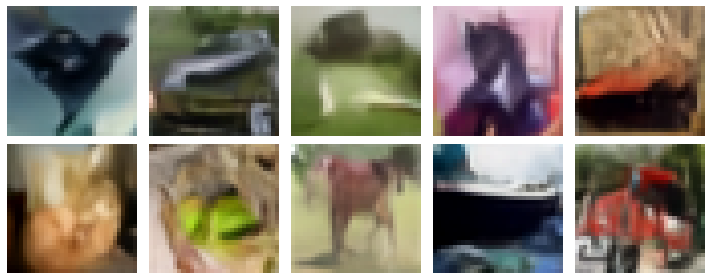

Epoch 493/500
703/703 [==============================] - 48s 68ms/step - n_loss: 0.0538 - i_loss: 0.2121 - val_n_loss: 0.0520 - val_i_loss: 0.1562 - val_kid: 0.1504


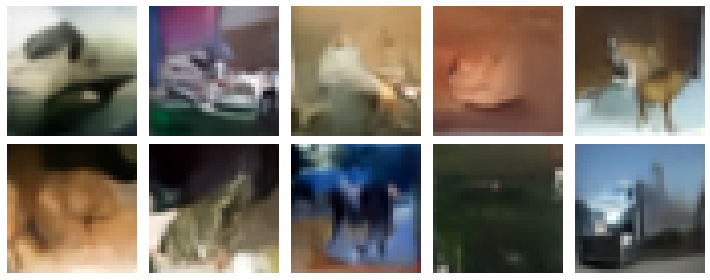

Epoch 494/500
703/703 [==============================] - 48s 68ms/step - n_loss: 0.0539 - i_loss: 0.2071 - val_n_loss: 0.0520 - val_i_loss: 0.1552 - val_kid: 0.1589


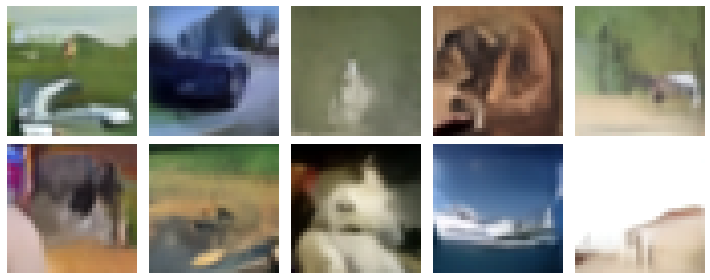

Epoch 495/500
703/703 [==============================] - 47s 68ms/step - n_loss: 0.0538 - i_loss: 0.2078 - val_n_loss: 0.0527 - val_i_loss: 0.1534 - val_kid: 0.1654


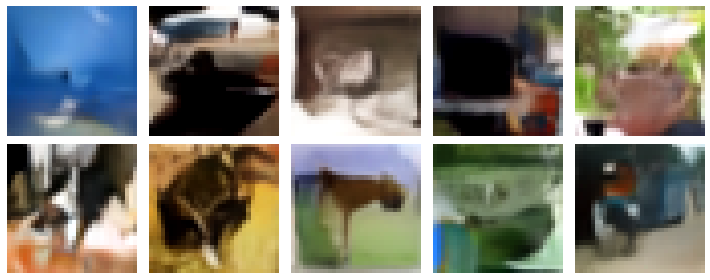

Epoch 496/500
703/703 [==============================] - 48s 68ms/step - n_loss: 0.0537 - i_loss: 0.2105 - val_n_loss: 0.0519 - val_i_loss: 0.1539 - val_kid: 0.1563


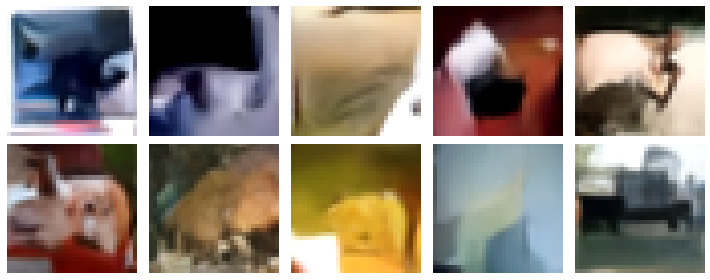

Epoch 497/500
703/703 [==============================] - 47s 68ms/step - n_loss: 0.0539 - i_loss: 0.2068 - val_n_loss: 0.0528 - val_i_loss: 0.1517 - val_kid: 0.1564


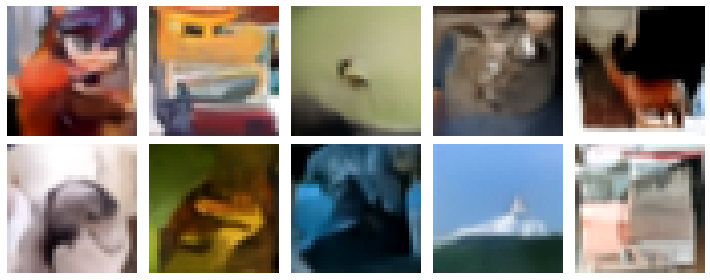

Epoch 498/500
703/703 [==============================] - 48s 68ms/step - n_loss: 0.0539 - i_loss: 0.2127 - val_n_loss: 0.0518 - val_i_loss: 0.1570 - val_kid: 0.1656


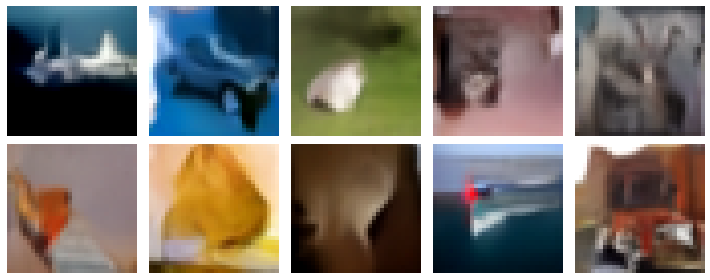

Epoch 499/500
703/703 [==============================] - 47s 68ms/step - n_loss: 0.0537 - i_loss: 0.2072 - val_n_loss: 0.0514 - val_i_loss: 0.1514 - val_kid: 0.1528


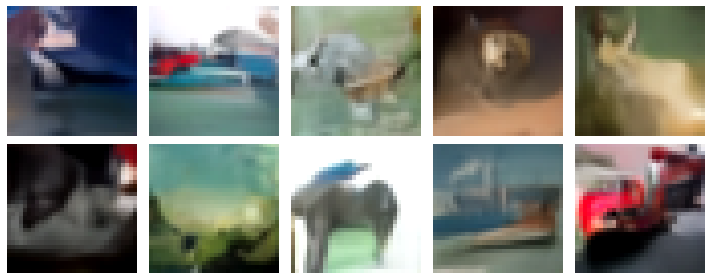

Epoch 500/500
703/703 [==============================] - 48s 68ms/step - n_loss: 0.0538 - i_loss: 0.2082 - val_n_loss: 0.0515 - val_i_loss: 0.1611 - val_kid: 0.1497


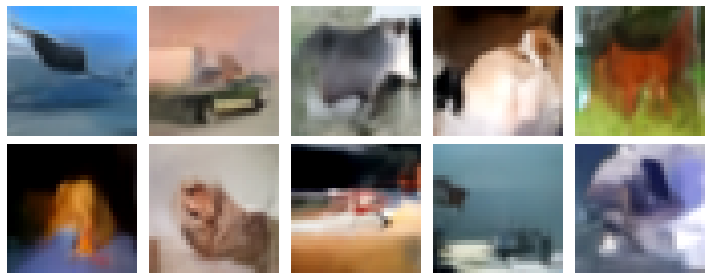

In [21]:
# run training and plot generated images periodically
model.fit(
    train_dataset,
    epochs=num_epochs,
    validation_data=val_dataset,
    callbacks=[
        keras.callbacks.LambdaCallback(on_epoch_end = model.plot_images),
        checkpoint_callback,
    ],
)

## 0.airplane / 1.automobile / 2.bird / 3.cat / 4.deer / 5.dog / 6.frog / 7.horse / 8.ship / 9.truck

## 인퍼런스

### 전체 Class 출력

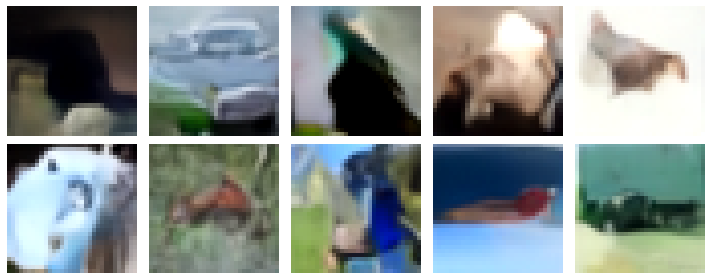

In [22]:
# load the best model and generate images
model.load_weights(checkpoint_path)
model.plot_images()

### 입력 클래스 출력

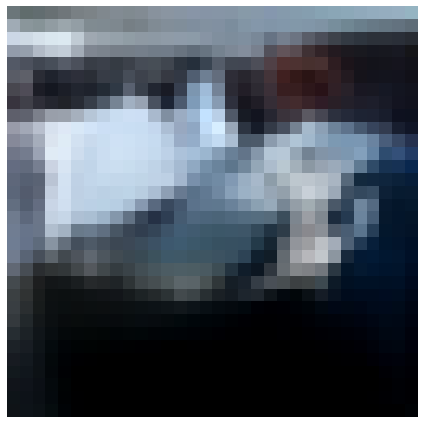

In [23]:
# 출력하고 싶은 class 번호 입력
input_value = 8
model.plot_one_images(input_class = input_value)